# **Product Recognition of Food Products**

## Image Processing and Computer Vision - Assignment Module \#1


Contacts:

- Prof. Giuseppe Lisanti -> giuseppe.lisanti@unibo.it
- Prof. Samuele Salti -> samuele.salti@unibo.it
- Alex Costanzino -> alex.costanzino@unibo.it
- Francesco Ballerini -> francesco.ballerini4@unibo.it


Computer vision-based object detection techniques can be applied in super market settings to build a system that can identify products on store shelves.
An example of how this system could be used would be to assist visually impaired customers or automate common store management tasks like detecting low-stock or misplaced products, given an image of a shelf in a store.

## Task
Develop a computer vision system that, given a reference image for each product, is able to identify such product from one picture of a store shelf.

<figure>
<a href="https://imgbb.com/">
  <center>
  <img src="https://i.ibb.co/TwkMWnH/Screenshot-2024-04-04-at-14-54-51.png" alt="Screenshot-2024-04-04-at-14-54-51" border="0" width="300" />
</a>
</figure>

For each type of product displayed in the
shelf the system should report:
1. Number of instances;
1. Dimension of each instance (width and height in pixel of the bounding box that enclose them);
1. Position in the image reference system of each instance (center of the bounding box that enclose them).

#### Example of expected output
```
Product 0 - 2 instance found:
  Instance 1 {position: (256, 328), width: 57px, height: 80px}
  Instance 2 {position: (311, 328), width: 57px, height: 80px}
Product 1 – 1 instance found:
.
.
.
```

### Track A - Single Instance Detection
Develop an object detection system to identify single instance of products given one reference image for each item and a scene image.

The system should be able to correctly identify all the product in the shelves
image.

### Track B - Multiple Instances Detection
In addition to what achieved at step A, the system should also be able to detect multiple instances of the same product.

## Data
Two folders of images are provided:
* **Models**: contains one reference image for each product that the system should be able to identify.
* **Scenes**: contains different shelve pictures to test the developed algorithm in different scenarios. The images contained in this folder are corrupted by noise.

#### Track A - Single Instance Detection
* **Models**: {ref1.png to ref14.png}.
* **Scenes**: {scene1.png to scene5.png}.

#### Track B - Multiple Instances Detection
* **Models**: {ref15.png to ref27.png}.
* **Scenes**: {scene6.png to scene12.png}.

In [2]:
from google.colab import drive
import os
drive.mount('/content/drive')

!cp -r /content/drive/MyDrive/AssignmentsIPCV/dataset.zip ./
!unzip dataset.zip

Mounted at /content/drive
Archive:  dataset.zip
   creating: dataset/
  inflating: __MACOSX/._dataset      
   creating: dataset/scenes/
  inflating: __MACOSX/dataset/._scenes  
  inflating: dataset/.DS_Store       
  inflating: __MACOSX/dataset/._.DS_Store  
   creating: dataset/models/
  inflating: __MACOSX/dataset/._models  
  inflating: dataset/scenes/scene12.png  
  inflating: __MACOSX/dataset/scenes/._scene12.png  
  inflating: dataset/scenes/scene10.png  
  inflating: __MACOSX/dataset/scenes/._scene10.png  
  inflating: dataset/scenes/scene11.png  
  inflating: __MACOSX/dataset/scenes/._scene11.png  
  inflating: dataset/scenes/scene5.png  
  inflating: __MACOSX/dataset/scenes/._scene5.png  
  inflating: dataset/scenes/scene4.png  
  inflating: __MACOSX/dataset/scenes/._scene4.png  
  inflating: dataset/scenes/scene6.png  
  inflating: __MACOSX/dataset/scenes/._scene6.png  
  inflating: dataset/scenes/scene7.png  
  inflating: __MACOSX/dataset/scenes/._scene7.png  
  inflating: 

## Evaluation criteria
1. **Procedural correctness**. There are several ways to solve the assignment. Design your own sound approach and justify every decision you make;

2. **Clarity and conciseness**. Present your work in a readable way: format your code and comment every important step;

3. **Correctness of results**. Try to solve as many instances as possible. You should be able to solve all the instances of the assignment, however, a thoroughly justified and sound procedure with a lower number of solved instances will be valued **more** than a poorly designed approach.

## Filtering

The scene images contain some noise. We therfore start by denoising the scene iamges before further processing.

As the first two scene images are less noisy than the rest, we have decided to filter more for the three last images than for the two first.



In [3]:
import cv2
import numpy as np
imgs_train = ['dataset/scenes/scene{}.png'.format(i) for i in range(1, 6)]
for i in range (len(imgs_train)):
  img = cv2.imread(imgs_train[i])
  img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

  if i < 2:
    img_rgb = cv2.bilateralFilter(img_rgb, 15, 200, 100)

  else:
    # Apply Median Blur to remove salt-and-pepper noise
    median_blur = cv2.medianBlur(img_rgb, 5)

    # Apply Gaussian Blur to smooth the image
    gaussian_blur = cv2.GaussianBlur(median_blur, (5, 5), 0)

    # Apply Bilateral Filter to preserve edges while reducing noise
    img_rgb = cv2.bilateralFilter(gaussian_blur, 9, 75, 75)

    #Edge detection
    kernel = np.array([[-1,-1,-1], [-1,9,-1], [-1,-1,-1]])
    img_rgb = cv2.filter2D(img_rgb, -1, kernel)
    #Sharpening
    kernel = np.array([[0,-1,0], [-1,5,-1], [0,-1,0]])
    img_rgb = cv2.filter2D(img_rgb, -1, kernel)

  name = imgs_train[i].replace(".png", "_filtered.png")
  cv2.imwrite(name, cv2.cvtColor(img_rgb, cv2.COLOR_RGB2BGR))
  print(f"save succeded as: {name}")

save succeded as: dataset/scenes/scene1_filtered.png
save succeded as: dataset/scenes/scene2_filtered.png
save succeded as: dataset/scenes/scene3_filtered.png
save succeded as: dataset/scenes/scene4_filtered.png
save succeded as: dataset/scenes/scene5_filtered.png


# Object detection with local Invariant features

We will implement object detection with local invariant features utilizing the Python framework cv2.

This wil be done in four steps:
1. Detection by finding keypoints in model an scene images.
2. Description: create description for each point.
3. Matching: match point in scene and query image based on descriptor
4. Position estimation: estimate poition of query image in scene image.

We therfore create a function *object retrive mult* and *object retrive*, which finds keypoints (step 1), descirbes them (step 2) and matches them (step 3).

We have decided to utilize SIFT as this .... This is also the reason for choosing 0.7 as treshold when filtering out bad matches, as this was outlined in the paper introducing SIFT.

Furthermore we have utilized a FLANN based matcherk, which means fast nearest neighbor search.

The difference between the two funcitons is that *object retrive* is used for matching with a single instance of query image, while *object_retrieve_mult* is used when there are multiple instances of the query image. In this funciton the keypoints in the scene image are clusterd, and in this way assuming that keypoints close in distance belong to the same object. Step 2 and step 3 is then run for each cluster.

In [4]:
import numpy as np
import cv2
from matplotlib import pyplot as plt
from sklearn.cluster import MeanShift, estimate_bandwidth

# Define a function for object detection pipeline
def object_retrieve_mult(img_query, img_train_denoized, min_match_count):

    #Keypoint detection
    sift = cv2.xfeatures2d.SIFT_create(contrastThreshold=0.04)
    kp_query =  sift.detect(img_query)
    kp_train =  sift.detect(img_train_denoized)

    #Keypoint description
    kp_query, des_query =  sift.compute(img_query, kp_query)
    kp_train, des_train = sift.compute(img_train_denoized, kp_train)

    # Visualize keypoints
    img_query_kp = cv2.drawKeypoints(img_query, kp_query, None)
    img_train_kp = cv2.drawKeypoints(img_train_denoized, kp_train, None)

    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(img_query_kp)
    plt.title("Query Image Keypoints")
    plt.subplot(1, 2, 2)
    plt.imshow(img_train_kp)
    plt.title("Train Image Keypoints")
    plt.show()

    # Create array from keypoints for clustering
    x = np.array([kp.pt for kp in kp_train])
    print("Keypoint coordinates for clustering:", x)
    bandwidth = estimate_bandwidth(x, quantile=0.1, n_samples=500)
    print("Estimated bandwidth:", bandwidth)

    ms = MeanShift(bandwidth=bandwidth, bin_seeding=True, cluster_all=True)
    ms.fit(x)
    labels = ms.labels_
    cluster_centers = ms.cluster_centers_

    labels_unique = np.unique(labels)
    n_clusters_ = len(labels_unique)
    print("number of estimated clusters : %d" % n_clusters_)

    # Visualize clusters

    """
    plt.figure(figsize=(10, 5))
    for k, col in zip(range(n_clusters_), plt.cm.jet(np.linspace(0, 1, n_clusters_))):
        my_members = labels == k
        cluster_center = cluster_centers[k]
        plt.plot(x[my_members, 0], x[my_members, 1], 'o', markerfacecolor=col,
                 markeredgecolor='k', markersize=6)
        plt.plot(cluster_center[0], cluster_center[1], 'o', markerfacecolor=col,
                 markeredgecolor='k', markersize=14)
        plt.text(cluster_center[0], cluster_center[1], str(k), fontsize=12, color='black', weight='bold')
    plt.title('Estimated number of clusters: %d' % n_clusters_)
    plt.show()
    """

    # Sort clusters by their center coordinates for consistency
    sorted_indices = np.argsort(cluster_centers[:, 0])
    sorted_labels = np.array([np.where(sorted_indices == i)[0][0] for i in labels])
    sorted_cluster_centers = cluster_centers[sorted_indices]

    # FLANN parameters
    FLANN_INDEX_KDTREE = 1
    index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
    search_params = dict(checks=50)

    # Initialize FLANN matcher
    flann = cv2.FlannBasedMatcher(index_params, search_params)
    objects = []
    for i in range(n_clusters_):
      print("cluster", i)
      cluster_indices = np.where(sorted_labels == i)[0]
      cluster_des_train = des_train[cluster_indices, :]
      matches = flann.knnMatch(des_query, cluster_des_train, k=2)
      good = []


      #filtering false matches, use 0.7 because SIFT
      for m,n in matches:
          if m.distance < 0.7*n.distance:
              good.append(m)
      # Drawing the matches
      print("length",len(good))
      if len(good)> min_match_count:
        objects.append((i,good))
    # Visualize matches
    matches = []
    for cluster_id, good_matches in objects:
        cluster_indices = np.where(sorted_labels == cluster_id)[0]
        kp_cluster = [kp_train[idx] for idx in cluster_indices]
        matches.append((kp_cluster, good_matches))

        """img_matches = cv2.drawMatchesKnn(
            img_query, kp_query, img_train_denoized, kp_cluster,
            [good_matches], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS
        )

        plt.figure(figsize=(15, 10))
        plt.imshow(img_matches)
        plt.title(f'Cluster {cluster_id} Matches')
        plt.show()"""
    return matches, kp_query, kp_train


In [5]:
import numpy as np
import cv2
from matplotlib import pyplot as plt

# Define a function for object detection pipeline
def object_retrieve(img_query, img_train_denoized, min_match_count):

    #Keypoint detection
    sift = cv2.xfeatures2d.SIFT_create()
    kp_query =  sift.detect(img_query)
    kp_train =  sift.detect(img_train_denoized)

    #Keypoint description
    kp_query, des_query =  sift.compute(img_query, kp_query)
    kp_train, des_train = sift.compute(img_train_denoized, kp_train)

    #Define parameters for the approximate nearest neighbor algorithm
    FLANN_INDEX_KDTREE = 1
    index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
    search_params = dict(checks = 50)

    # Initialize the Flann-based matcher
    flann = cv2.FlannBasedMatcher(index_params, search_params)
    matches = flann.knnMatch(des_query,des_train,k=2)
    good = []

    #filtering false matches, use 0.7 because SIFT
    for m,n in matches:
        if m.distance < 0.7*n.distance:
            good.append(m)
    print(len(good))
    if len(good)> min_match_count:
      return (kp_train, good), kp_query
    else:
      return None, kp_query


We then want to do position estimation, in order to find the query_image in the scene_image. In order to get a good bounding box, even when some matches are wrong we use the RANSAC algorithm. It is an iterative method, to fit parametric model to noisy data. This is used to fin the Homogrophy in computer vision.

In [6]:
def poistion_estimation(good,kp_query, img_query, img_train_denoized):
  instances = []
  src_pts = np.float32([ kp_query[m.queryIdx].pt for m in good[1] ]).reshape(-1,1,2)
  dst_pts =  np.float32([ good[0][m.trainIdx].pt for m in good[1] ]).reshape(-1,1,2)

  # Find Homography matrix using RANSAC
  M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)

  # Mask of discarded point used in visualization
  matchesMask = mask.ravel().tolist()

  draw_params = dict(matchColor = (0,255,0), # draw matches in green color
                   singlePointColor = None, # not draw keypoints only matching lines
                   matchesMask = matchesMask, # draw only inliers
                   flags = 2) # not draw keypoints only lines
  img3 = cv2.drawMatches(img_query,kp_query,img_train,good[0],good[1],None,**draw_params)
  plt.imshow(img3, 'gray')
  plt.show()

  # Get the bounding box corners of the query image
  h,w = img_query.shape
  pts = np.float32([ [0,0],[0,h-1],[w-1,h-1],[w-1,0] ]).reshape(-1,1,2)

  # Project the query corners onto the train image using the homography matrix
  train_corners = cv2.perspectiveTransform(pts,M)

  # Draw the bounding box
  img_train_with_box = cv2.polylines(img_train, [np.int32(train_corners)], True, (0, 255, 0), 3, cv2.LINE_AA)

  bounding_box_height = abs(train_corners[0][0][1] - train_corners[2][0][1])
  bounding_box_width = abs(train_corners[0][0][0] - train_corners[2][0][0])
  center_position = ((train_corners[0][0][0] + train_corners[2][0][0]) / 2, (train_corners[0][0][1] + train_corners[2][0][1]) / 2)

  return img_train_with_box, bounding_box_height, bounding_box_width, center_position

# Single instance

We iterate over all scene images and models with single instance, and call the two functions above in order to detect the objects.

485
Product dataset/models/ref1.png in dataset/scenes/scene1_filtered.png:True
((< cv2.KeyPoint 0x7fc964112bb0>, < cv2.KeyPoint 0x7fc963c8e550>, < cv2.KeyPoint 0x7fc963c8f9f0>, < cv2.KeyPoint 0x7fc963c8ff30>, < cv2.KeyPoint 0x7fc963c8fa80>, < cv2.KeyPoint 0x7fc963c8fa20>, < cv2.KeyPoint 0x7fc963c8fa50>, < cv2.KeyPoint 0x7fc963c8edf0>, < cv2.KeyPoint 0x7fc963c8e940>, < cv2.KeyPoint 0x7fc963c8e520>, < cv2.KeyPoint 0x7fc963cbe490>, < cv2.KeyPoint 0x7fc963cbdbc0>, < cv2.KeyPoint 0x7fc963cbf720>, < cv2.KeyPoint 0x7fc963cbf000>, < cv2.KeyPoint 0x7fc963cbf420>, < cv2.KeyPoint 0x7fc963cbe8e0>, < cv2.KeyPoint 0x7fc963cbf360>, < cv2.KeyPoint 0x7fc963cbf4b0>, < cv2.KeyPoint 0x7fc963cbf3f0>, < cv2.KeyPoint 0x7fc963cbf2a0>, < cv2.KeyPoint 0x7fc963cbda10>, < cv2.KeyPoint 0x7fc963cbd9e0>, < cv2.KeyPoint 0x7fc963cbd980>, < cv2.KeyPoint 0x7fc963cbda70>, < cv2.KeyPoint 0x7fc963cbd9b0>, < cv2.KeyPoint 0x7fc963cbc030>, < cv2.KeyPoint 0x7fc963cbc060>, < cv2.KeyPoint 0x7fc963cbdad0>, < cv2.KeyPoint 0x7fc963

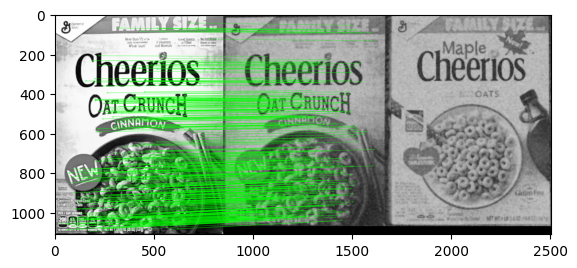

381
Product dataset/models/ref2.png in dataset/scenes/scene1_filtered.png:True
((< cv2.KeyPoint 0x7fc95df754d0>, < cv2.KeyPoint 0x7fc95df75530>, < cv2.KeyPoint 0x7fc99c74c300>, < cv2.KeyPoint 0x7fc963d1dc20>, < cv2.KeyPoint 0x7fc963d1dec0>, < cv2.KeyPoint 0x7fc9639cdf50>, < cv2.KeyPoint 0x7fc9639cdef0>, < cv2.KeyPoint 0x7fc9639cdb00>, < cv2.KeyPoint 0x7fc9639cdb30>, < cv2.KeyPoint 0x7fc9639cdad0>, < cv2.KeyPoint 0x7fc95e07ba80>, < cv2.KeyPoint 0x7fc95e07a160>, < cv2.KeyPoint 0x7fc95e079bc0>, < cv2.KeyPoint 0x7fc95e07a250>, < cv2.KeyPoint 0x7fc95e078c30>, < cv2.KeyPoint 0x7fc9639870c0>, < cv2.KeyPoint 0x7fc963985ef0>, < cv2.KeyPoint 0x7fc963985ec0>, < cv2.KeyPoint 0x7fc963985f20>, < cv2.KeyPoint 0x7fc9639871b0>, < cv2.KeyPoint 0x7fc963987240>, < cv2.KeyPoint 0x7fc963985dd0>, < cv2.KeyPoint 0x7fc963985e00>, < cv2.KeyPoint 0x7fc9639876c0>, < cv2.KeyPoint 0x7fc9639873c0>, < cv2.KeyPoint 0x7fc963987750>, < cv2.KeyPoint 0x7fc963987450>, < cv2.KeyPoint 0x7fc963987600>, < cv2.KeyPoint 0x7fc963

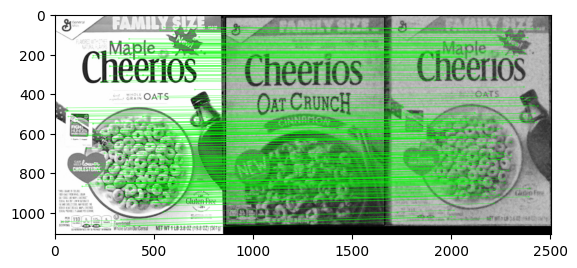

22
Product dataset/models/ref3.png in dataset/scenes/scene1_filtered.png:False
34
Product dataset/models/ref4.png in dataset/scenes/scene1_filtered.png:False
60
Product dataset/models/ref5.png in dataset/scenes/scene1_filtered.png:False
10
Product dataset/models/ref6.png in dataset/scenes/scene1_filtered.png:False
14
Product dataset/models/ref7.png in dataset/scenes/scene1_filtered.png:False
17
Product dataset/models/ref8.png in dataset/scenes/scene1_filtered.png:False
19
Product dataset/models/ref9.png in dataset/scenes/scene1_filtered.png:False
16
Product dataset/models/ref10.png in dataset/scenes/scene1_filtered.png:False
7
Product dataset/models/ref11.png in dataset/scenes/scene1_filtered.png:False
4
Product dataset/models/ref12.png in dataset/scenes/scene1_filtered.png:False
13
Product dataset/models/ref13.png in dataset/scenes/scene1_filtered.png:False
69
Product dataset/models/ref14.png in dataset/scenes/scene1_filtered.png:False


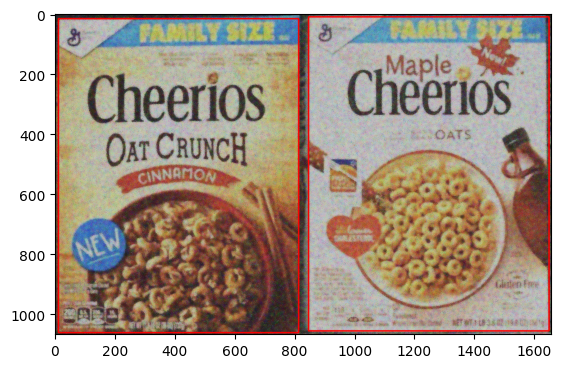

Object 1: 1 instance found, Height=1047.9000244140625, Width=801.719970703125, Center=(412.1509704589844, 539.0888061523438)
Object 2: 1 instance found, Height=1048.1500244140625, Width=802.3800048828125, Center=(1247.864990234375, 533.799560546875)
65
Product dataset/models/ref1.png in dataset/scenes/scene2_filtered.png:False
72
Product dataset/models/ref2.png in dataset/scenes/scene2_filtered.png:True
((< cv2.KeyPoint 0x7fc95df756b0>, < cv2.KeyPoint 0x7fc95e1298c0>, < cv2.KeyPoint 0x7fc95e129ad0>, < cv2.KeyPoint 0x7fc95e1297d0>, < cv2.KeyPoint 0x7fc95e129920>, < cv2.KeyPoint 0x7fc95e1285a0>, < cv2.KeyPoint 0x7fc95e128570>, < cv2.KeyPoint 0x7fc95e128660>, < cv2.KeyPoint 0x7fc95e129950>, < cv2.KeyPoint 0x7fc95e129dd0>, < cv2.KeyPoint 0x7fc95e129d40>, < cv2.KeyPoint 0x7fc95e129a40>, < cv2.KeyPoint 0x7fc95e129cb0>, < cv2.KeyPoint 0x7fc95e129da0>, < cv2.KeyPoint 0x7fc95e129ce0>, < cv2.KeyPoint 0x7fc95e129b90>, < cv2.KeyPoint 0x7fc95e129c80>, < cv2.KeyPoint 0x7fc95e129c20>, < cv2.KeyPoint 

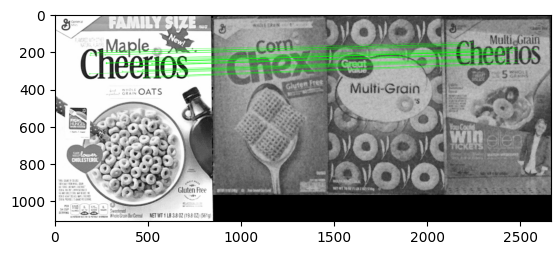

193
Product dataset/models/ref3.png in dataset/scenes/scene2_filtered.png:True
((< cv2.KeyPoint 0x7fc95e017de0>, < cv2.KeyPoint 0x7fc963d1ce10>, < cv2.KeyPoint 0x7fc963d1c270>, < cv2.KeyPoint 0x7fc974fcd950>, < cv2.KeyPoint 0x7fc974fcd260>, < cv2.KeyPoint 0x7fc974fcef10>, < cv2.KeyPoint 0x7fc974fcc4e0>, < cv2.KeyPoint 0x7fc95df9ef10>, < cv2.KeyPoint 0x7fc95df9f570>, < cv2.KeyPoint 0x7fc95df9f540>, < cv2.KeyPoint 0x7fc95df9edc0>, < cv2.KeyPoint 0x7fc95e129260>, < cv2.KeyPoint 0x7fc95e12bea0>, < cv2.KeyPoint 0x7fc95e128540>, < cv2.KeyPoint 0x7fc95e128480>, < cv2.KeyPoint 0x7fc95e1287e0>, < cv2.KeyPoint 0x7fc95e128a80>, < cv2.KeyPoint 0x7fc95e1289f0>, < cv2.KeyPoint 0x7fc95e1291a0>, < cv2.KeyPoint 0x7fc95e1286f0>, < cv2.KeyPoint 0x7fc95e129110>, < cv2.KeyPoint 0x7fc95e128d80>, < cv2.KeyPoint 0x7fc95e129140>, < cv2.KeyPoint 0x7fc95e129170>, < cv2.KeyPoint 0x7fc95e1290e0>, < cv2.KeyPoint 0x7fc95e129230>, < cv2.KeyPoint 0x7fc95e1291d0>, < cv2.KeyPoint 0x7fc95e1284b0>, < cv2.KeyPoint 0x7fc95e

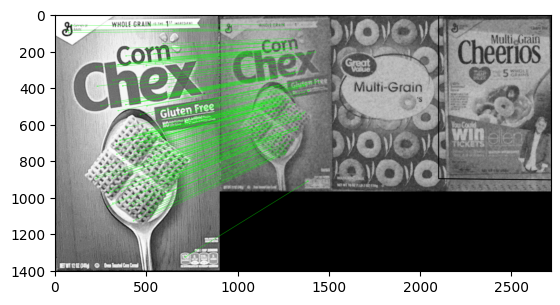

154
Product dataset/models/ref4.png in dataset/scenes/scene2_filtered.png:True
((< cv2.KeyPoint 0x7fc95dfc7d20>, < cv2.KeyPoint 0x7fc963991c20>, < cv2.KeyPoint 0x7fc9639923a0>, < cv2.KeyPoint 0x7fc95e129530>, < cv2.KeyPoint 0x7fc95e12bab0>, < cv2.KeyPoint 0x7fc95e128c00>, < cv2.KeyPoint 0x7fc95e129050>, < cv2.KeyPoint 0x7fc95e128450>, < cv2.KeyPoint 0x7fc95e1281b0>, < cv2.KeyPoint 0x7fc95e129620>, < cv2.KeyPoint 0x7fc95e12a0a0>, < cv2.KeyPoint 0x7fc95e128c90>, < cv2.KeyPoint 0x7fc95e12ad00>, < cv2.KeyPoint 0x7fc95e128c30>, < cv2.KeyPoint 0x7fc95e12ba50>, < cv2.KeyPoint 0x7fc95dfbdfb0>, < cv2.KeyPoint 0x7fc95dfbca50>, < cv2.KeyPoint 0x7fc95dfbd560>, < cv2.KeyPoint 0x7fc95dfbc870>, < cv2.KeyPoint 0x7fc95dfbefd0>, < cv2.KeyPoint 0x7fc95dfbc840>, < cv2.KeyPoint 0x7fc95dfbf9c0>, < cv2.KeyPoint 0x7fc95dfbf660>, < cv2.KeyPoint 0x7fc95dfbcc00>, < cv2.KeyPoint 0x7fc95dfbedc0>, < cv2.KeyPoint 0x7fc95dfbf8a0>, < cv2.KeyPoint 0x7fc95dfbf870>, < cv2.KeyPoint 0x7fc95dfbfb10>, < cv2.KeyPoint 0x7fc95d

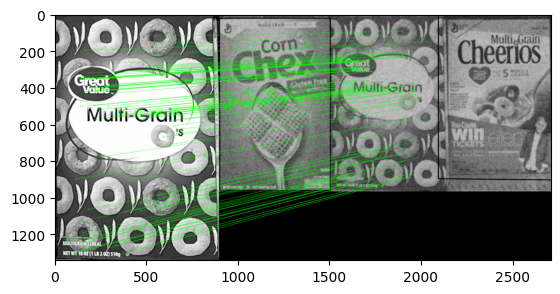

225
Product dataset/models/ref5.png in dataset/scenes/scene2_filtered.png:True
((< cv2.KeyPoint 0x7fc95e0012c0>, < cv2.KeyPoint 0x7fc95e128330>, < cv2.KeyPoint 0x7fc95dfaf600>, < cv2.KeyPoint 0x7fc95dfaf6c0>, < cv2.KeyPoint 0x7fc95dfaf6f0>, < cv2.KeyPoint 0x7fc95dfd3420>, < cv2.KeyPoint 0x7fc95dfd16e0>, < cv2.KeyPoint 0x7fc95dfd1710>, < cv2.KeyPoint 0x7fc95dfd15c0>, < cv2.KeyPoint 0x7fc95dfd3450>, < cv2.KeyPoint 0x7fc95dfd3480>, < cv2.KeyPoint 0x7fc95dfd2be0>, < cv2.KeyPoint 0x7fc95dfd2c40>, < cv2.KeyPoint 0x7fc95dfd1620>, < cv2.KeyPoint 0x7fc95dfd2af0>, < cv2.KeyPoint 0x7fc95dfd3000>, < cv2.KeyPoint 0x7fc95dfd2c70>, < cv2.KeyPoint 0x7fc95dfd2fa0>, < cv2.KeyPoint 0x7fc95dfd2d90>, < cv2.KeyPoint 0x7fc95dfd3060>, < cv2.KeyPoint 0x7fc95dfd2d60>, < cv2.KeyPoint 0x7fc95dfd2df0>, < cv2.KeyPoint 0x7fc95dfd2f40>, < cv2.KeyPoint 0x7fc95dfd2ee0>, < cv2.KeyPoint 0x7fc95dfd2f10>, < cv2.KeyPoint 0x7fc95dfd2e20>, < cv2.KeyPoint 0x7fc95dfd2eb0>, < cv2.KeyPoint 0x7fc95dfd2e50>, < cv2.KeyPoint 0x7fc95d

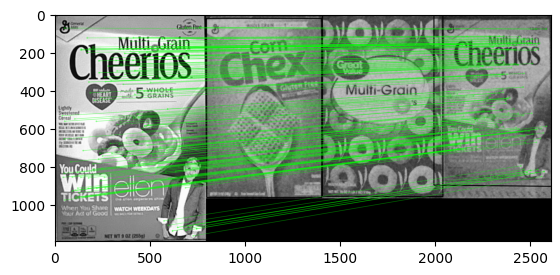

15
Product dataset/models/ref6.png in dataset/scenes/scene2_filtered.png:False
25
Product dataset/models/ref7.png in dataset/scenes/scene2_filtered.png:False
49
Product dataset/models/ref8.png in dataset/scenes/scene2_filtered.png:False
49
Product dataset/models/ref9.png in dataset/scenes/scene2_filtered.png:False
35
Product dataset/models/ref10.png in dataset/scenes/scene2_filtered.png:False
12
Product dataset/models/ref11.png in dataset/scenes/scene2_filtered.png:False
9
Product dataset/models/ref12.png in dataset/scenes/scene2_filtered.png:False
27
Product dataset/models/ref13.png in dataset/scenes/scene2_filtered.png:False
70
Product dataset/models/ref14.png in dataset/scenes/scene2_filtered.png:False


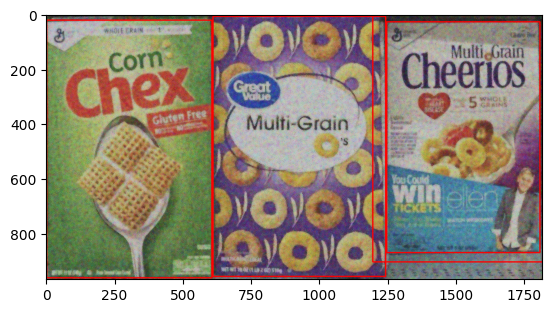

Object 2: 1 instance found, Height=910.1599731445312, Width=683.9199829101562, Center=(1538.83837890625, 450.85076904296875)
Object 3: 1 instance found, Height=940.7999877929688, Width=604.8400268554688, Center=(305.0579833984375, 493.01531982421875)
Object 4: 1 instance found, Height=949.9500122070312, Width=632.1699829101562, Center=(927.2344360351562, 483.12847900390625)
Object 5: 1 instance found, Height=842.3699951171875, Width=560.47998046875, Center=(1528.195556640625, 450.0174560546875)
20
Product dataset/models/ref1.png in dataset/scenes/scene3_filtered.png:False
18
Product dataset/models/ref2.png in dataset/scenes/scene3_filtered.png:False
52
Product dataset/models/ref3.png in dataset/scenes/scene3_filtered.png:False
14
Product dataset/models/ref4.png in dataset/scenes/scene3_filtered.png:False
24
Product dataset/models/ref5.png in dataset/scenes/scene3_filtered.png:False
111
Product dataset/models/ref6.png in dataset/scenes/scene3_filtered.png:True
((< cv2.KeyPoint 0x7fc95e0

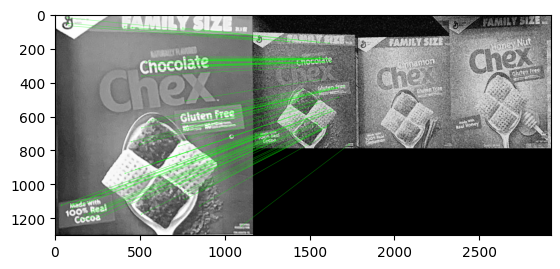

93
Product dataset/models/ref7.png in dataset/scenes/scene3_filtered.png:True
((< cv2.KeyPoint 0x7fc974fcde90>, < cv2.KeyPoint 0x7fc974fcdfe0>, < cv2.KeyPoint 0x7fc974fcd530>, < cv2.KeyPoint 0x7fc974fccae0>, < cv2.KeyPoint 0x7fc974fcd740>, < cv2.KeyPoint 0x7fc974fce340>, < cv2.KeyPoint 0x7fc95dfd1d10>, < cv2.KeyPoint 0x7fc95dfd3810>, < cv2.KeyPoint 0x7fc95dfbdf50>, < cv2.KeyPoint 0x7fc95dfbf270>, < cv2.KeyPoint 0x7fc95dfbf210>, < cv2.KeyPoint 0x7fc95dfbf2d0>, < cv2.KeyPoint 0x7fc95dfbf1b0>, < cv2.KeyPoint 0x7fc95dfbe520>, < cv2.KeyPoint 0x7fc95dfbf960>, < cv2.KeyPoint 0x7fc95dfbf330>, < cv2.KeyPoint 0x7fc95dfbf990>, < cv2.KeyPoint 0x7fc95dfbfd20>, < cv2.KeyPoint 0x7fc95dfbfb70>, < cv2.KeyPoint 0x7fc95dfbd5f0>, < cv2.KeyPoint 0x7fc95dfbdfe0>, < cv2.KeyPoint 0x7fc95dfbd650>, < cv2.KeyPoint 0x7fc95dfbdb60>, < cv2.KeyPoint 0x7fc95dfbd3b0>, < cv2.KeyPoint 0x7fc95dfbfe10>, < cv2.KeyPoint 0x7fc95dfbff30>, < cv2.KeyPoint 0x7fc95dfbffc0>, < cv2.KeyPoint 0x7fc95dfbff90>, < cv2.KeyPoint 0x7fc95df

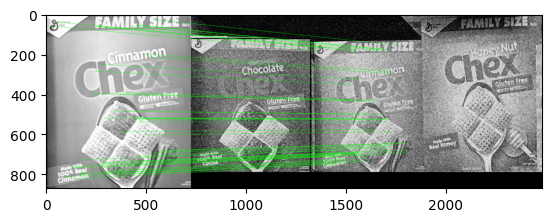

142
Product dataset/models/ref8.png in dataset/scenes/scene3_filtered.png:True
((< cv2.KeyPoint 0x7fc95e0ca100>, < cv2.KeyPoint 0x7fc963993db0>, < cv2.KeyPoint 0x7fc963993cf0>, < cv2.KeyPoint 0x7fc963993570>, < cv2.KeyPoint 0x7fc963993540>, < cv2.KeyPoint 0x7fc95dfb23a0>, < cv2.KeyPoint 0x7fc95dfb1ef0>, < cv2.KeyPoint 0x7fc95dfb2430>, < cv2.KeyPoint 0x7fc95dfb1f50>, < cv2.KeyPoint 0x7fc95e006970>, < cv2.KeyPoint 0x7fc95e006ac0>, < cv2.KeyPoint 0x7fc95e004030>, < cv2.KeyPoint 0x7fc95e007e10>, < cv2.KeyPoint 0x7fc95e004540>, < cv2.KeyPoint 0x7fc95e004f90>, < cv2.KeyPoint 0x7fc95e004570>, < cv2.KeyPoint 0x7fc95e004cc0>, < cv2.KeyPoint 0x7fc95e004900>, < cv2.KeyPoint 0x7fc95df77f90>, < cv2.KeyPoint 0x7fc95df772a0>, < cv2.KeyPoint 0x7fc95df77510>, < cv2.KeyPoint 0x7fc95df77810>, < cv2.KeyPoint 0x7fc95df762b0>, < cv2.KeyPoint 0x7fc95df75c80>, < cv2.KeyPoint 0x7fc95df753b0>, < cv2.KeyPoint 0x7fc95df74240>, < cv2.KeyPoint 0x7fc95df76850>, < cv2.KeyPoint 0x7fc95df77900>, < cv2.KeyPoint 0x7fc95d

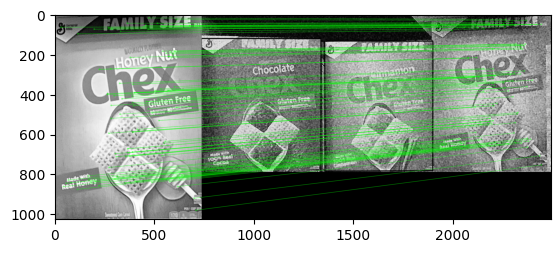

33
Product dataset/models/ref9.png in dataset/scenes/scene3_filtered.png:False
29
Product dataset/models/ref10.png in dataset/scenes/scene3_filtered.png:False
8
Product dataset/models/ref11.png in dataset/scenes/scene3_filtered.png:False
9
Product dataset/models/ref12.png in dataset/scenes/scene3_filtered.png:False
9
Product dataset/models/ref13.png in dataset/scenes/scene3_filtered.png:False
18
Product dataset/models/ref14.png in dataset/scenes/scene3_filtered.png:False


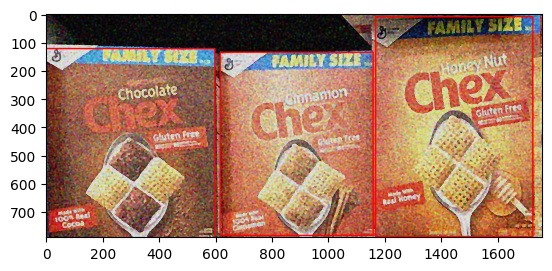

Object 6: 1 instance found, Height=670.6699829101562, Width=600.739990234375, Center=(298.32550048828125, 457.629150390625)
Object 7: 1 instance found, Height=648.6900024414062, Width=542.3300170898438, Center=(888.6512451171875, 460.3465881347656)
Object 8: 1 instance found, Height=778.8800048828125, Width=556.489990234375, Center=(1446.9638671875, 398.8848876953125)
185
Product dataset/models/ref1.png in dataset/scenes/scene4_filtered.png:True
((< cv2.KeyPoint 0x7fc95e004030>, < cv2.KeyPoint 0x7fc95e0790b0>, < cv2.KeyPoint 0x7fc95e079f50>, < cv2.KeyPoint 0x7fc95e07a0d0>, < cv2.KeyPoint 0x7fc95dfbc570>, < cv2.KeyPoint 0x7fc95dfbd050>, < cv2.KeyPoint 0x7fc95dfbc510>, < cv2.KeyPoint 0x7fc95dfbf7b0>, < cv2.KeyPoint 0x7fc95dfbdbc0>, < cv2.KeyPoint 0x7fc95e09d1a0>, < cv2.KeyPoint 0x7fc95e09cdb0>, < cv2.KeyPoint 0x7fc95e09d0e0>, < cv2.KeyPoint 0x7fc95e09cea0>, < cv2.KeyPoint 0x7fc95e09c1e0>, < cv2.KeyPoint 0x7fc95e09c6f0>, < cv2.KeyPoint 0x7fc95e09ce40>, < cv2.KeyPoint 0x7fc95e09c2d0>, < cv

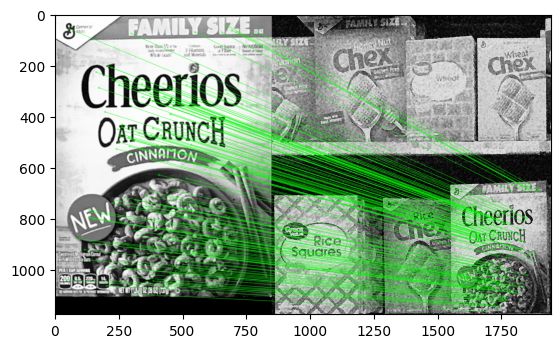

61
Product dataset/models/ref2.png in dataset/scenes/scene4_filtered.png:False
25
Product dataset/models/ref3.png in dataset/scenes/scene4_filtered.png:False
30
Product dataset/models/ref4.png in dataset/scenes/scene4_filtered.png:False
33
Product dataset/models/ref5.png in dataset/scenes/scene4_filtered.png:False
17
Product dataset/models/ref6.png in dataset/scenes/scene4_filtered.png:False
32
Product dataset/models/ref7.png in dataset/scenes/scene4_filtered.png:False
60
Product dataset/models/ref8.png in dataset/scenes/scene4_filtered.png:False
83
Product dataset/models/ref9.png in dataset/scenes/scene4_filtered.png:True
((< cv2.KeyPoint 0x7fc95dfbc510>, < cv2.KeyPoint 0x7fc95dfbdbc0>, < cv2.KeyPoint 0x7fc95dfbd050>, < cv2.KeyPoint 0x7fc95dfbc570>, < cv2.KeyPoint 0x7fc95dfbf7b0>, < cv2.KeyPoint 0x7fc9639c2d00>, < cv2.KeyPoint 0x7fc9639c3750>, < cv2.KeyPoint 0x7fc9639c3720>, < cv2.KeyPoint 0x7fc9639c33c0>, < cv2.KeyPoint 0x7fc9639c2c40>, < cv2.KeyPoint 0x7fc9639c3690>, < cv2.KeyPoint 

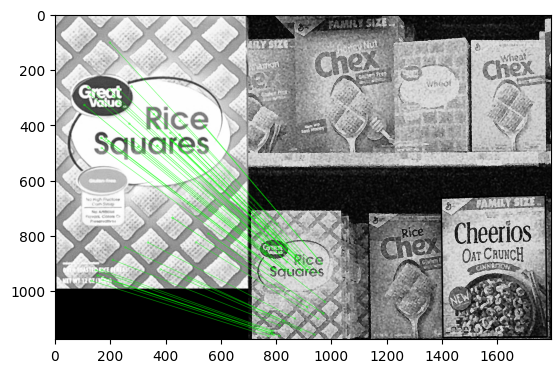

20
Product dataset/models/ref10.png in dataset/scenes/scene4_filtered.png:False
12
Product dataset/models/ref11.png in dataset/scenes/scene4_filtered.png:False
3
Product dataset/models/ref12.png in dataset/scenes/scene4_filtered.png:False
17
Product dataset/models/ref13.png in dataset/scenes/scene4_filtered.png:False
46
Product dataset/models/ref14.png in dataset/scenes/scene4_filtered.png:False


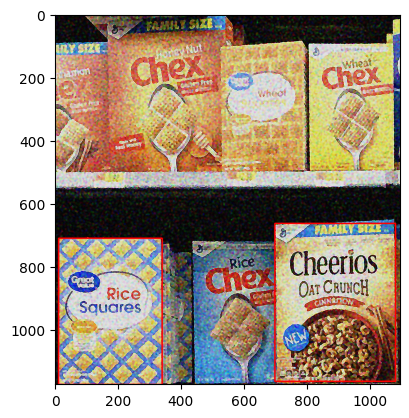

Object 1: 1 instance found, Height=501.25, Width=381.5899963378906, Center=(887.4722900390625, 915.176025390625)
Object 9: 1 instance found, Height=464.5400085449219, Width=328.6099853515625, Center=(175.33126831054688, 943.5670166015625)
37
Product dataset/models/ref1.png in dataset/scenes/scene5_filtered.png:False
60
Product dataset/models/ref2.png in dataset/scenes/scene5_filtered.png:False
22
Product dataset/models/ref3.png in dataset/scenes/scene5_filtered.png:False
20
Product dataset/models/ref4.png in dataset/scenes/scene5_filtered.png:False
27
Product dataset/models/ref5.png in dataset/scenes/scene5_filtered.png:False
11
Product dataset/models/ref6.png in dataset/scenes/scene5_filtered.png:False
13
Product dataset/models/ref7.png in dataset/scenes/scene5_filtered.png:False
20
Product dataset/models/ref8.png in dataset/scenes/scene5_filtered.png:False
18
Product dataset/models/ref9.png in dataset/scenes/scene5_filtered.png:False
8
Product dataset/models/ref10.png in dataset/scen

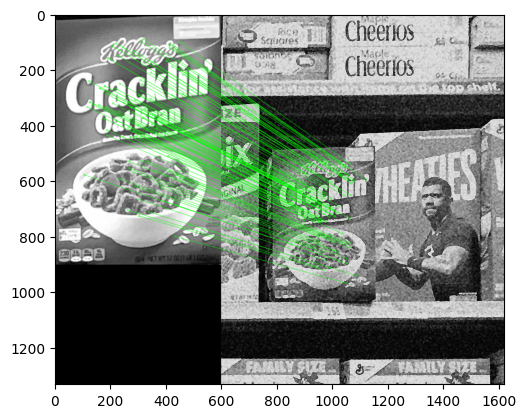

72
Product dataset/models/ref12.png in dataset/scenes/scene5_filtered.png:True
((< cv2.KeyPoint 0x7fc95dd8b030>, < cv2.KeyPoint 0x7fc95dd89710>, < cv2.KeyPoint 0x7fc95df6bde0>, < cv2.KeyPoint 0x7fc95df6bb40>, < cv2.KeyPoint 0x7fc95df6b2d0>, < cv2.KeyPoint 0x7fc95df6b300>, < cv2.KeyPoint 0x7fc95df6ba80>, < cv2.KeyPoint 0x7fc95df6b8d0>, < cv2.KeyPoint 0x7fc95df6b270>, < cv2.KeyPoint 0x7fc963990990>, < cv2.KeyPoint 0x7fc9639909c0>, < cv2.KeyPoint 0x7fc963990960>, < cv2.KeyPoint 0x7fc9639909f0>, < cv2.KeyPoint 0x7fc963990b40>, < cv2.KeyPoint 0x7fc963990ba0>, < cv2.KeyPoint 0x7fc963990a20>, < cv2.KeyPoint 0x7fc963990a50>, < cv2.KeyPoint 0x7fc963990d50>, < cv2.KeyPoint 0x7fc963990ea0>, < cv2.KeyPoint 0x7fc963990e40>, < cv2.KeyPoint 0x7fc963990e70>, < cv2.KeyPoint 0x7fc963990d80>, < cv2.KeyPoint 0x7fc963990e10>, < cv2.KeyPoint 0x7fc963990db0>, < cv2.KeyPoint 0x7fc963990de0>, < cv2.KeyPoint 0x7fc963990a80>, < cv2.KeyPoint 0x7fc963990ab0>, < cv2.KeyPoint 0x7fc963990b70>, < cv2.KeyPoint 0x7fc963

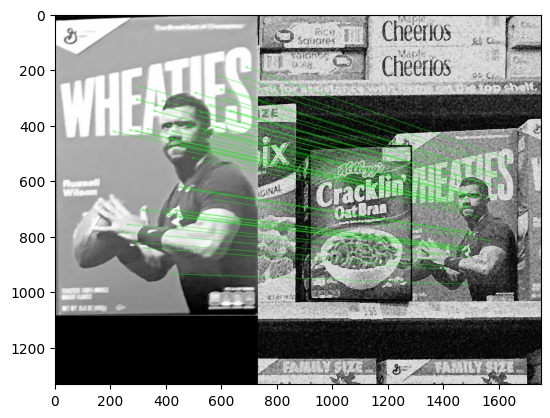

26
Product dataset/models/ref13.png in dataset/scenes/scene5_filtered.png:False
29
Product dataset/models/ref14.png in dataset/scenes/scene5_filtered.png:False


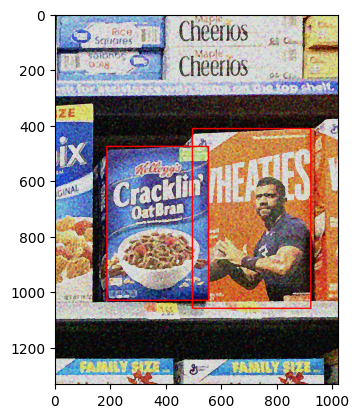

Object 11: 1 instance found, Height=554.0999755859375, Width=365.6099853515625, Center=(369.59283447265625, 753.5482788085938)
Object 12: 1 instance found, Height=647.4400024414062, Width=426.3699951171875, Center=(707.7359008789062, 736.0281982421875)


In [7]:
contain_img = {}
# Iterate among scenes
imgs_train_filterd = ['dataset/scenes/scene{}_filtered.png'.format(i) for i in range(1, 6)]
for scene_image in imgs_train_filterd:
  # Count instances of each object
  object_counts = {}
  # Initialize variables to store accumulated bounding box information
  all_bounding_boxes = []
  all_center_positions = []
  img_train = cv2.imread(scene_image,0)
  img = cv2.imread(scene_image)
  #Iterate among queryimage to see if in scene
  for i in range(1, 15):
      img_query = cv2.imread('dataset/models/ref{}.png'.format(i),0)

      good, kp_query = object_retrieve(img_query, img_train, 70)

      print("Product {} in {}:{}".format('dataset/models/ref{}.png'.format(i),scene_image,good != None))

      if good != None:
        print(good)
        img_train_with_box, bounding_box_height, bounding_box_width, center_position = poistion_estimation(good, kp_query, img_query, img_train)
        all_bounding_boxes.append((bounding_box_height, bounding_box_width,i))
        all_center_positions.append(center_position)

        # Count instances of each object
        object_counts.setdefault(len(all_bounding_boxes), 0)
        object_counts[len(all_bounding_boxes)] += 1
    # Draw all bounding boxes on a single image
  if img_train_with_box is not None:
      img_with_boxes = img.copy()
      for i, ((bounding_box_height, bounding_box_width, number), center_position) in enumerate(zip(all_bounding_boxes, all_center_positions), 1):
          cv2.rectangle(img_with_boxes, (int(center_position[0] - bounding_box_width / 2),
                                           int(center_position[1] - bounding_box_height / 2)),
                          (int(center_position[0] + bounding_box_width / 2),
                           int(center_position[1] + bounding_box_height / 2)), (0, 0, 255), 3)
          text = f'Object {i}: Height={round(bounding_box_height, 2)}, Width={round(bounding_box_width, 2)}, Center={center_position}'
          #cv2.putText(img_with_boxes, text, (int(center_position[0]), int(center_position[1] + 20 * i)), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 1)

      plt.imshow(cv2.cvtColor(img_with_boxes, cv2.COLOR_BGR2RGB))
      plt.show()
      for k, ((bounding_box_height, bounding_box_width, number), center_position) in enumerate(zip(all_bounding_boxes, all_center_positions), 1):
        count_text = f"{object_counts[k]} instance{'s' if object_counts[k] > 1 else ''} found"
        print(f'Object {number}: {count_text}, Height={round(bounding_box_height, 2)}, Width={round(bounding_box_width, 2)}, Center={center_position}')



# For mutiple

## Filtering

As stated before, the scene images contain some noise. We therfore start by denoising the scene iamges before further processing.

As the first two scene images (6 and 7) are less noisy than the rest, we have decided to filter more for the three last images than for the two first.

In [8]:
import cv2
imgs_train = ['dataset/scenes/scene{}.png'.format(i) for i in range(6, 13)]
for i in range(len(imgs_train)):
  img = cv2.imread(imgs_train[i])
  img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  if i < 2:
    img_rgb = cv2.bilateralFilter(img_rgb, 15, 200, 100)
  else:
    median_blur = cv2.medianBlur(img_rgb, 5)

    # Apply Gaussian Blur to smooth the image
    gaussian_blur = cv2.GaussianBlur(median_blur, (5, 5), 0)

    # Apply Bilateral Filter to preserve edges while reducing noise
    img_rgb= cv2.bilateralFilter(gaussian_blur, 9, 75, 75)

    # Convert to grayscale
    gray_img = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2GRAY)

    # Apply Laplacian filter for edge detection and sharpening
    laplacian = cv2.Laplacian(img_rgb, cv2.CV_64F)
    sharp_edges = cv2.convertScaleAbs(laplacian)

    # Combine the original color image with the sharp edges
    img_rgb = cv2.addWeighted(img_rgb, 0.8, sharp_edges, 0.2, 0)

  name = imgs_train[i].replace(".png", "_filtered.png")
  cv2.imwrite(name, cv2.cvtColor(img_rgb, cv2.COLOR_RGB2BGR))

  print(f"save succeded as: {name}")

save succeded as: dataset/scenes/scene6_filtered.png
save succeded as: dataset/scenes/scene7_filtered.png
save succeded as: dataset/scenes/scene8_filtered.png
save succeded as: dataset/scenes/scene9_filtered.png
save succeded as: dataset/scenes/scene10_filtered.png
save succeded as: dataset/scenes/scene11_filtered.png
save succeded as: dataset/scenes/scene12_filtered.png



We iterate over all scene images and models with single instance, and call the two functions above in order to detect the objects.

[[108 105  85 ...  33  43  34]
 [137 141 127 ...  27  27  65]
 [111 138 109 ...  40  28  30]
 ...
 [128  93 133 ... 151 115 113]
 [155 118 141 ... 153 125 141]
 [149 147 146 ... 136 106 119]]


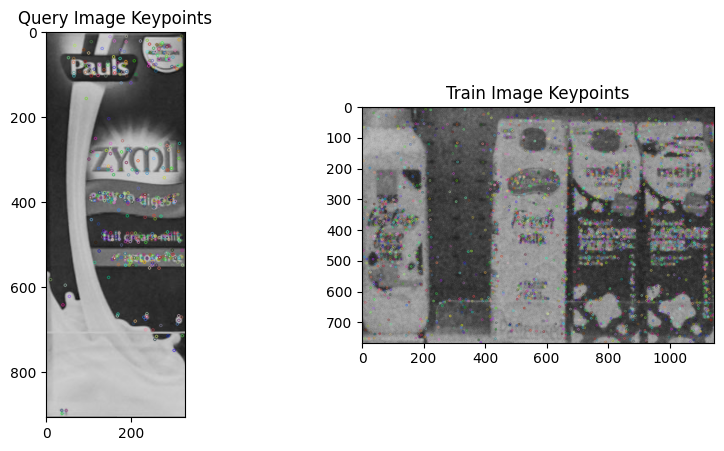

Keypoint coordinates for clustering: [[   3.4499383   361.69888306]
 [   3.4499383   361.69888306]
 [   4.18617773  465.50302124]
 ...
 [1142.03723145  680.93780518]
 [1142.56921387  715.27093506]
 [1142.62756348  607.58691406]]
Estimated bandwidth: 165.91346295674705
number of estimated clusters : 8
cluster 0
length 3
cluster 1
length 3
cluster 2
length 3
cluster 3
length 2
cluster 4
length 0
cluster 5
length 4
cluster 6
length 2
cluster 7
length 2
Product dataset/models/ref15.png in dataset/scenes/scene7_filtered.png:False


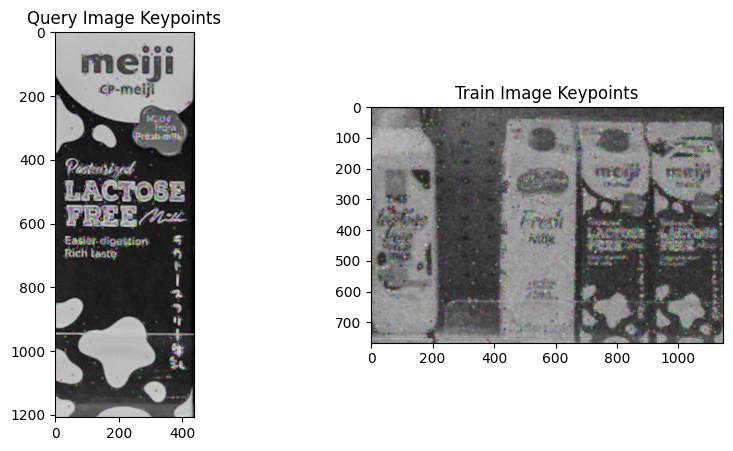

Keypoint coordinates for clustering: [[   3.4499383   361.69888306]
 [   3.4499383   361.69888306]
 [   4.18617773  465.50302124]
 ...
 [1142.03723145  680.93780518]
 [1142.56921387  715.27093506]
 [1142.62756348  607.58691406]]
Estimated bandwidth: 165.91346295674705
number of estimated clusters : 8
cluster 0
length 4
cluster 1
length 12
cluster 2
length 5
cluster 3
length 6
cluster 4
length 76
cluster 5
length 24
cluster 6
length 60
cluster 7
length 37
Product dataset/models/ref16.png in dataset/scenes/scene7_filtered.png:True


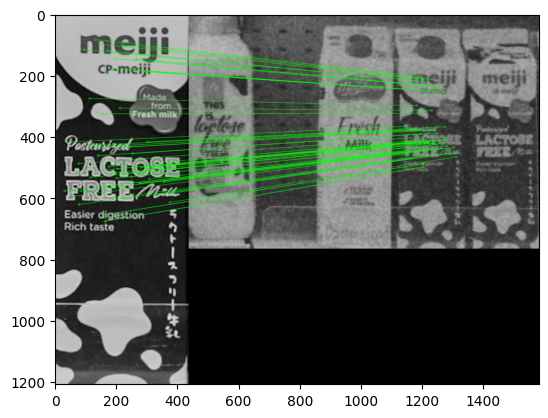

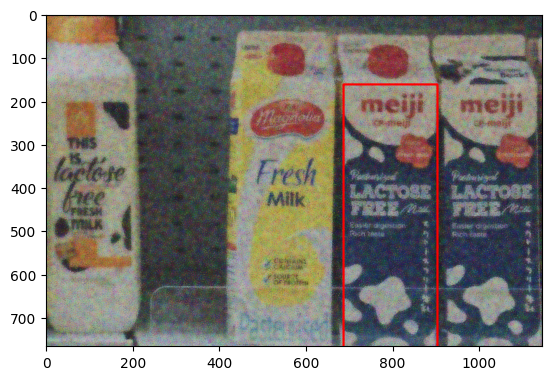

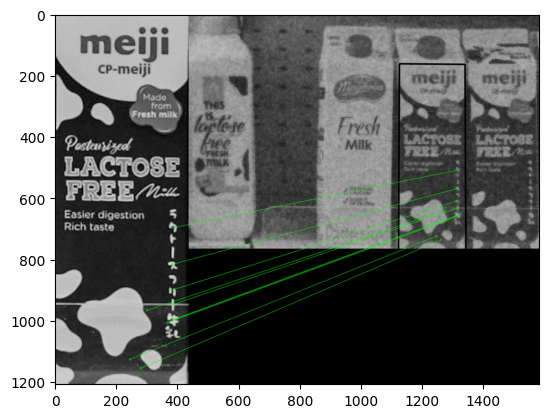

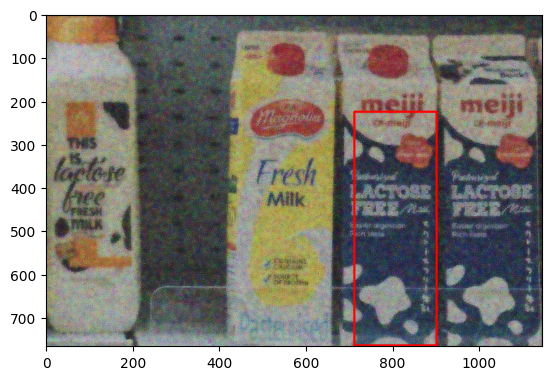

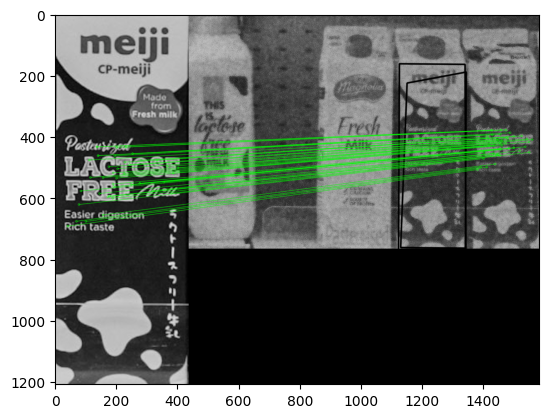

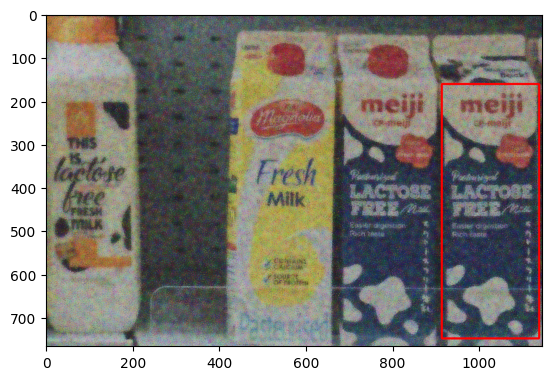

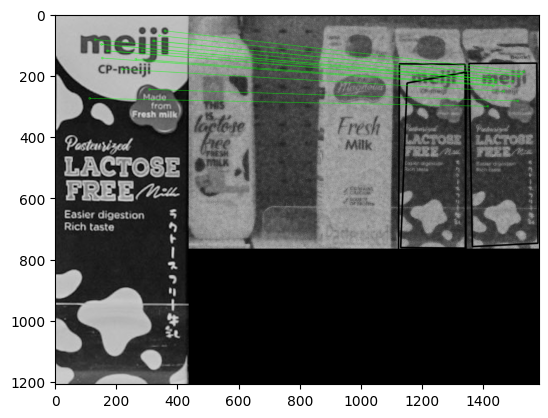

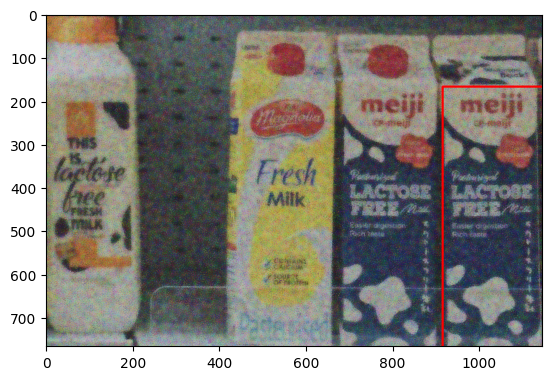

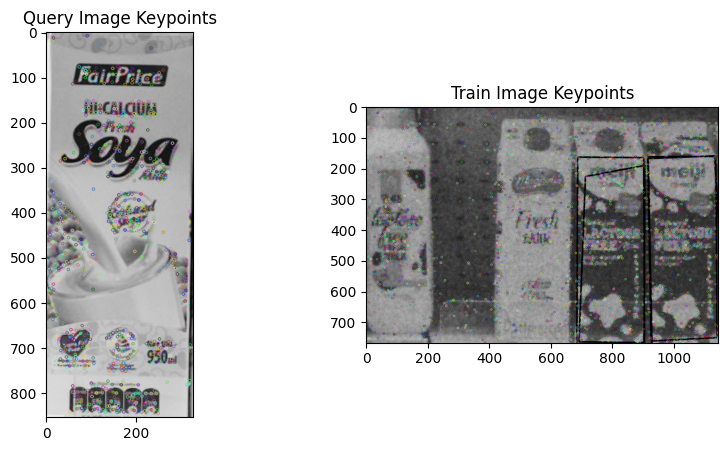

Keypoint coordinates for clustering: [[   3.4499383   361.69888306]
 [   3.4499383   361.69888306]
 [   4.18617773  465.50302124]
 ...
 [1143.03430176  731.59405518]
 [1143.1418457   746.71447754]
 [1143.19885254  711.45782471]]
Estimated bandwidth: 168.51834106980743
number of estimated clusters : 6
cluster 0
length 5
cluster 1
length 1
cluster 2
length 11
cluster 3
length 11
cluster 4
length 7
cluster 5
length 1
Product dataset/models/ref17.png in dataset/scenes/scene7_filtered.png:False


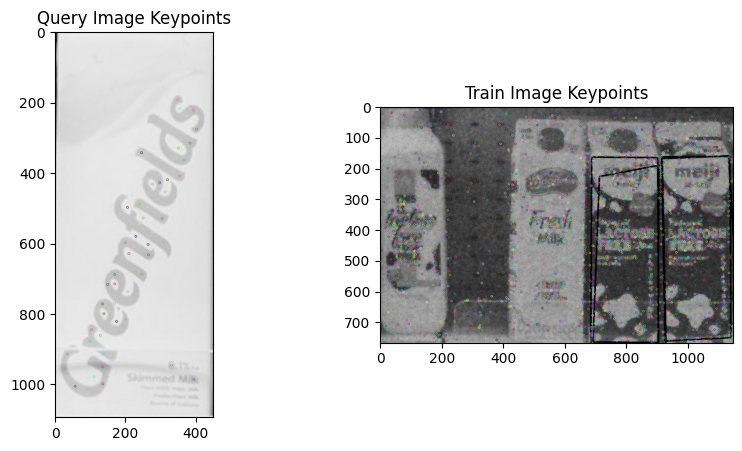

Keypoint coordinates for clustering: [[   3.4499383   361.69888306]
 [   3.4499383   361.69888306]
 [   4.18617773  465.50302124]
 ...
 [1143.03430176  731.59405518]
 [1143.1418457   746.71447754]
 [1143.19885254  711.45782471]]
Estimated bandwidth: 168.51834106980743
number of estimated clusters : 6
cluster 0
length 0
cluster 1
length 0
cluster 2
length 1
cluster 3
length 0
cluster 4
length 0
cluster 5
length 0
Product dataset/models/ref18.png in dataset/scenes/scene7_filtered.png:False


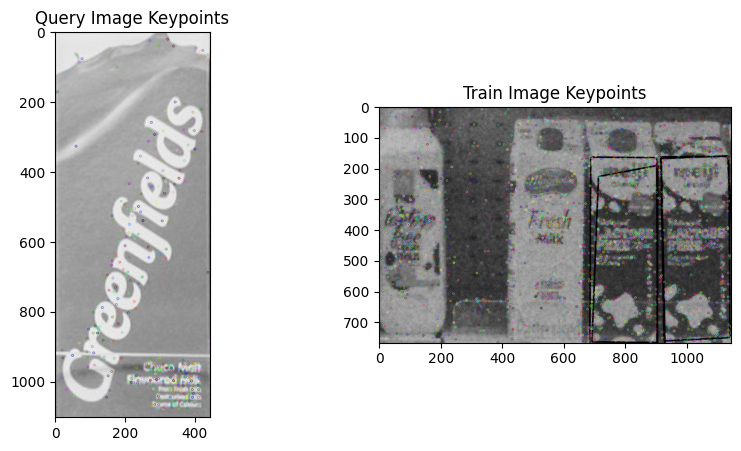

Keypoint coordinates for clustering: [[   3.4499383   361.69888306]
 [   3.4499383   361.69888306]
 [   4.18617773  465.50302124]
 ...
 [1143.03430176  731.59405518]
 [1143.1418457   746.71447754]
 [1143.19885254  711.45782471]]
Estimated bandwidth: 168.51834106980743
number of estimated clusters : 6
cluster 0
length 2
cluster 1
length 2
cluster 2
length 2
cluster 3
length 9
cluster 4
length 5
cluster 5
length 4
Product dataset/models/ref19.png in dataset/scenes/scene7_filtered.png:False


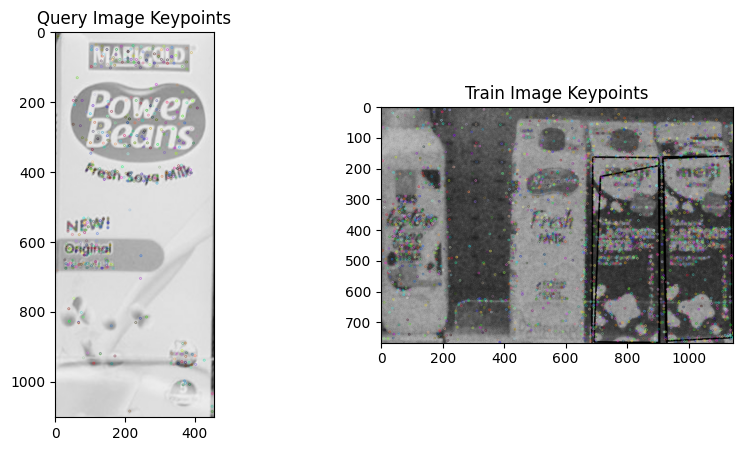

Keypoint coordinates for clustering: [[   3.4499383   361.69888306]
 [   3.4499383   361.69888306]
 [   4.18617773  465.50302124]
 ...
 [1143.03430176  731.59405518]
 [1143.1418457   746.71447754]
 [1143.19885254  711.45782471]]
Estimated bandwidth: 168.51834106980743
number of estimated clusters : 6
cluster 0
length 1
cluster 1
length 0
cluster 2
length 6
cluster 3
length 3
cluster 4
length 9
cluster 5
length 1
Product dataset/models/ref20.png in dataset/scenes/scene7_filtered.png:False


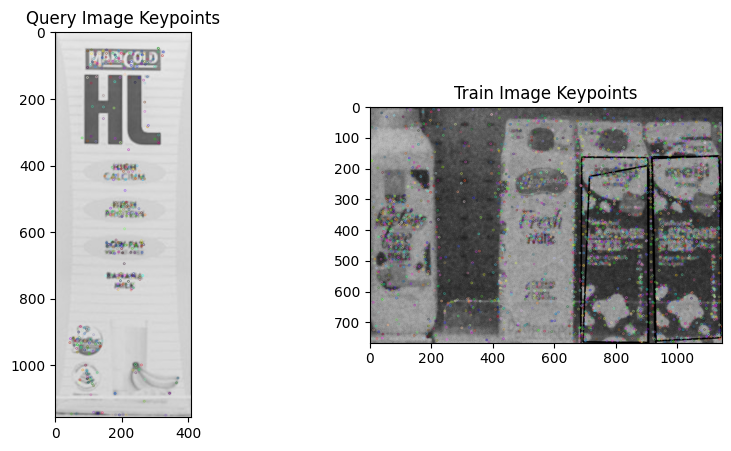

Keypoint coordinates for clustering: [[   3.4499383   361.69888306]
 [   3.4499383   361.69888306]
 [   4.18617773  465.50302124]
 ...
 [1143.03430176  731.59405518]
 [1143.1418457   746.71447754]
 [1143.19885254  711.45782471]]
Estimated bandwidth: 168.51834106980743
number of estimated clusters : 6
cluster 0
length 4
cluster 1
length 0
cluster 2
length 6
cluster 3
length 8
cluster 4
length 6
cluster 5
length 3
Product dataset/models/ref21.png in dataset/scenes/scene7_filtered.png:False


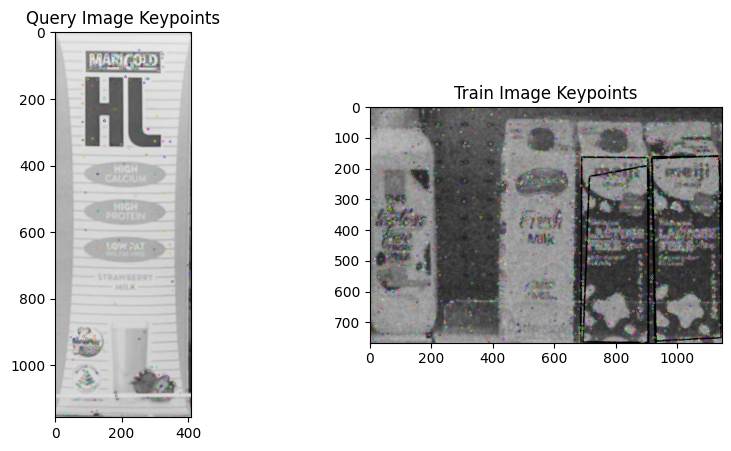

Keypoint coordinates for clustering: [[   3.4499383   361.69888306]
 [   3.4499383   361.69888306]
 [   4.18617773  465.50302124]
 ...
 [1143.03430176  731.59405518]
 [1143.1418457   746.71447754]
 [1143.19885254  711.45782471]]
Estimated bandwidth: 168.51834106980743
number of estimated clusters : 6
cluster 0
length 1
cluster 1
length 3
cluster 2
length 2
cluster 3
length 3
cluster 4
length 2
cluster 5
length 2
Product dataset/models/ref22.png in dataset/scenes/scene7_filtered.png:False


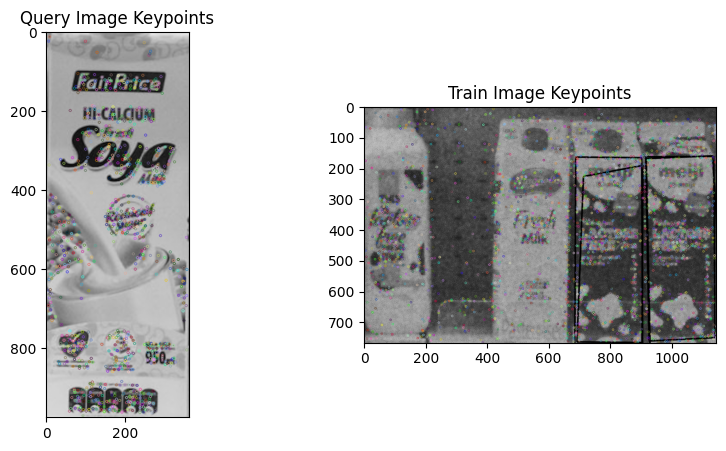

Keypoint coordinates for clustering: [[   3.4499383   361.69888306]
 [   3.4499383   361.69888306]
 [   4.18617773  465.50302124]
 ...
 [1143.03430176  731.59405518]
 [1143.1418457   746.71447754]
 [1143.19885254  711.45782471]]
Estimated bandwidth: 168.51834106980743
number of estimated clusters : 6
cluster 0
length 7
cluster 1
length 5
cluster 2
length 6
cluster 3
length 7
cluster 4
length 19
cluster 5
length 4
Product dataset/models/ref23.png in dataset/scenes/scene7_filtered.png:False


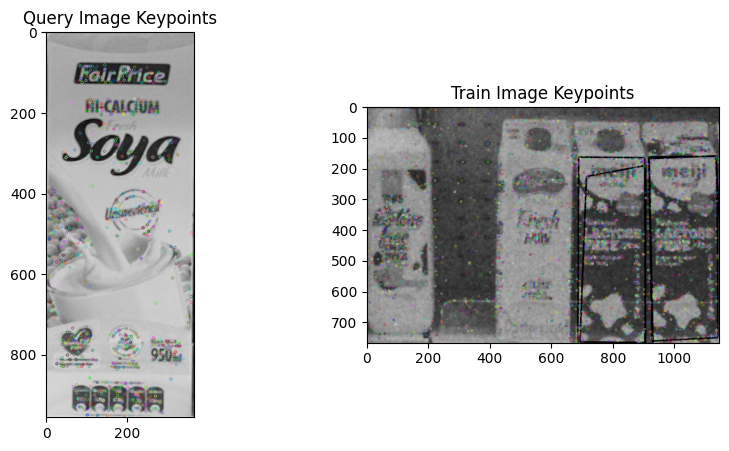

Keypoint coordinates for clustering: [[   3.4499383   361.69888306]
 [   3.4499383   361.69888306]
 [   4.18617773  465.50302124]
 ...
 [1143.03430176  731.59405518]
 [1143.1418457   746.71447754]
 [1143.19885254  711.45782471]]
Estimated bandwidth: 168.51834106980743
number of estimated clusters : 6
cluster 0
length 6
cluster 1
length 2
cluster 2
length 5
cluster 3
length 11
cluster 4
length 13
cluster 5
length 1
Product dataset/models/ref24.png in dataset/scenes/scene7_filtered.png:False


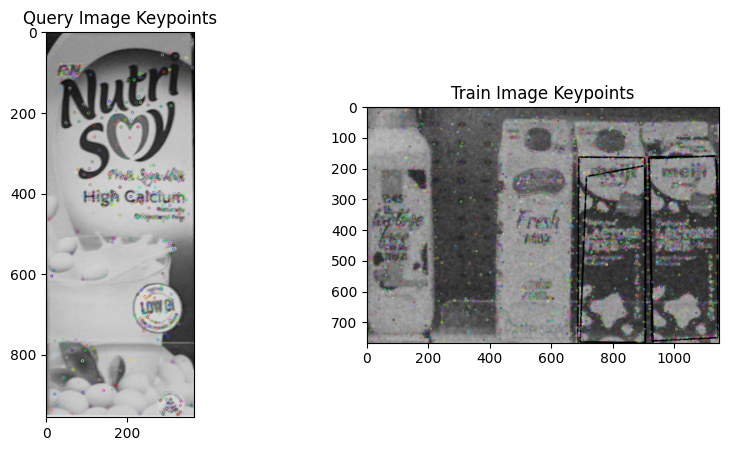

Keypoint coordinates for clustering: [[   3.4499383   361.69888306]
 [   3.4499383   361.69888306]
 [   4.18617773  465.50302124]
 ...
 [1143.03430176  731.59405518]
 [1143.1418457   746.71447754]
 [1143.19885254  711.45782471]]
Estimated bandwidth: 168.51834106980743
number of estimated clusters : 6
cluster 0
length 3
cluster 1
length 2
cluster 2
length 7
cluster 3
length 1
cluster 4
length 4
cluster 5
length 0
Product dataset/models/ref25.png in dataset/scenes/scene7_filtered.png:False


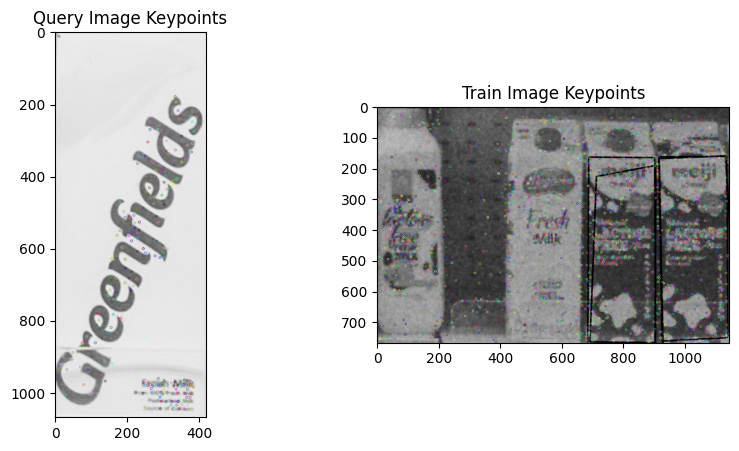

Keypoint coordinates for clustering: [[   3.4499383   361.69888306]
 [   3.4499383   361.69888306]
 [   4.18617773  465.50302124]
 ...
 [1143.03430176  731.59405518]
 [1143.1418457   746.71447754]
 [1143.19885254  711.45782471]]
Estimated bandwidth: 168.51834106980743
number of estimated clusters : 6
cluster 0
length 2
cluster 1
length 2
cluster 2
length 7
cluster 3
length 3
cluster 4
length 7
cluster 5
length 9
Product dataset/models/ref26.png in dataset/scenes/scene7_filtered.png:False


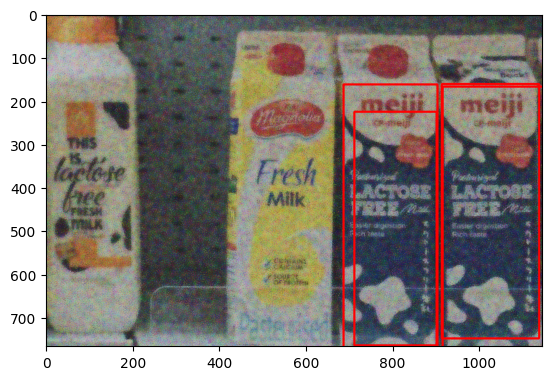

Object 16: 1 instance found, Height=606.97998046875, Width=216.89999389648438, Center=(795.7871704101562, 465.5274353027344)
Object 16: 1 instance found, Height=538.6799926757812, Width=189.22000122070312, Center=(807.6007080078125, 495.283935546875)
Object 16: 1 instance found, Height=586.6799926757812, Width=224.8300018310547, Center=(1027.15625, 455.20880126953125)
Object 16: 1 instance found, Height=660.8400268554688, Width=255.2899932861328, Center=(1044.5562744140625, 497.8526916503906)
[[ 77  79  83 ...  85  83  83]
 [ 78  79  83 ...  84  83  82]
 [ 78  80  82 ...  82  80  79]
 ...
 [112 112 112 ... 152 150 150]
 [110 111 111 ... 152 150 149]
 [110 110 110 ... 151 149 149]]


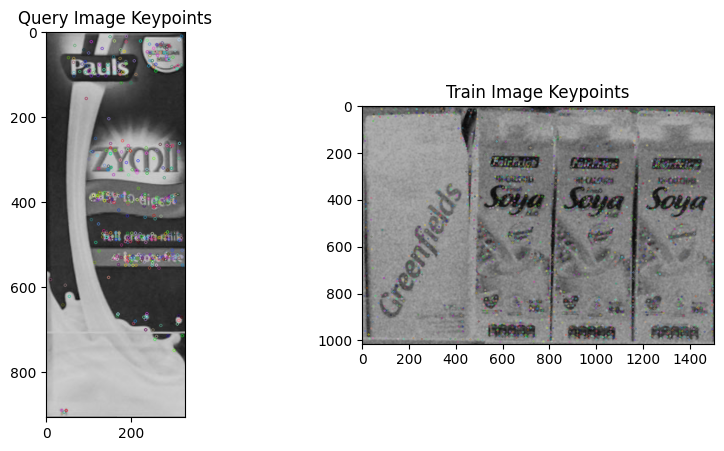

Keypoint coordinates for clustering: [[   9.99029827  808.80377197]
 [  10.20858765  786.05352783]
 [  11.0478096   723.45562744]
 ...
 [1498.2409668   394.1350708 ]
 [1498.48693848  796.53625488]
 [1499.14440918  441.73553467]]
Estimated bandwidth: 227.21650086100175
number of estimated clusters : 6
cluster 0
length 1
cluster 1
length 3
cluster 2
length 2
cluster 3
length 2
cluster 4
length 3
cluster 5
length 1
Product dataset/models/ref15.png in dataset/scenes/scene8_filtered.png:False


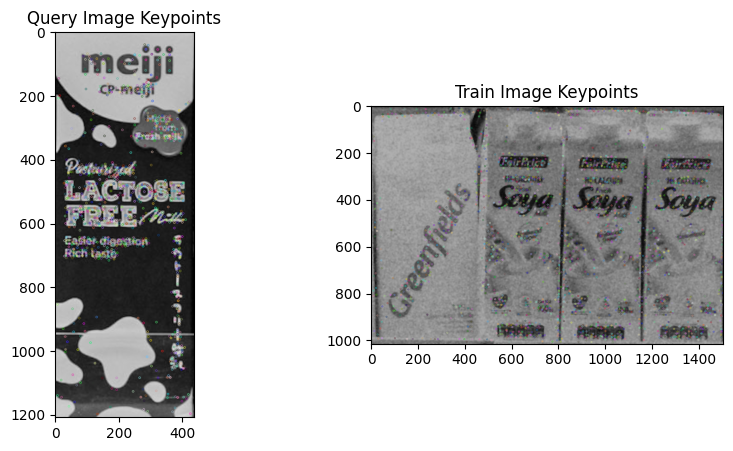

Keypoint coordinates for clustering: [[   9.99029827  808.80377197]
 [  10.20858765  786.05352783]
 [  11.0478096   723.45562744]
 ...
 [1498.2409668   394.1350708 ]
 [1498.48693848  796.53625488]
 [1499.14440918  441.73553467]]
Estimated bandwidth: 227.21650086100175
number of estimated clusters : 6
cluster 0
length 7
cluster 1
length 6
cluster 2
length 4
cluster 3
length 12
cluster 4
length 6
cluster 5
length 5
Product dataset/models/ref16.png in dataset/scenes/scene8_filtered.png:False


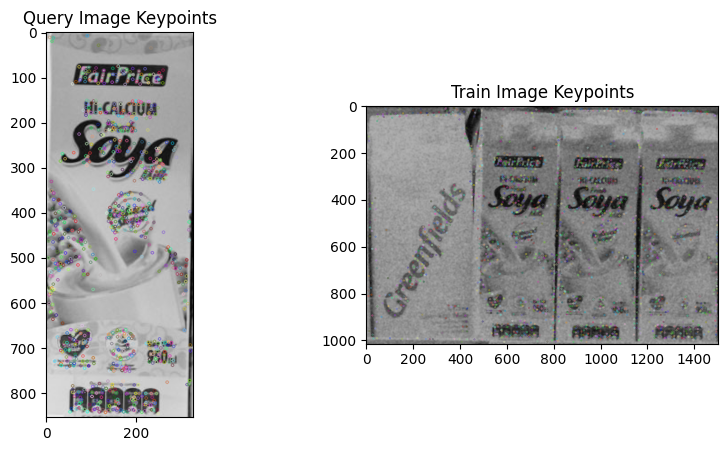

Keypoint coordinates for clustering: [[   9.99029827  808.80377197]
 [  10.20858765  786.05352783]
 [  11.0478096   723.45562744]
 ...
 [1498.2409668   394.1350708 ]
 [1498.48693848  796.53625488]
 [1499.14440918  441.73553467]]
Estimated bandwidth: 227.21650086100175
number of estimated clusters : 6
cluster 0
length 14
cluster 1
length 87
cluster 2
length 54
cluster 3
length 81
cluster 4
length 18
cluster 5
length 58
Product dataset/models/ref17.png in dataset/scenes/scene8_filtered.png:True


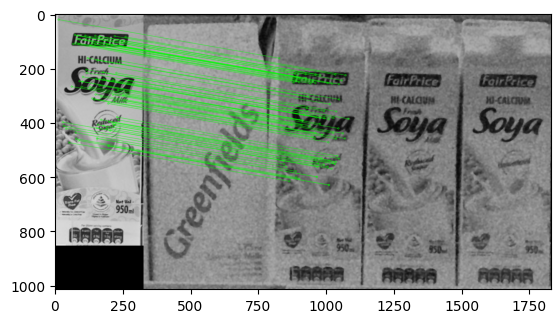

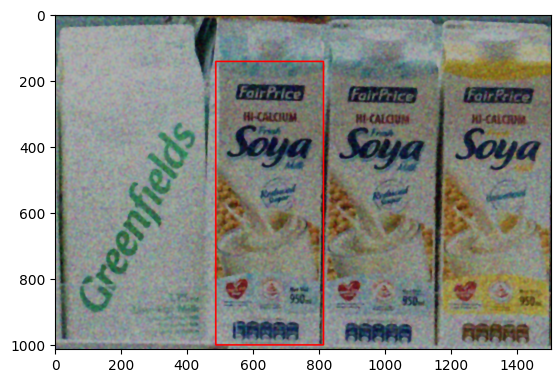

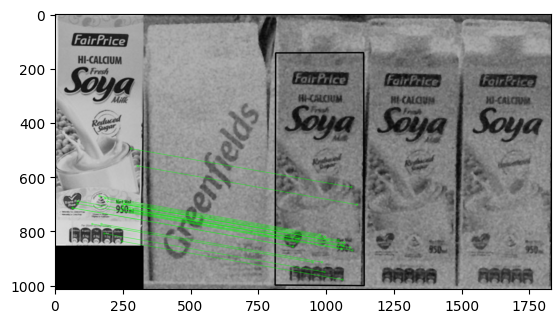

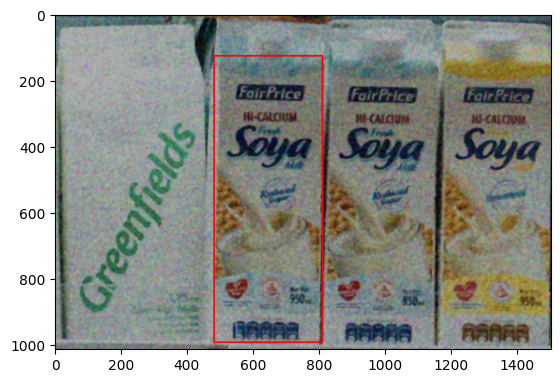

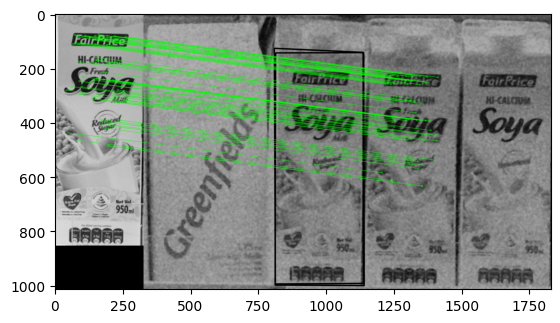

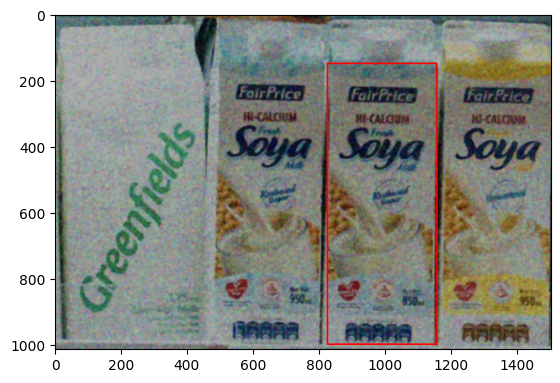

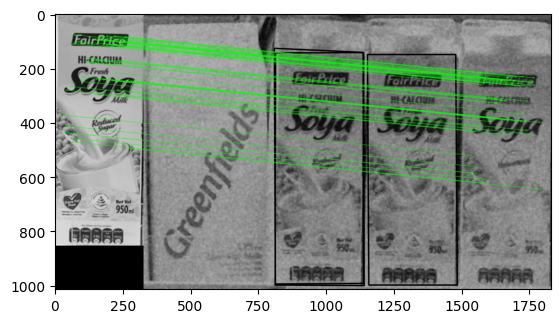

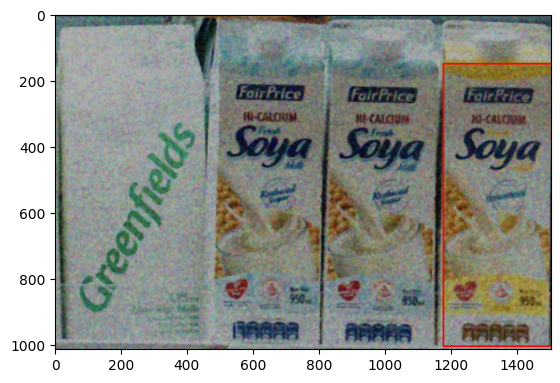

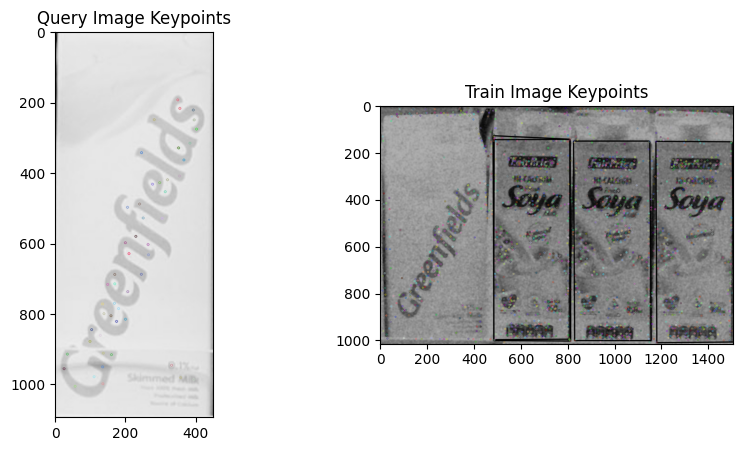

Keypoint coordinates for clustering: [[   9.99029827  808.80377197]
 [  10.20858765  786.05352783]
 [  11.0478096   723.45562744]
 ...
 [1497.77062988  393.89358521]
 [1498.17858887  956.87329102]
 [1498.48693848  796.53625488]]
Estimated bandwidth: 228.6161528909526
number of estimated clusters : 7
cluster 0
length 18
cluster 1
length 18
cluster 2
length 0
cluster 3
length 0
cluster 4
length 0
cluster 5
length 0
cluster 6
length 0
Product dataset/models/ref18.png in dataset/scenes/scene8_filtered.png:False


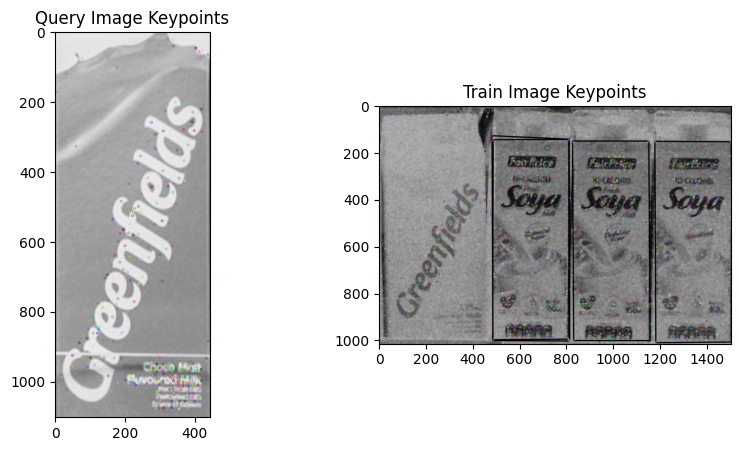

Keypoint coordinates for clustering: [[   9.99029827  808.80377197]
 [  10.20858765  786.05352783]
 [  11.0478096   723.45562744]
 ...
 [1497.77062988  393.89358521]
 [1498.17858887  956.87329102]
 [1498.48693848  796.53625488]]
Estimated bandwidth: 228.6161528909526
number of estimated clusters : 7
cluster 0
length 1
cluster 1
length 0
cluster 2
length 3
cluster 3
length 2
cluster 4
length 4
cluster 5
length 0
cluster 6
length 5
Product dataset/models/ref19.png in dataset/scenes/scene8_filtered.png:False


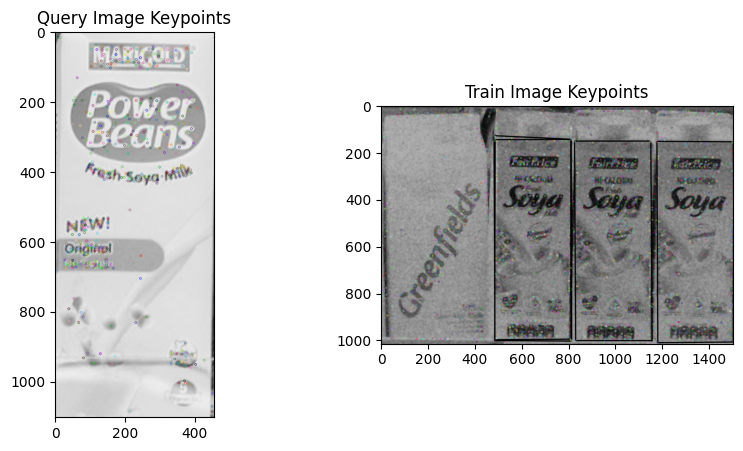

Keypoint coordinates for clustering: [[   9.99029827  808.80377197]
 [  10.20858765  786.05352783]
 [  11.0478096   723.45562744]
 ...
 [1497.77062988  393.89358521]
 [1498.17858887  956.87329102]
 [1498.48693848  796.53625488]]
Estimated bandwidth: 228.6161528909526
number of estimated clusters : 7
cluster 0
length 1
cluster 1
length 9
cluster 2
length 3
cluster 3
length 0
cluster 4
length 4
cluster 5
length 2
cluster 6
length 7
Product dataset/models/ref20.png in dataset/scenes/scene8_filtered.png:False


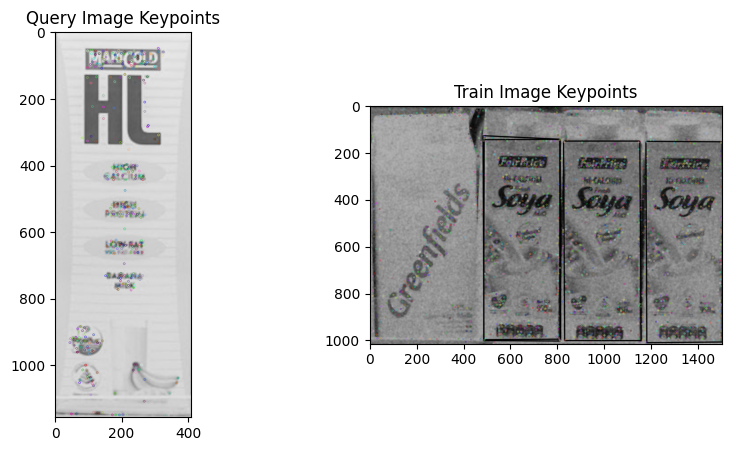

Keypoint coordinates for clustering: [[   9.99029827  808.80377197]
 [  10.20858765  786.05352783]
 [  11.0478096   723.45562744]
 ...
 [1497.77062988  393.89358521]
 [1498.17858887  956.87329102]
 [1498.48693848  796.53625488]]
Estimated bandwidth: 228.6161528909526
number of estimated clusters : 7
cluster 0
length 4
cluster 1
length 1
cluster 2
length 6
cluster 3
length 4
cluster 4
length 6
cluster 5
length 7
cluster 6
length 7
Product dataset/models/ref21.png in dataset/scenes/scene8_filtered.png:False


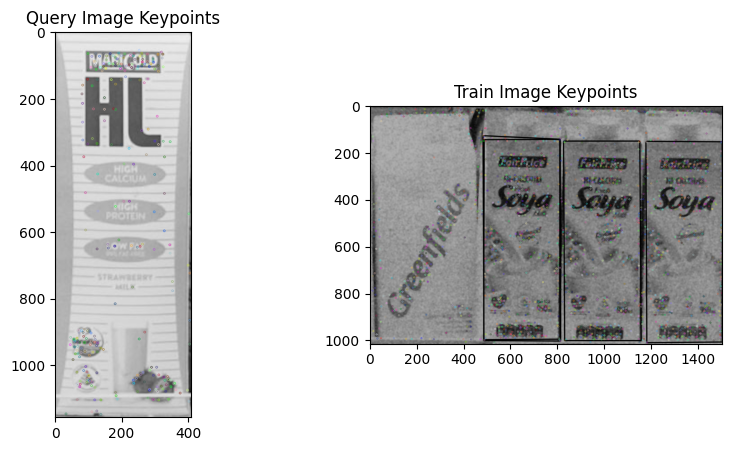

Keypoint coordinates for clustering: [[   9.99029827  808.80377197]
 [  10.20858765  786.05352783]
 [  11.0478096   723.45562744]
 ...
 [1497.77062988  393.89358521]
 [1498.17858887  956.87329102]
 [1498.48693848  796.53625488]]
Estimated bandwidth: 228.6161528909526
number of estimated clusters : 7
cluster 0
length 2
cluster 1
length 0
cluster 2
length 4
cluster 3
length 8
cluster 4
length 7
cluster 5
length 4
cluster 6
length 5
Product dataset/models/ref22.png in dataset/scenes/scene8_filtered.png:False


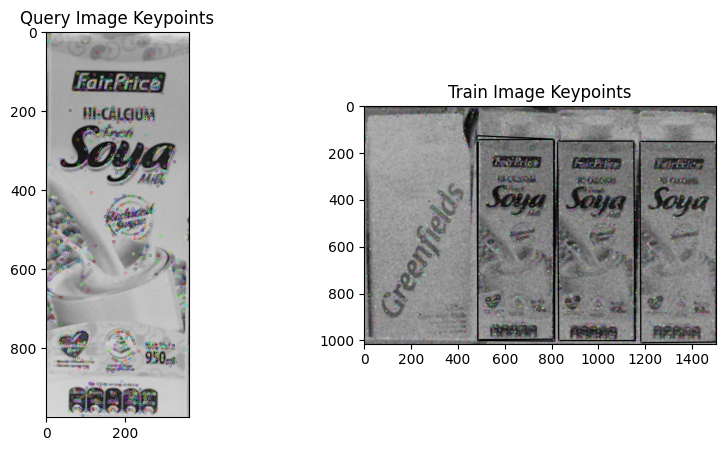

Keypoint coordinates for clustering: [[   9.99029827  808.80377197]
 [  10.20858765  786.05352783]
 [  11.0478096   723.45562744]
 ...
 [1497.77062988  393.89358521]
 [1498.17858887  956.87329102]
 [1498.48693848  796.53625488]]
Estimated bandwidth: 228.6161528909526
number of estimated clusters : 7
cluster 0
length 5
cluster 1
length 24
cluster 2
length 89
cluster 3
length 18
cluster 4
length 81
cluster 5
length 36
cluster 6
length 65
Product dataset/models/ref23.png in dataset/scenes/scene8_filtered.png:True


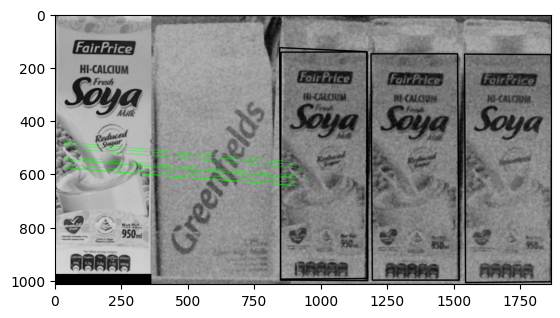

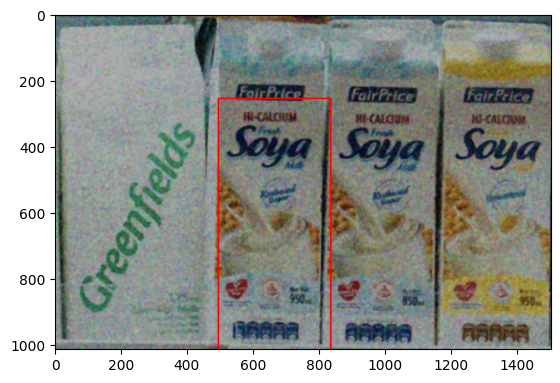

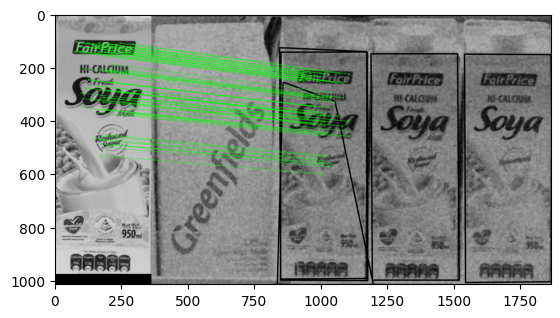

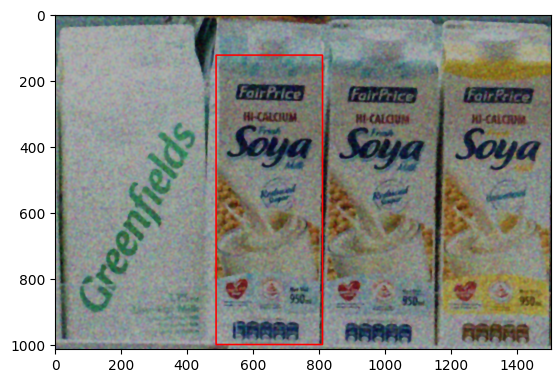

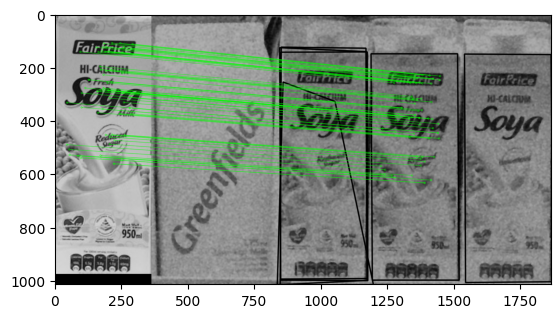

...

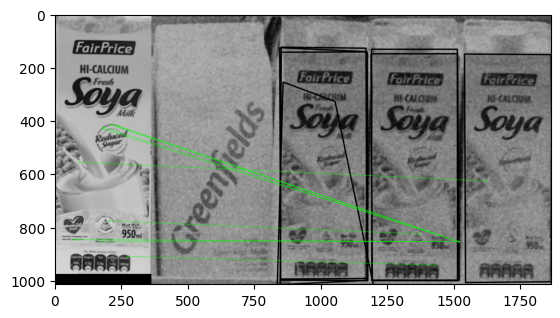

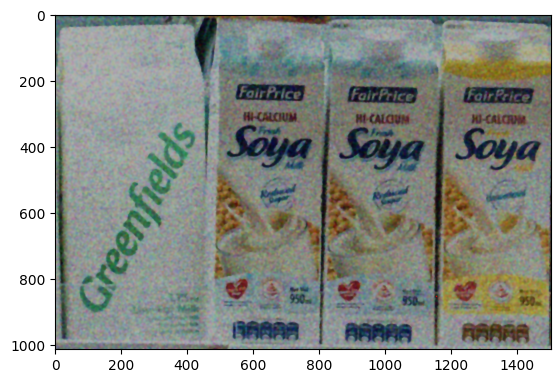

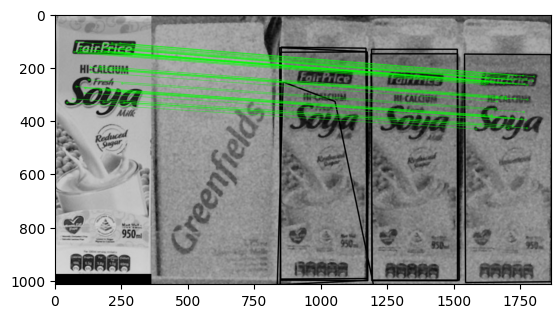

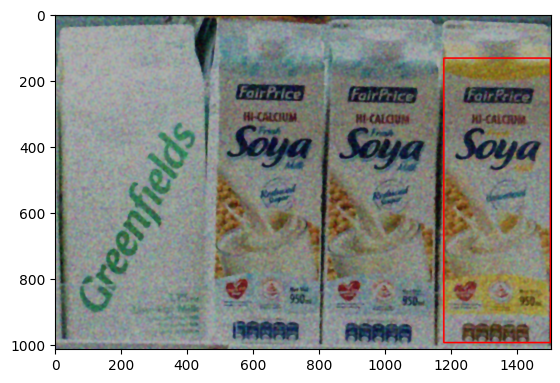

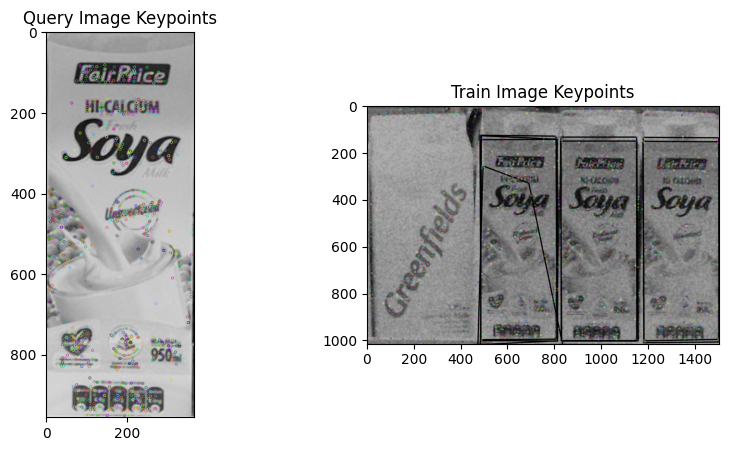

Keypoint coordinates for clustering: [[   9.99029827  808.80377197]
 [  10.20858765  786.05352783]
 [  11.0478096   723.45562744]
 ...
 [1496.66760254  993.94903564]
 [1496.73522949  151.60484314]
 [1496.80041504  135.88549805]]
Estimated bandwidth: 230.4141532756808
number of estimated clusters : 7
cluster 0
length 5
cluster 1
length 19
cluster 2
length 51
cluster 3
length 20
cluster 4
length 45
cluster 5
length 22
cluster 6
length 61
Product dataset/models/ref24.png in dataset/scenes/scene8_filtered.png:True


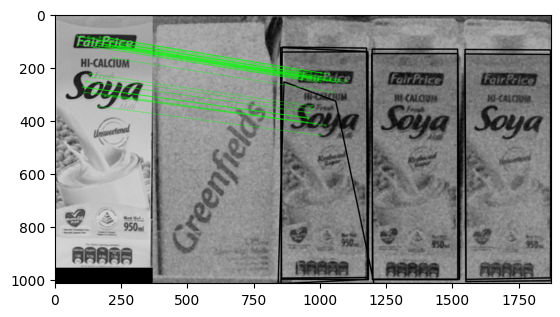

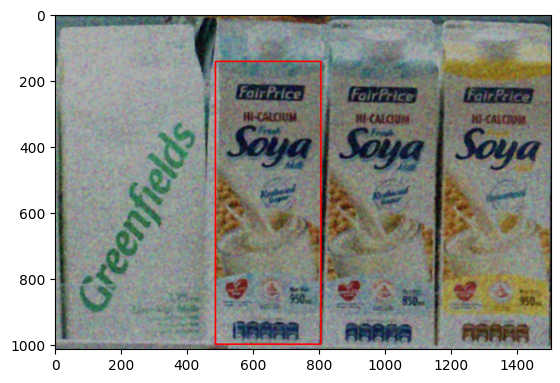

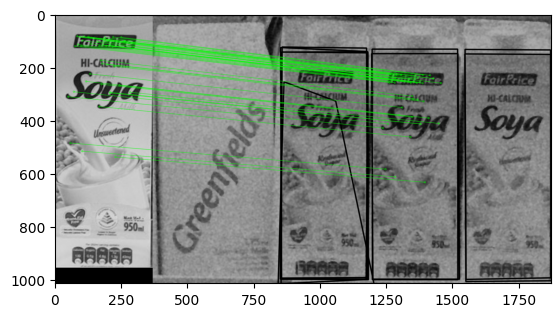

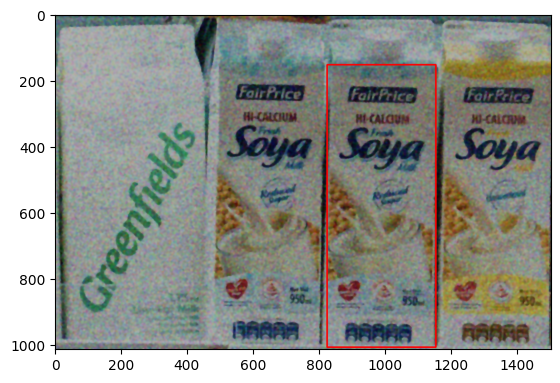

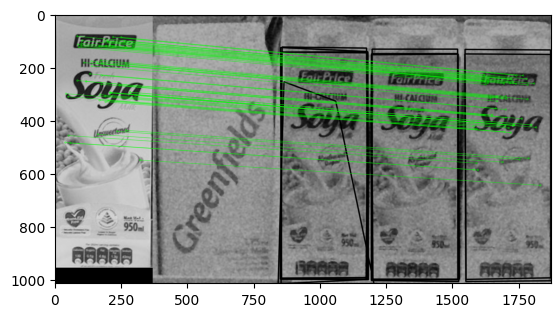

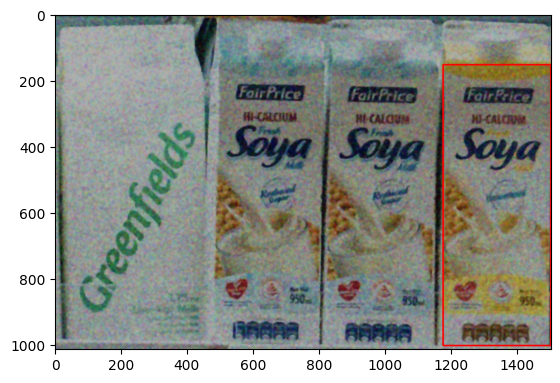

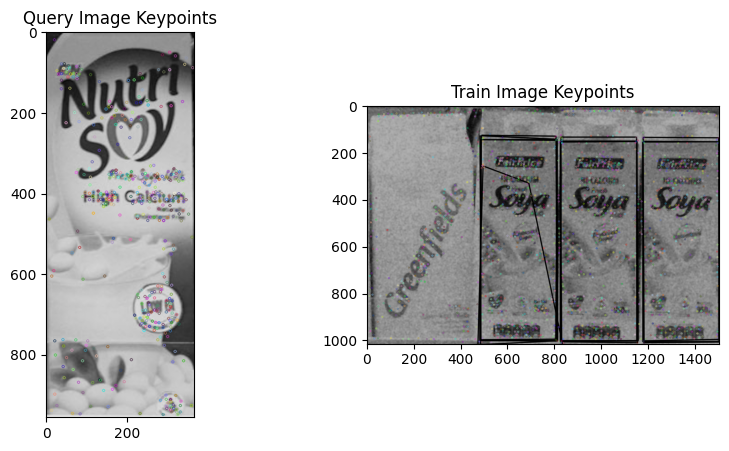

Keypoint coordinates for clustering: [[   9.99029827  808.80377197]
 [  10.20858765  786.05352783]
 [  11.0478096   723.45562744]
 ...
 [1493.87878418  765.90783691]
 [1496.59558105  151.63453674]
 [1496.80078125  135.88525391]]
Estimated bandwidth: 226.84116511311205
number of estimated clusters : 7
cluster 0
length 5
cluster 1
length 5
cluster 2
length 6
cluster 3
length 3
cluster 4
length 3
cluster 5
length 2
cluster 6
length 8
Product dataset/models/ref25.png in dataset/scenes/scene8_filtered.png:False


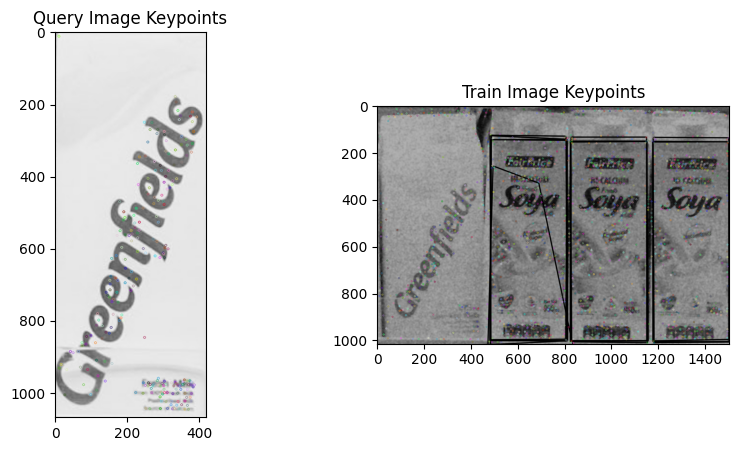

Keypoint coordinates for clustering: [[   9.99029827  808.80377197]
 [  10.20858765  786.05352783]
 [  11.0478096   723.45562744]
 ...
 [1493.87878418  765.90783691]
 [1496.59558105  151.63453674]
 [1496.80078125  135.88525391]]
Estimated bandwidth: 226.84116511311205
number of estimated clusters : 7
cluster 0
length 24
cluster 1
length 35
cluster 2
length 3
cluster 3
length 1
cluster 4
length 11
cluster 5
length 3
cluster 6
length 10
Product dataset/models/ref26.png in dataset/scenes/scene8_filtered.png:True


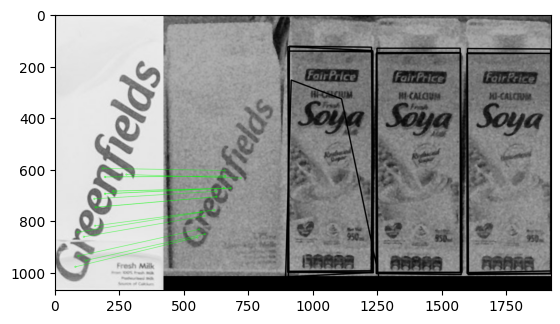

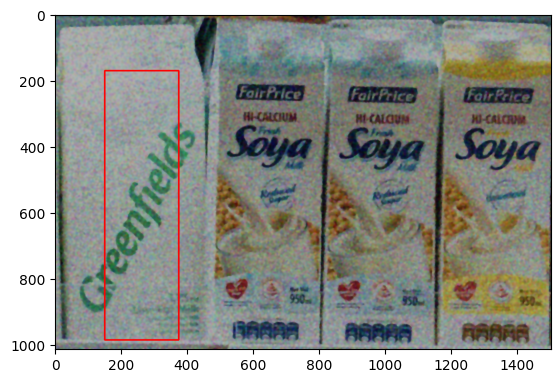

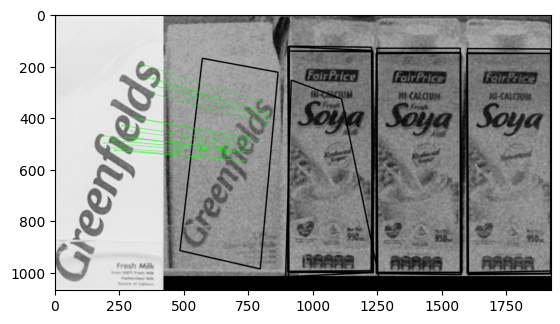

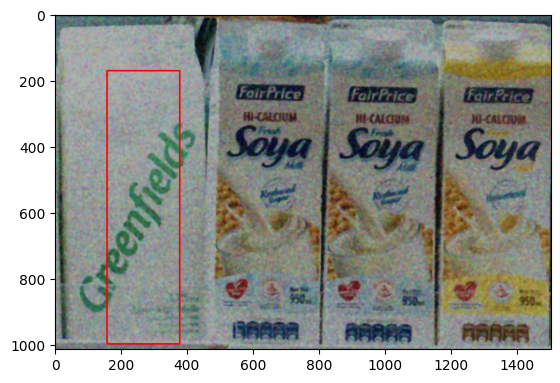

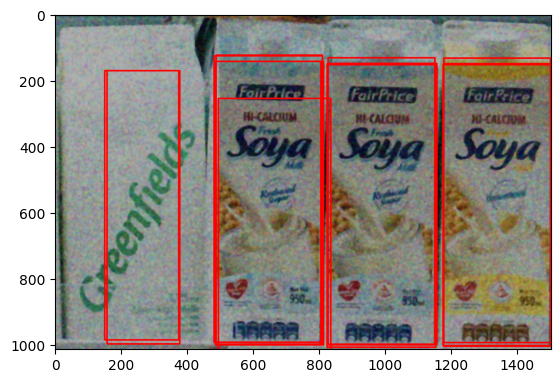

Object 17: 1 instance found, Height=858.4500122070312, Width=326.2200012207031, Center=(649.761474609375, 572.3222045898438)
Object 17: 1 instance found, Height=867.2100219726562, Width=327.9800109863281, Center=(645.7103271484375, 560.2930908203125)
Object 17: 1 instance found, Height=849.3800048828125, Width=331.4599914550781, Center=(989.8223876953125, 574.5811767578125)
Object 17: 1 instance found, Height=854.1599731445312, Width=334.2699890136719, Center=(1342.569091796875, 577.9881591796875)
Object 23: 1 instance found, Height=765.72998046875, Width=340.5899963378906, Center=(664.4423828125, 638.5523071289062)
Object 23: 1 instance found, Height=875.719970703125, Width=321.5899963378906, Center=(648.5254516601562, 562.537353515625)
Object 23: 1 instance found, Height=868.6599731445312, Width=322.8399963378906, Center=(987.9774169921875, 567.258056640625)
Object 23: 1 instance found, Height=0.4699999988079071, Width=0.23000000417232513, Center=(1154.421142578125, 854.533935546875)

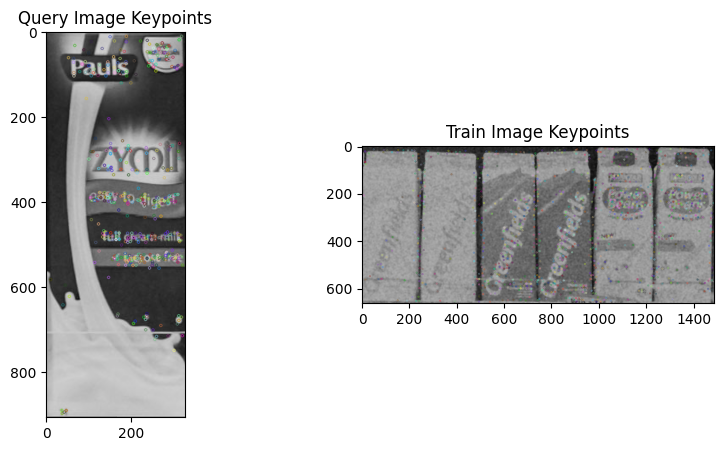

Keypoint coordinates for clustering: [[   5.3801899   220.03869629]
 [   7.0125761   207.73434448]
 [   7.76566172   76.00505066]
 ...
 [1478.56311035  361.43951416]
 [1479.28088379  299.57955933]
 [1480.84912109  239.90478516]]
Estimated bandwidth: 186.10319211229765
number of estimated clusters : 5
cluster 0
length 1
cluster 1
length 1
cluster 2
length 8
cluster 3
length 3
cluster 4
length 5
Product dataset/models/ref15.png in dataset/scenes/scene9_filtered.png:False


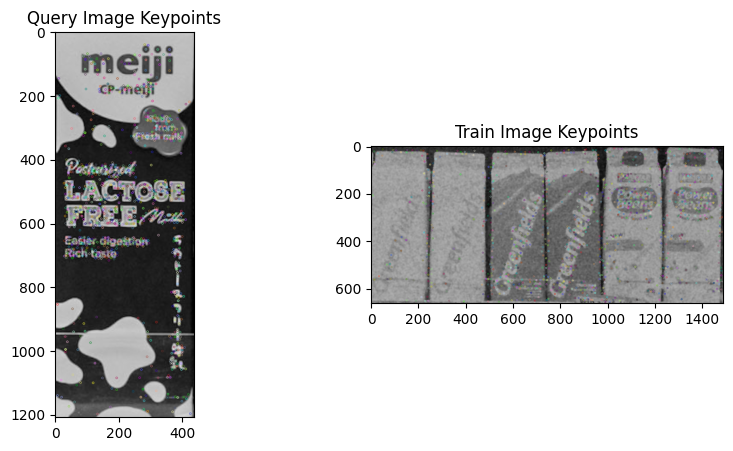

Keypoint coordinates for clustering: [[   5.3801899   220.03869629]
 [   7.0125761   207.73434448]
 [   7.76566172   76.00505066]
 ...
 [1478.56311035  361.43951416]
 [1479.28088379  299.57955933]
 [1480.84912109  239.90478516]]
Estimated bandwidth: 186.10319211229765
number of estimated clusters : 5
cluster 0
length 3
cluster 1
length 5
cluster 2
length 7
cluster 3
length 3
cluster 4
length 20
Product dataset/models/ref16.png in dataset/scenes/scene9_filtered.png:False


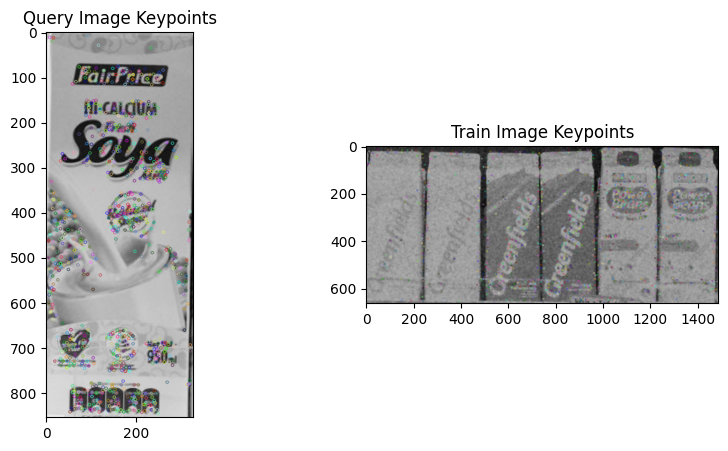

Keypoint coordinates for clustering: [[   5.3801899   220.03869629]
 [   7.0125761   207.73434448]
 [   7.76566172   76.00505066]
 ...
 [1478.56311035  361.43951416]
 [1479.28088379  299.57955933]
 [1480.84912109  239.90478516]]
Estimated bandwidth: 186.10319211229765
number of estimated clusters : 5
cluster 0
length 2
cluster 1
length 0
cluster 2
length 7
cluster 3
length 1
cluster 4
length 9
Product dataset/models/ref17.png in dataset/scenes/scene9_filtered.png:False


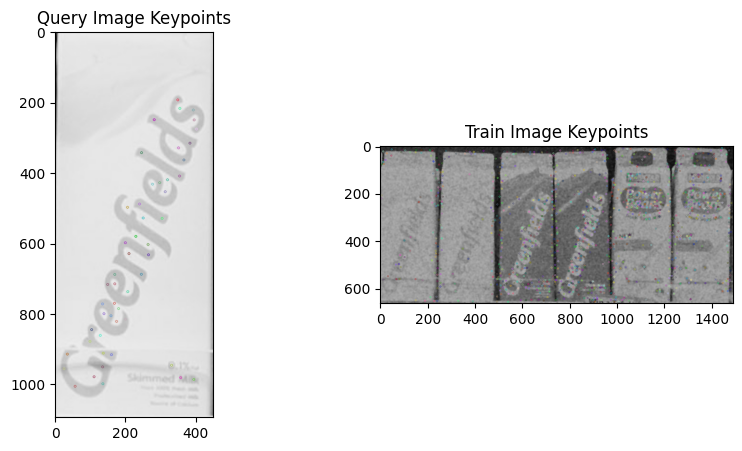

Keypoint coordinates for clustering: [[   5.3801899   220.03869629]
 [   7.0125761   207.73434448]
 [   7.76566172   76.00505066]
 ...
 [1478.56311035  361.43951416]
 [1479.28088379  299.57955933]
 [1480.84912109  239.90478516]]
Estimated bandwidth: 186.10319211229765
number of estimated clusters : 5
cluster 0
length 3
cluster 1
length 0
cluster 2
length 0
cluster 3
length 0
cluster 4
length 0
Product dataset/models/ref18.png in dataset/scenes/scene9_filtered.png:False


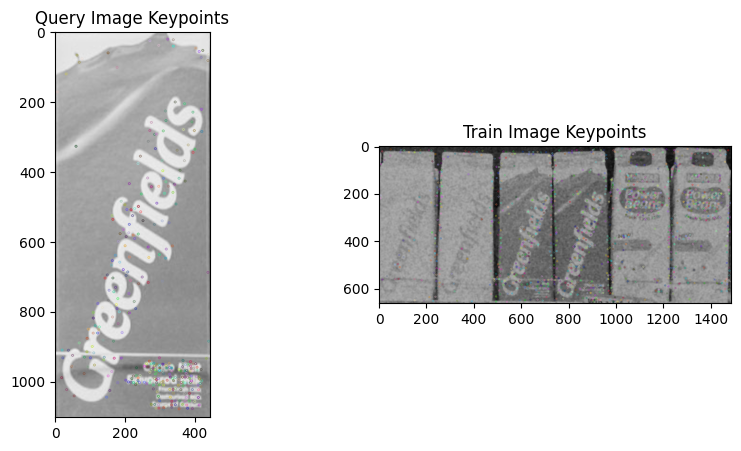

Keypoint coordinates for clustering: [[   5.3801899   220.03869629]
 [   7.0125761   207.73434448]
 [   7.76566172   76.00505066]
 ...
 [1478.56311035  361.43951416]
 [1479.28088379  299.57955933]
 [1480.84912109  239.90478516]]
Estimated bandwidth: 186.10319211229765
number of estimated clusters : 5
cluster 0
length 0
cluster 1
length 3
cluster 2
length 43
cluster 3
length 0
cluster 4
length 9
Product dataset/models/ref19.png in dataset/scenes/scene9_filtered.png:True


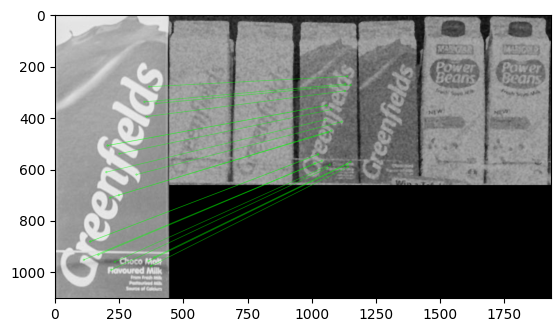

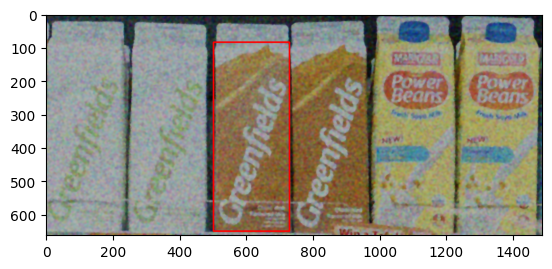

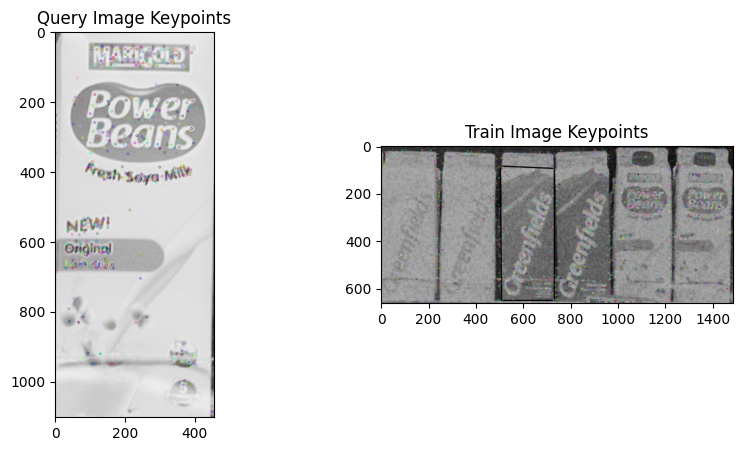

Keypoint coordinates for clustering: [[   5.3801899   220.03869629]
 [   7.0125761   207.73434448]
 [   7.76566172   76.00505066]
 ...
 [1478.56311035  361.43951416]
 [1479.28088379  299.57955933]
 [1480.84912109  239.90478516]]
Estimated bandwidth: 184.91053385679683
number of estimated clusters : 5
cluster 0
length 4
cluster 1
length 3
cluster 2
length 3
cluster 3
length 6
cluster 4
length 22
Product dataset/models/ref20.png in dataset/scenes/scene9_filtered.png:False


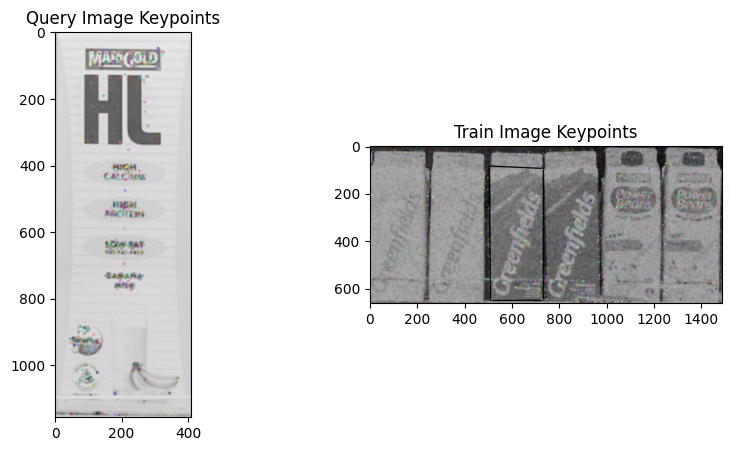

Keypoint coordinates for clustering: [[   5.3801899   220.03869629]
 [   7.0125761   207.73434448]
 [   7.76566172   76.00505066]
 ...
 [1478.56311035  361.43951416]
 [1479.28088379  299.57955933]
 [1480.84912109  239.90478516]]
Estimated bandwidth: 184.91053385679683
number of estimated clusters : 5
cluster 0
length 3
cluster 1
length 3
cluster 2
length 4
cluster 3
length 5
cluster 4
length 7
Product dataset/models/ref21.png in dataset/scenes/scene9_filtered.png:False


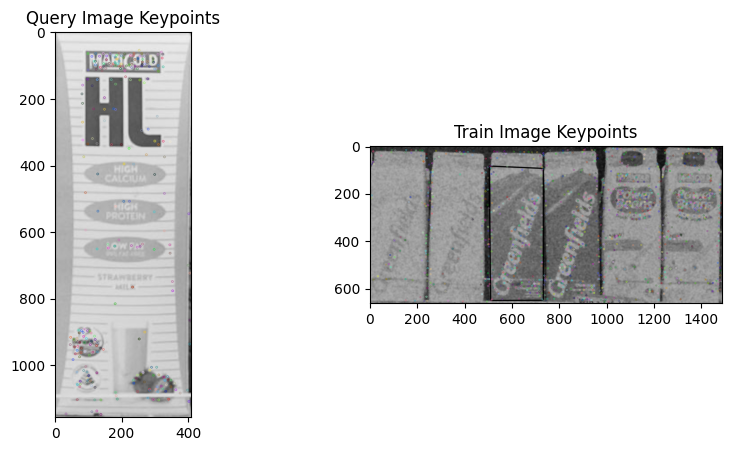

Keypoint coordinates for clustering: [[   5.3801899   220.03869629]
 [   7.0125761   207.73434448]
 [   7.76566172   76.00505066]
 ...
 [1478.56311035  361.43951416]
 [1479.28088379  299.57955933]
 [1480.84912109  239.90478516]]
Estimated bandwidth: 184.91053385679683
number of estimated clusters : 5
cluster 0
length 3
cluster 1
length 1
cluster 2
length 1
cluster 3
length 1
cluster 4
length 3
Product dataset/models/ref22.png in dataset/scenes/scene9_filtered.png:False


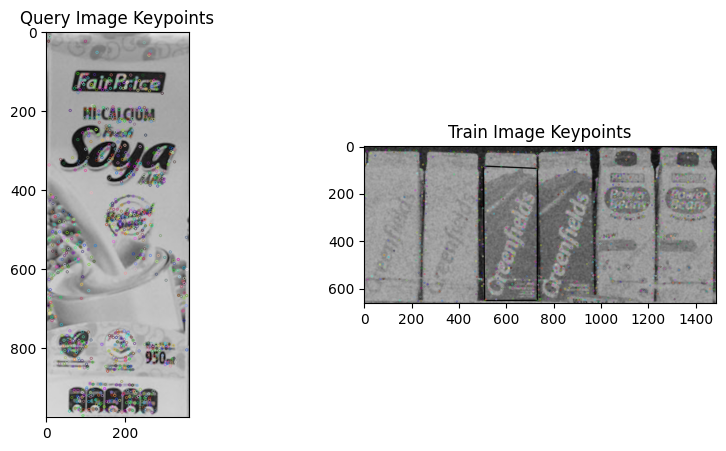

Keypoint coordinates for clustering: [[   5.3801899   220.03869629]
 [   7.0125761   207.73434448]
 [   7.76566172   76.00505066]
 ...
 [1478.56311035  361.43951416]
 [1479.28088379  299.57955933]
 [1480.84912109  239.90478516]]
Estimated bandwidth: 184.91053385679683
number of estimated clusters : 5
cluster 0
length 1
cluster 1
length 3
cluster 2
length 6
cluster 3
length 1
cluster 4
length 3
Product dataset/models/ref23.png in dataset/scenes/scene9_filtered.png:False


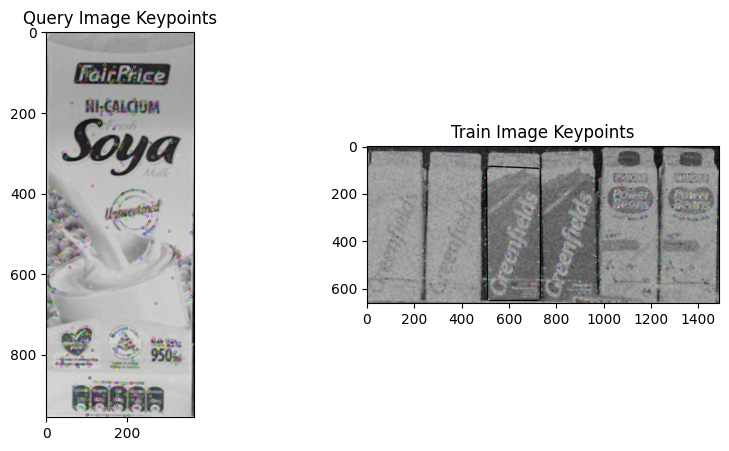

Keypoint coordinates for clustering: [[   5.3801899   220.03869629]
 [   7.0125761   207.73434448]
 [   7.76566172   76.00505066]
 ...
 [1478.56311035  361.43951416]
 [1479.28088379  299.57955933]
 [1480.84912109  239.90478516]]
Estimated bandwidth: 184.91053385679683
number of estimated clusters : 5
cluster 0
length 2
cluster 1
length 0
cluster 2
length 3
cluster 3
length 3
cluster 4
length 6
Product dataset/models/ref24.png in dataset/scenes/scene9_filtered.png:False


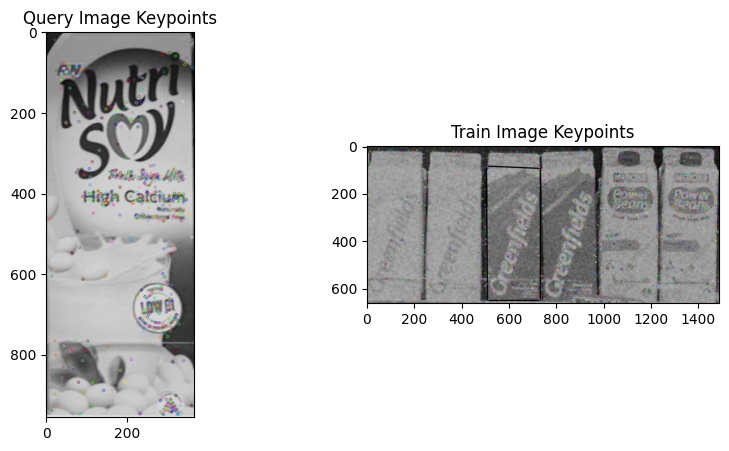

Keypoint coordinates for clustering: [[   5.3801899   220.03869629]
 [   7.0125761   207.73434448]
 [   7.76566172   76.00505066]
 ...
 [1478.56311035  361.43951416]
 [1479.28088379  299.57955933]
 [1480.84912109  239.90478516]]
Estimated bandwidth: 184.91053385679683
number of estimated clusters : 5
cluster 0
length 0
cluster 1
length 2
cluster 2
length 1
cluster 3
length 2
cluster 4
length 1
Product dataset/models/ref25.png in dataset/scenes/scene9_filtered.png:False


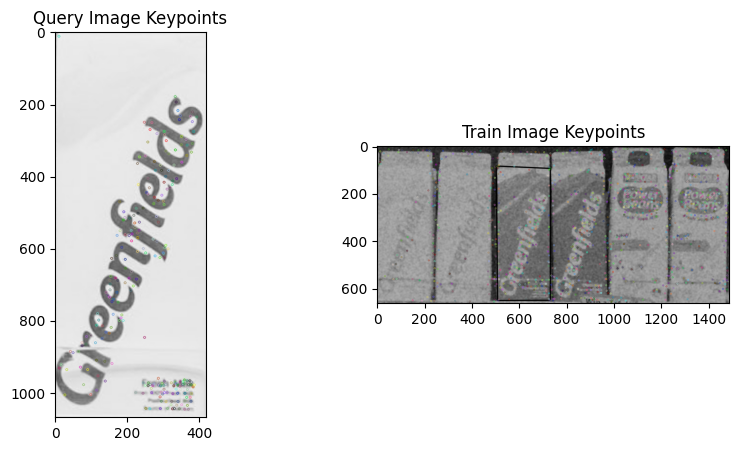

Keypoint coordinates for clustering: [[   5.3801899   220.03869629]
 [   7.0125761   207.73434448]
 [   7.76566172   76.00505066]
 ...
 [1478.56311035  361.43951416]
 [1479.28088379  299.57955933]
 [1480.84912109  239.90478516]]
Estimated bandwidth: 184.91053385679683
number of estimated clusters : 5
cluster 0
length 4
cluster 1
length 1
cluster 2
length 1
cluster 3
length 4
cluster 4
length 5
Product dataset/models/ref26.png in dataset/scenes/scene9_filtered.png:False


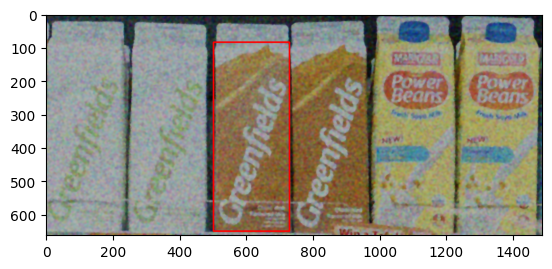

Object 19: 1 instance found, Height=566.2999877929688, Width=228.64999389648438, Center=(616.354248046875, 367.7019348144531)
[[146 146 146 ... 125 126 127]
 [146 147 147 ... 125 126 127]
 [149 149 149 ... 125 128 128]
 ...
 [146 146 148 ... 156 157 158]
 [145 146 148 ... 156 158 158]
 [145 145 147 ... 156 158 158]]


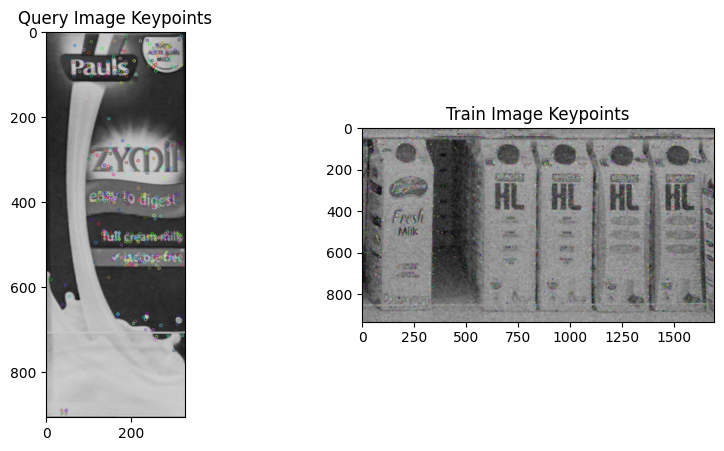

Keypoint coordinates for clustering: [[  10.15707779  473.39956665]
 [  11.0526247   459.17614746]
 [  11.22494411  363.9190979 ]
 ...
 [1687.4666748    50.36067963]
 [1687.4666748    50.36067963]
 [1687.99316406  276.24035645]]
Estimated bandwidth: 238.7771502116972
number of estimated clusters : 6
cluster 0
length 2
cluster 1
length 4
cluster 2
length 2
cluster 3
length 9
cluster 4
length 6
cluster 5
length 1
Product dataset/models/ref15.png in dataset/scenes/scene10_filtered.png:False


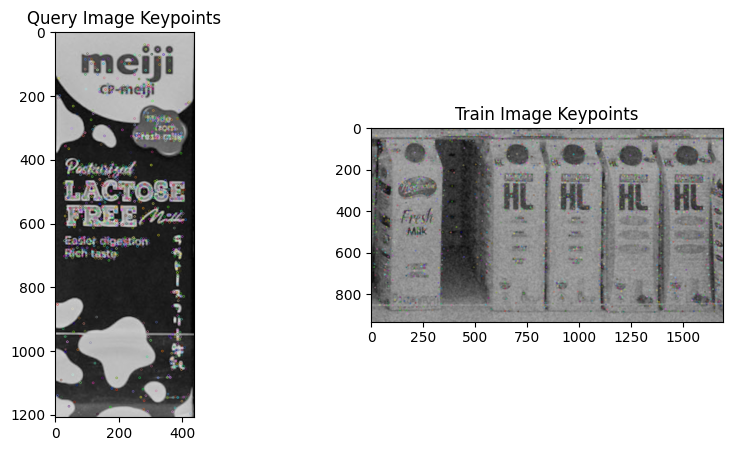

Keypoint coordinates for clustering: [[  10.15707779  473.39956665]
 [  11.0526247   459.17614746]
 [  11.22494411  363.9190979 ]
 ...
 [1687.4666748    50.36067963]
 [1687.4666748    50.36067963]
 [1687.99316406  276.24035645]]
Estimated bandwidth: 238.7771502116972
number of estimated clusters : 6
cluster 0
length 14
cluster 1
length 19
cluster 2
length 2
cluster 3
length 17
cluster 4
length 17
cluster 5
length 2
Product dataset/models/ref16.png in dataset/scenes/scene10_filtered.png:False


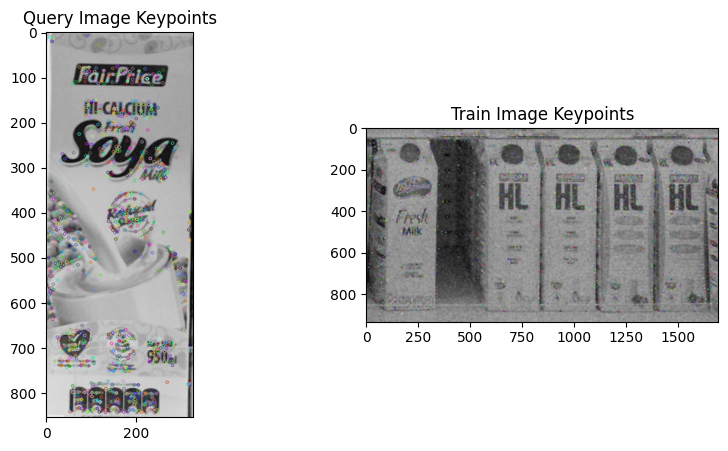

Keypoint coordinates for clustering: [[  10.15707779  473.39956665]
 [  11.0526247   459.17614746]
 [  11.22494411  363.9190979 ]
 ...
 [1687.4666748    50.36067963]
 [1687.4666748    50.36067963]
 [1687.99316406  276.24035645]]
Estimated bandwidth: 238.7771502116972
number of estimated clusters : 6
cluster 0
length 9
cluster 1
length 9
cluster 2
length 3
cluster 3
length 7
cluster 4
length 9
cluster 5
length 1
Product dataset/models/ref17.png in dataset/scenes/scene10_filtered.png:False


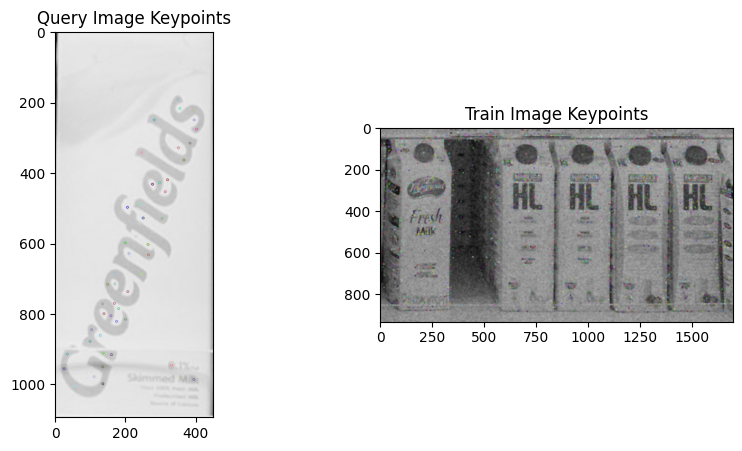

Keypoint coordinates for clustering: [[  10.15707779  473.39956665]
 [  11.0526247   459.17614746]
 [  11.22494411  363.9190979 ]
 ...
 [1687.4666748    50.36067963]
 [1687.4666748    50.36067963]
 [1687.99316406  276.24035645]]
Estimated bandwidth: 238.7771502116972
number of estimated clusters : 6
cluster 0
length 1
cluster 1
length 0
cluster 2
length 1
cluster 3
length 0
cluster 4
length 0
cluster 5
length 1
Product dataset/models/ref18.png in dataset/scenes/scene10_filtered.png:False


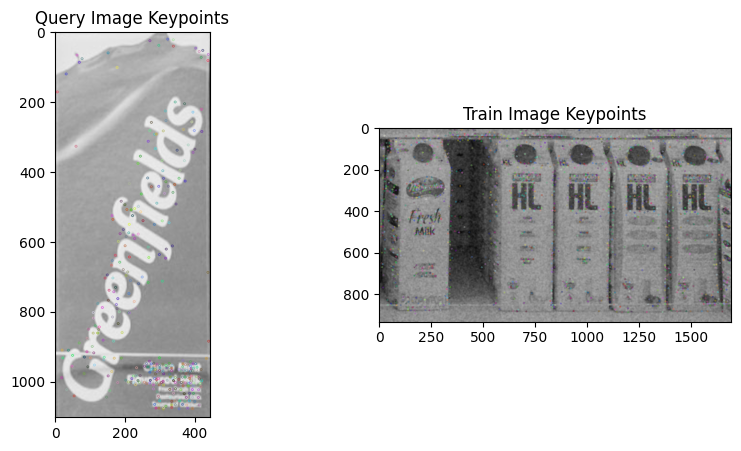

Keypoint coordinates for clustering: [[  10.15707779  473.39956665]
 [  11.0526247   459.17614746]
 [  11.22494411  363.9190979 ]
 ...
 [1687.4666748    50.36067963]
 [1687.4666748    50.36067963]
 [1687.99316406  276.24035645]]
Estimated bandwidth: 238.7771502116972
number of estimated clusters : 6
cluster 0
length 8
cluster 1
length 6
cluster 2
length 1
cluster 3
length 5
cluster 4
length 7
cluster 5
length 0
Product dataset/models/ref19.png in dataset/scenes/scene10_filtered.png:False


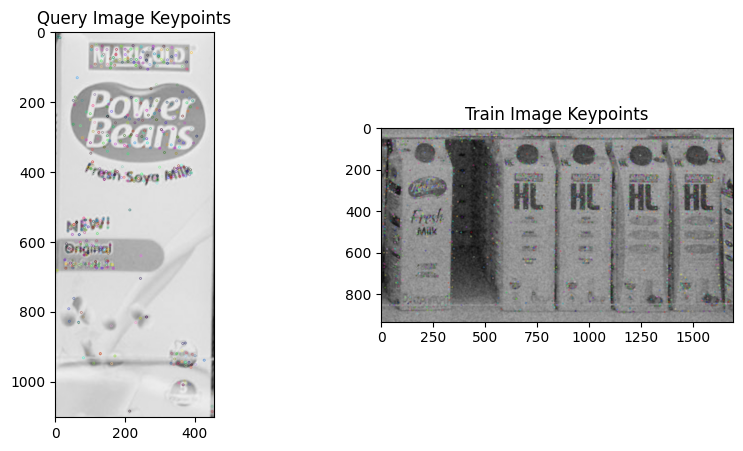

Keypoint coordinates for clustering: [[  10.15707779  473.39956665]
 [  11.0526247   459.17614746]
 [  11.22494411  363.9190979 ]
 ...
 [1687.4666748    50.36067963]
 [1687.4666748    50.36067963]
 [1687.99316406  276.24035645]]
Estimated bandwidth: 238.7771502116972
number of estimated clusters : 6
cluster 0
length 16
cluster 1
length 4
cluster 2
length 1
cluster 3
length 5
cluster 4
length 7
cluster 5
length 2
Product dataset/models/ref20.png in dataset/scenes/scene10_filtered.png:False


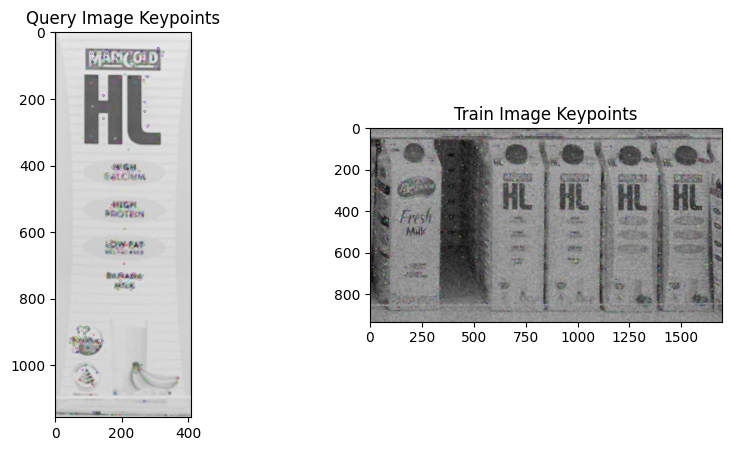

Keypoint coordinates for clustering: [[  10.15707779  473.39956665]
 [  11.0526247   459.17614746]
 [  11.22494411  363.9190979 ]
 ...
 [1687.4666748    50.36067963]
 [1687.4666748    50.36067963]
 [1687.99316406  276.24035645]]
Estimated bandwidth: 238.7771502116972
number of estimated clusters : 6
cluster 0
length 3
cluster 1
length 29
cluster 2
length 8
cluster 3
length 31
cluster 4
length 29
cluster 5
length 3
Product dataset/models/ref21.png in dataset/scenes/scene10_filtered.png:True


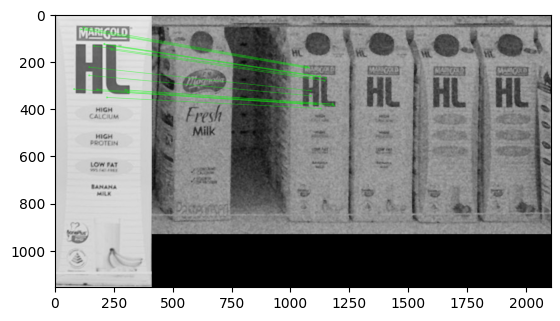

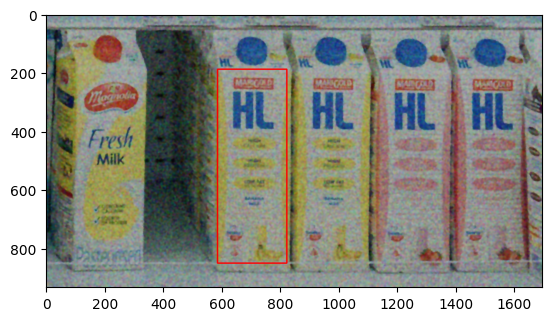

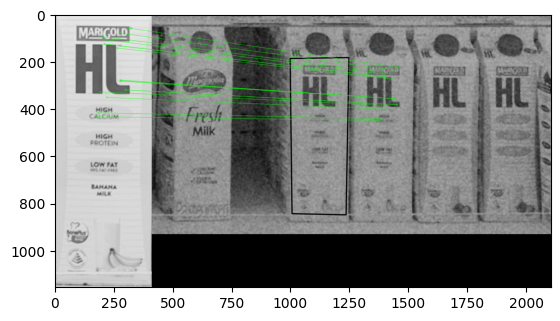

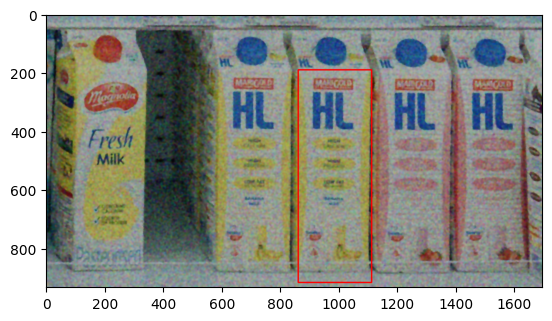

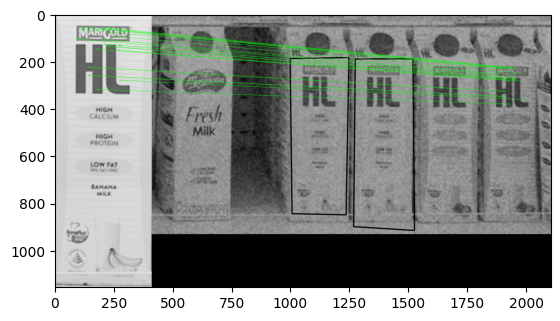

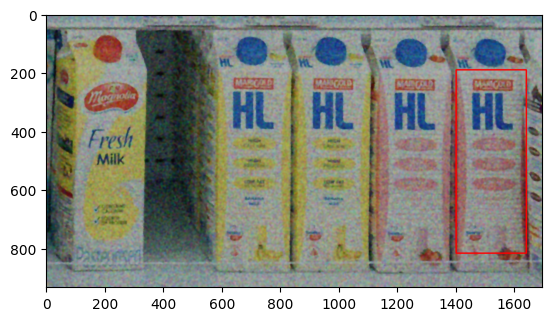

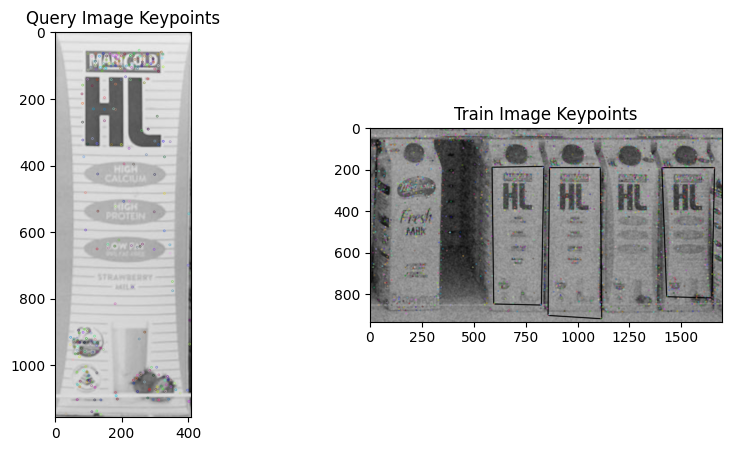

Keypoint coordinates for clustering: [[  10.15707779  473.39956665]
 [  11.0526247   459.17614746]
 [  11.22494411  363.9190979 ]
 ...
 [1687.4666748    50.36067963]
 [1687.4666748    50.36067963]
 [1687.99316406  276.24035645]]
Estimated bandwidth: 239.93526264657976
number of estimated clusters : 6
cluster 0
length 2
cluster 1
length 3
cluster 2
length 20
cluster 3
length 6
cluster 4
length 21
cluster 5
length 5
Product dataset/models/ref22.png in dataset/scenes/scene10_filtered.png:False


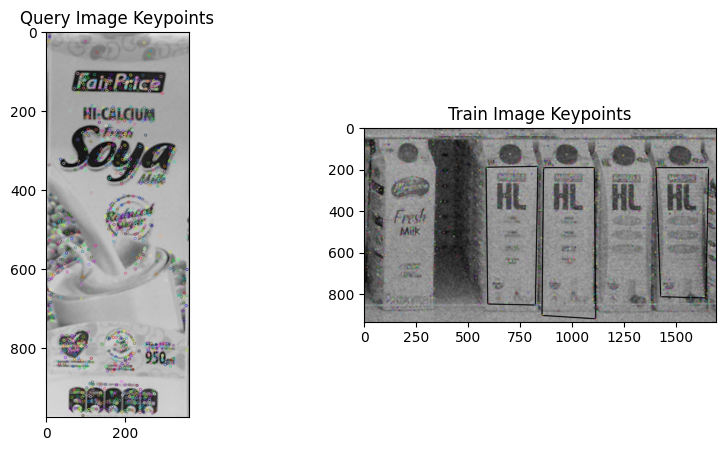

Keypoint coordinates for clustering: [[  10.15707779  473.39956665]
 [  11.0526247   459.17614746]
 [  11.22494411  363.9190979 ]
 ...
 [1687.4666748    50.36067963]
 [1687.4666748    50.36067963]
 [1687.99316406  276.24035645]]
Estimated bandwidth: 239.93526264657976
number of estimated clusters : 6
cluster 0
length 7
cluster 1
length 6
cluster 2
length 9
cluster 3
length 9
cluster 4
length 6
cluster 5
length 4
Product dataset/models/ref23.png in dataset/scenes/scene10_filtered.png:False


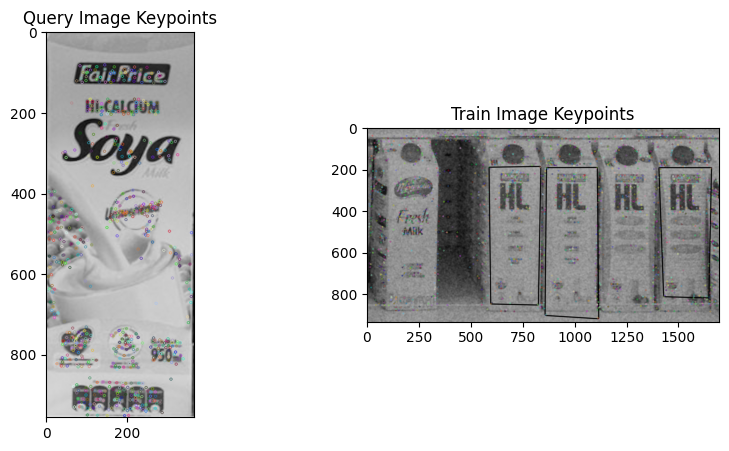

Keypoint coordinates for clustering: [[  10.15707779  473.39956665]
 [  11.0526247   459.17614746]
 [  11.22494411  363.9190979 ]
 ...
 [1687.4666748    50.36067963]
 [1687.4666748    50.36067963]
 [1687.99316406  276.24035645]]
Estimated bandwidth: 239.93526264657976
number of estimated clusters : 6
cluster 0
length 7
cluster 1
length 10
cluster 2
length 5
cluster 3
length 2
cluster 4
length 5
cluster 5
length 5
Product dataset/models/ref24.png in dataset/scenes/scene10_filtered.png:False


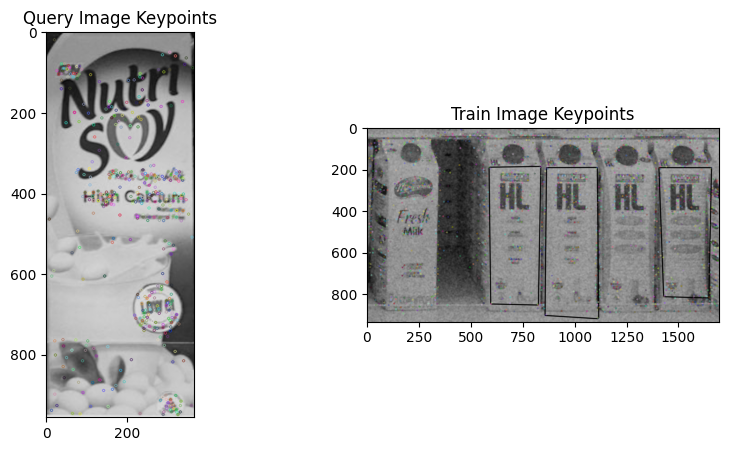

Keypoint coordinates for clustering: [[  10.15707779  473.39956665]
 [  11.0526247   459.17614746]
 [  11.22494411  363.9190979 ]
 ...
 [1687.4666748    50.36067963]
 [1687.4666748    50.36067963]
 [1687.99316406  276.24035645]]
Estimated bandwidth: 239.93526264657976
number of estimated clusters : 6
cluster 0
length 3
cluster 1
length 8
cluster 2
length 3
cluster 3
length 1
cluster 4
length 4
cluster 5
length 4
Product dataset/models/ref25.png in dataset/scenes/scene10_filtered.png:False


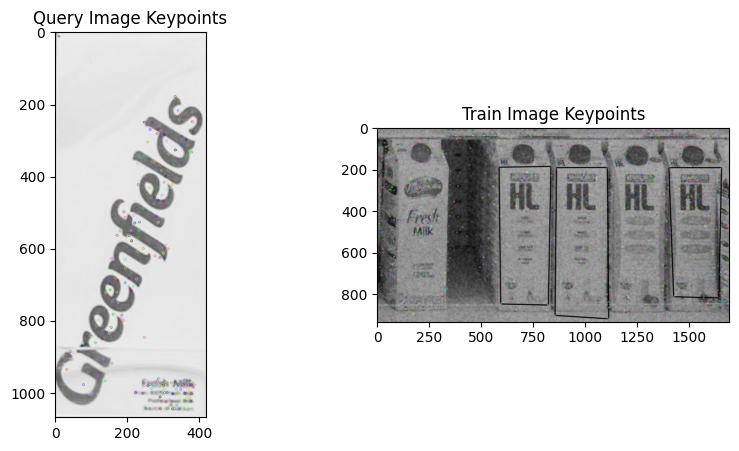

Keypoint coordinates for clustering: [[  10.15707779  473.39956665]
 [  11.0526247   459.17614746]
 [  11.22494411  363.9190979 ]
 ...
 [1687.4666748    50.36067963]
 [1687.4666748    50.36067963]
 [1687.99316406  276.24035645]]
Estimated bandwidth: 239.93526264657976
number of estimated clusters : 6
cluster 0
length 1
cluster 1
length 5
cluster 2
length 3
cluster 3
length 1
cluster 4
length 5
cluster 5
length 0
Product dataset/models/ref26.png in dataset/scenes/scene10_filtered.png:False


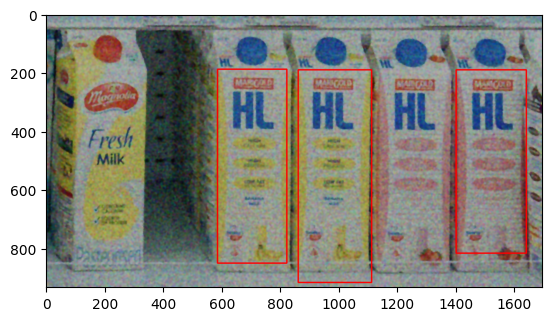

Object 21: 1 instance found, Height=661.77001953125, Width=236.86000061035156, Center=(704.911376953125, 519.8694458007812)
Object 21: 1 instance found, Height=726.0900268554688, Width=251.25999450683594, Center=(987.95068359375, 553.9450073242188)
Object 21: 1 instance found, Height=625.7000122070312, Width=240.6999969482422, Center=(1522.39599609375, 503.5851135253906)
[[ 86  86  90 ...  77  73  72]
 [ 86  86  89 ...  77  73  73]
 [ 84  85  87 ...  80  76  74]
 ...
 [157 157 154 ... 141 140 140]
 [158 158 156 ... 142 139 138]
 [159 158 155 ... 141 139 138]]


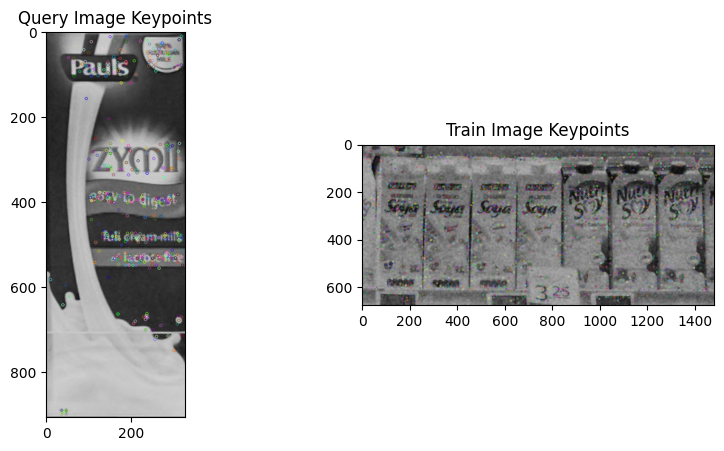

Keypoint coordinates for clustering: [[   7.0004921   308.06069946]
 [   7.0004921   308.06069946]
 [   7.43314791  237.19734192]
 ...
 [1468.19396973  565.01843262]
 [1469.71813965  135.83992004]
 [1474.7421875   228.30581665]]
Estimated bandwidth: 193.0111937966425
number of estimated clusters : 8
cluster 0
length 2
cluster 1
length 3
cluster 2
length 1
cluster 3
length 1
cluster 4
length 5
cluster 5
length 0
cluster 6
length 1
cluster 7
length 2
Product dataset/models/ref15.png in dataset/scenes/scene11_filtered.png:False


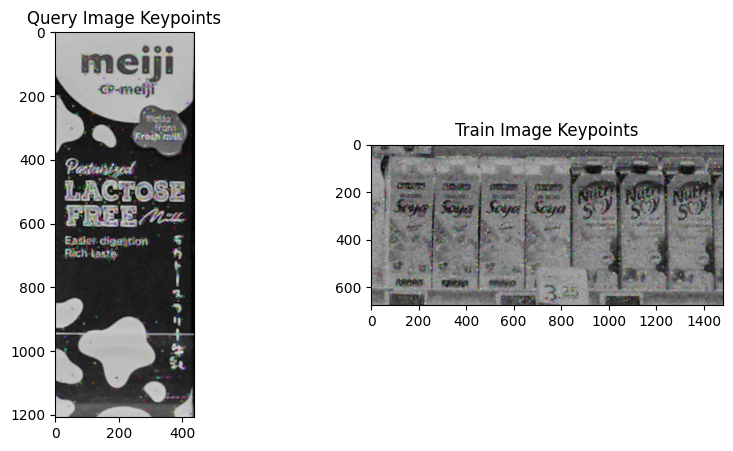

Keypoint coordinates for clustering: [[   7.0004921   308.06069946]
 [   7.0004921   308.06069946]
 [   7.43314791  237.19734192]
 ...
 [1468.19396973  565.01843262]
 [1469.71813965  135.83992004]
 [1474.7421875   228.30581665]]
Estimated bandwidth: 193.0111937966425
number of estimated clusters : 8
cluster 0
length 8
cluster 1
length 2
cluster 2
length 1
cluster 3
length 5
cluster 4
length 13
cluster 5
length 3
cluster 6
length 15
cluster 7
length 4
Product dataset/models/ref16.png in dataset/scenes/scene11_filtered.png:False


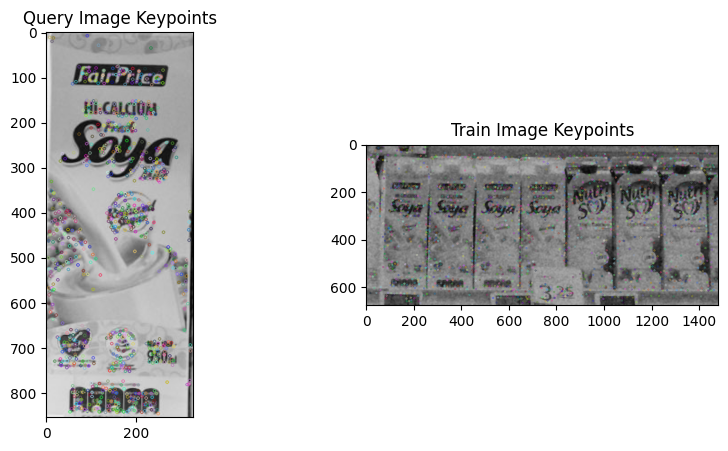

Keypoint coordinates for clustering: [[   7.0004921   308.06069946]
 [   7.0004921   308.06069946]
 [   7.43314791  237.19734192]
 ...
 [1468.19396973  565.01843262]
 [1469.71813965  135.83992004]
 [1474.7421875   228.30581665]]
Estimated bandwidth: 193.0111937966425
number of estimated clusters : 8
cluster 0
length 15
cluster 1
length 34
cluster 2
length 19
cluster 3
length 22
cluster 4
length 23
cluster 5
length 7
cluster 6
length 5
cluster 7
length 1
Product dataset/models/ref17.png in dataset/scenes/scene11_filtered.png:True


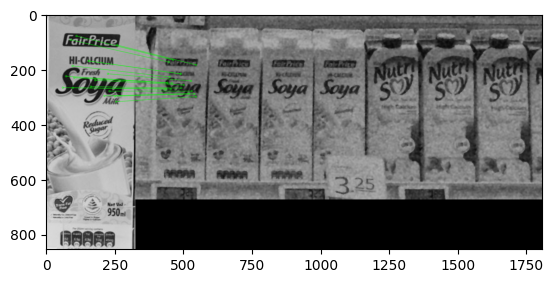

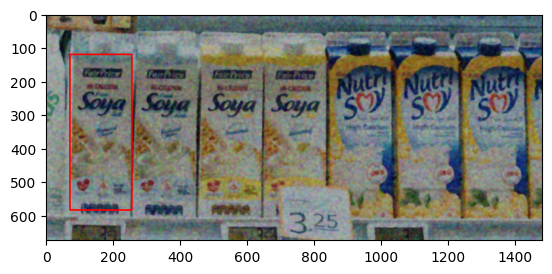

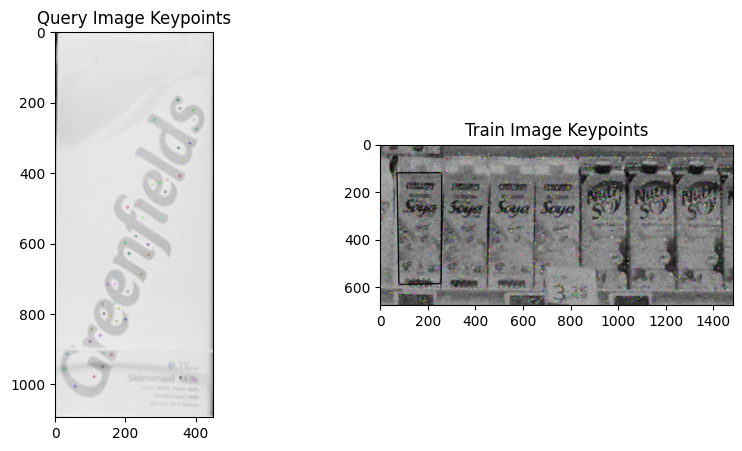

Keypoint coordinates for clustering: [[   7.0004921   308.06069946]
 [   7.0004921   308.06069946]
 [   7.43314791  237.19734192]
 ...
 [1468.19396973  565.01843262]
 [1469.71813965  135.83992004]
 [1474.7421875   228.30581665]]
Estimated bandwidth: 191.2472312036533
number of estimated clusters : 8
cluster 0
length 2
cluster 1
length 1
cluster 2
length 0
cluster 3
length 1
cluster 4
length 2
cluster 5
length 0
cluster 6
length 2
cluster 7
length 0
Product dataset/models/ref18.png in dataset/scenes/scene11_filtered.png:False


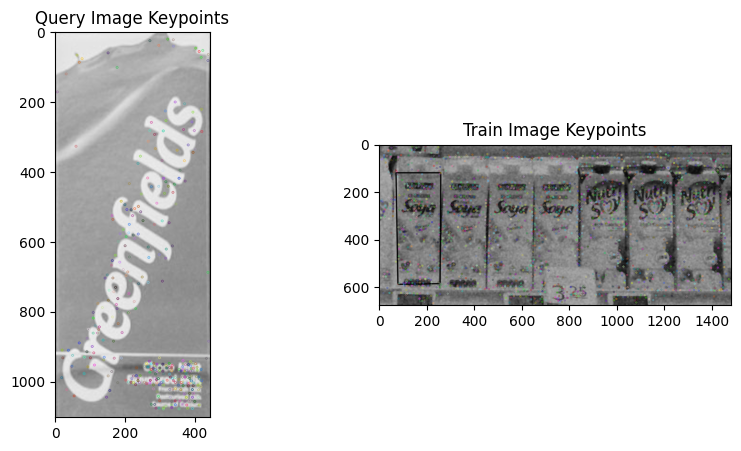

Keypoint coordinates for clustering: [[   7.0004921   308.06069946]
 [   7.0004921   308.06069946]
 [   7.43314791  237.19734192]
 ...
 [1468.19396973  565.01843262]
 [1469.71813965  135.83992004]
 [1474.7421875   228.30581665]]
Estimated bandwidth: 191.2472312036533
number of estimated clusters : 8
cluster 0
length 4
cluster 1
length 4
cluster 2
length 2
cluster 3
length 4
cluster 4
length 7
cluster 5
length 5
cluster 6
length 2
cluster 7
length 0
Product dataset/models/ref19.png in dataset/scenes/scene11_filtered.png:False


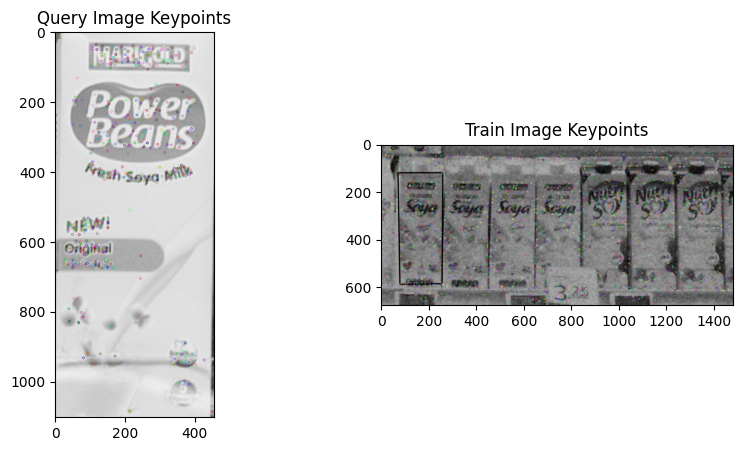

Keypoint coordinates for clustering: [[   7.0004921   308.06069946]
 [   7.0004921   308.06069946]
 [   7.43314791  237.19734192]
 ...
 [1468.19396973  565.01843262]
 [1469.71813965  135.83992004]
 [1474.7421875   228.30581665]]
Estimated bandwidth: 191.2472312036533
number of estimated clusters : 8
cluster 0
length 1
cluster 1
length 2
cluster 2
length 2
cluster 3
length 5
cluster 4
length 3
cluster 5
length 5
cluster 6
length 2
cluster 7
length 3
Product dataset/models/ref20.png in dataset/scenes/scene11_filtered.png:False


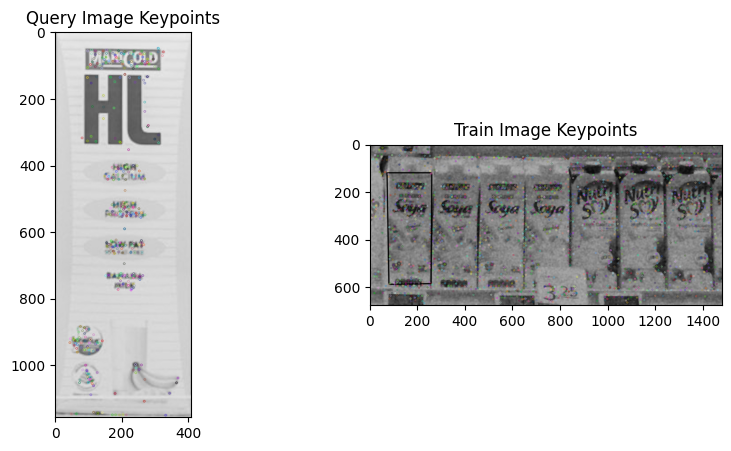

Keypoint coordinates for clustering: [[   7.0004921   308.06069946]
 [   7.0004921   308.06069946]
 [   7.43314791  237.19734192]
 ...
 [1468.19396973  565.01843262]
 [1469.71813965  135.83992004]
 [1474.7421875   228.30581665]]
Estimated bandwidth: 191.2472312036533
number of estimated clusters : 8
cluster 0
length 3
cluster 1
length 3
cluster 2
length 6
cluster 3
length 0
cluster 4
length 0
cluster 5
length 6
cluster 6
length 1
cluster 7
length 8
Product dataset/models/ref21.png in dataset/scenes/scene11_filtered.png:False


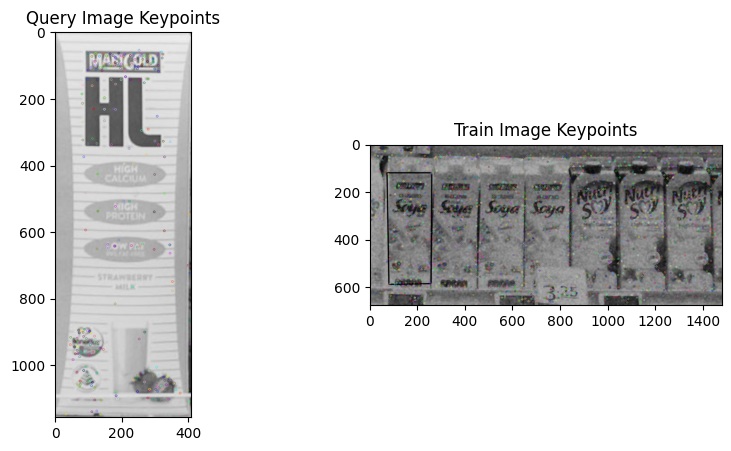

Keypoint coordinates for clustering: [[   7.0004921   308.06069946]
 [   7.0004921   308.06069946]
 [   7.43314791  237.19734192]
 ...
 [1468.19396973  565.01843262]
 [1469.71813965  135.83992004]
 [1474.7421875   228.30581665]]
Estimated bandwidth: 191.2472312036533
number of estimated clusters : 8
cluster 0
length 5
cluster 1
length 2
cluster 2
length 6
cluster 3
length 1
cluster 4
length 0
cluster 5
length 2
cluster 6
length 1
cluster 7
length 2
Product dataset/models/ref22.png in dataset/scenes/scene11_filtered.png:False


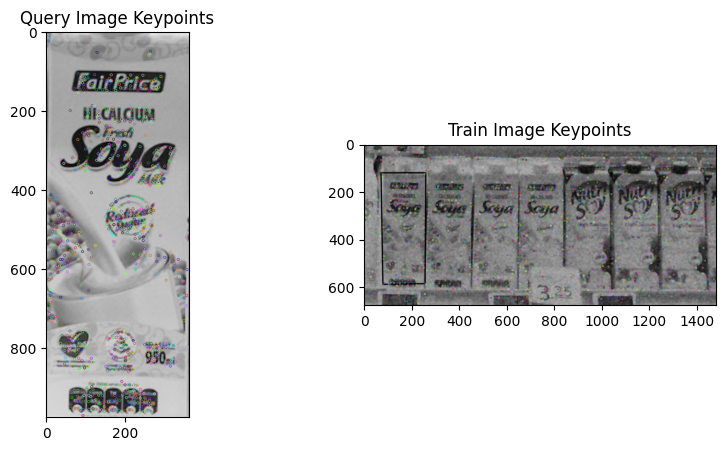

Keypoint coordinates for clustering: [[   7.0004921   308.06069946]
 [   7.0004921   308.06069946]
 [   7.43314791  237.19734192]
 ...
 [1468.19396973  565.01843262]
 [1469.71813965  135.83992004]
 [1474.7421875   228.30581665]]
Estimated bandwidth: 191.2472312036533
number of estimated clusters : 8
cluster 0
length 41
cluster 1
length 17
cluster 2
length 9
cluster 3
length 30
cluster 4
length 10
cluster 5
length 6
cluster 6
length 3
cluster 7
length 3
Product dataset/models/ref23.png in dataset/scenes/scene11_filtered.png:True


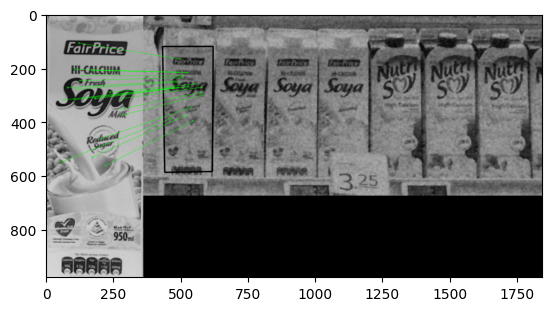

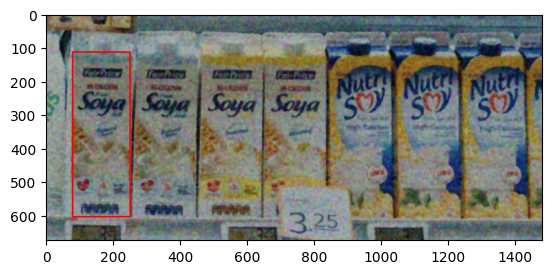

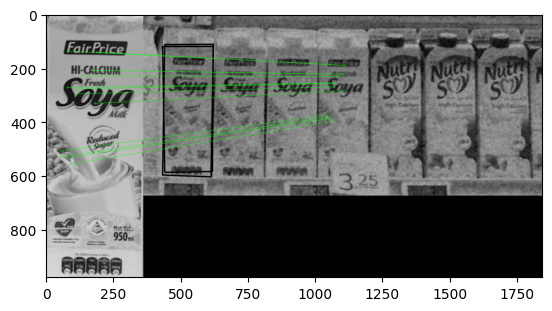

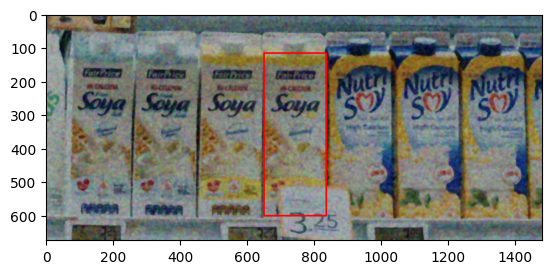

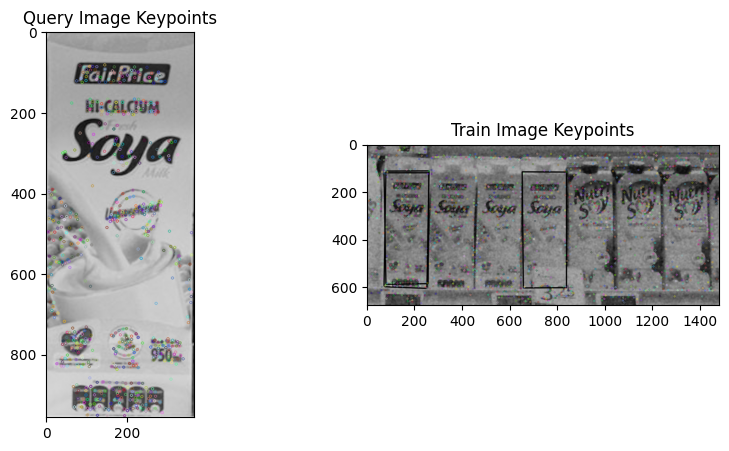

Keypoint coordinates for clustering: [[   7.0004921   308.06069946]
 [   7.0004921   308.06069946]
 [   7.43314791  237.19734192]
 ...
 [1468.19396973  565.01843262]
 [1469.71813965  135.83992004]
 [1474.7421875   228.30581665]]
Estimated bandwidth: 188.21328299118196
number of estimated clusters : 8
cluster 0
length 14
cluster 1
length 11
cluster 2
length 12
cluster 3
length 32
cluster 4
length 15
cluster 5
length 14
cluster 6
length 2
cluster 7
length 2
Product dataset/models/ref24.png in dataset/scenes/scene11_filtered.png:True


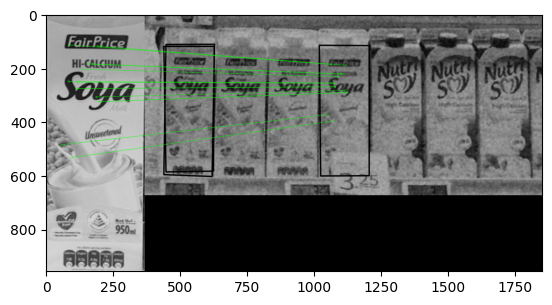

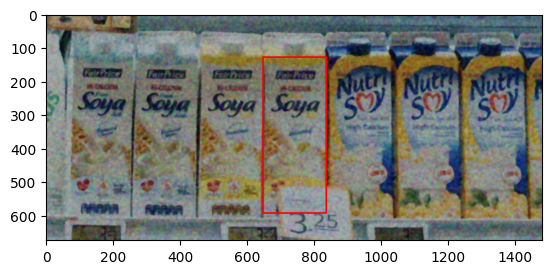

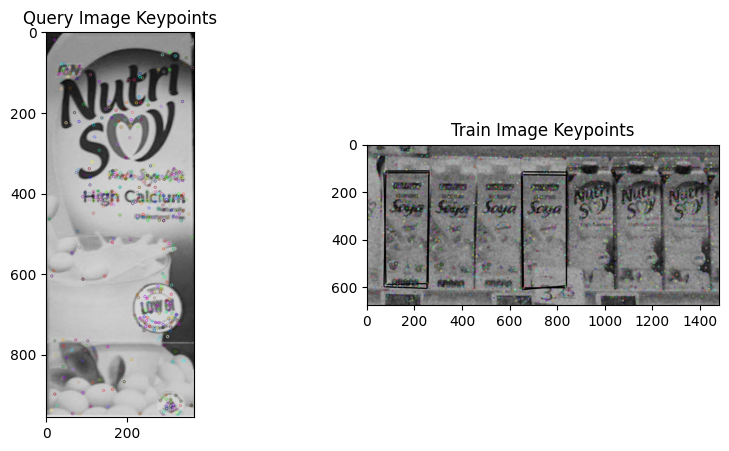

Keypoint coordinates for clustering: [[   7.0004921   308.06069946]
 [   7.0004921   308.06069946]
 [   7.43314791  237.19734192]
 ...
 [1468.19396973  565.01843262]
 [1469.71813965  135.83992004]
 [1474.7421875   228.30581665]]
Estimated bandwidth: 189.6626055927278
number of estimated clusters : 8
cluster 0
length 3
cluster 1
length 3
cluster 2
length 2
cluster 3
length 8
cluster 4
length 36
cluster 5
length 18
cluster 6
length 33
cluster 7
length 13
Product dataset/models/ref25.png in dataset/scenes/scene11_filtered.png:True


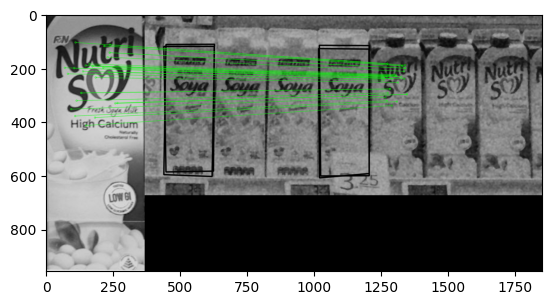

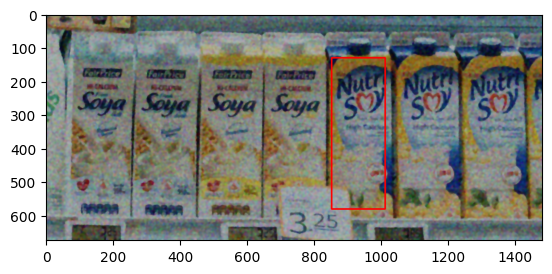

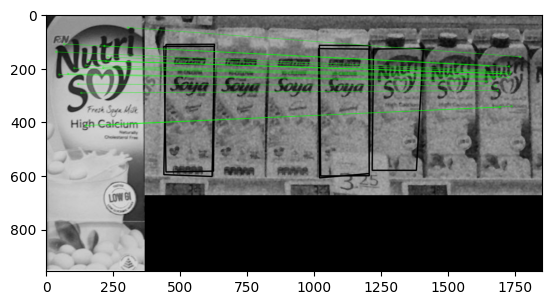

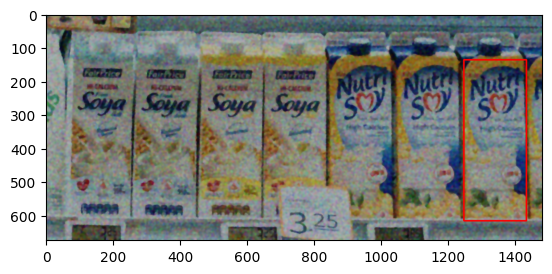

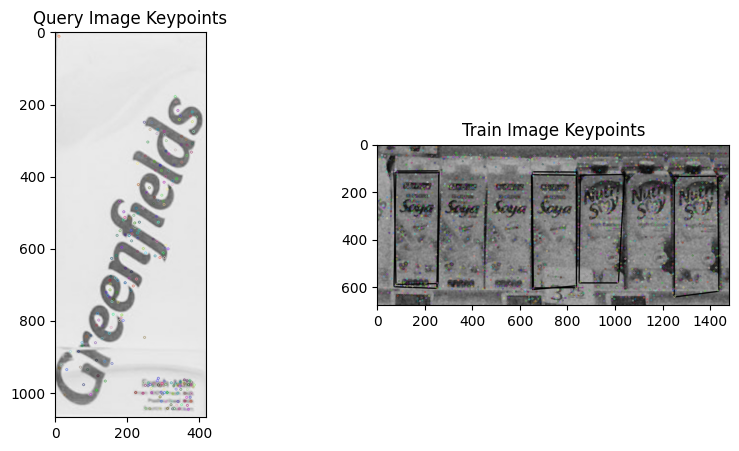

Keypoint coordinates for clustering: [[   7.0004921   308.06069946]
 [   7.0004921   308.06069946]
 [   7.43314791  237.19734192]
 ...
 [1468.15869141  565.02062988]
 [1469.71813965  135.83992004]
 [1474.7421875   228.30581665]]
Estimated bandwidth: 191.83288594644685
number of estimated clusters : 8
cluster 0
length 2
cluster 1
length 3
cluster 2
length 1
cluster 3
length 3
cluster 4
length 4
cluster 5
length 5
cluster 6
length 1
cluster 7
length 2
Product dataset/models/ref26.png in dataset/scenes/scene11_filtered.png:False


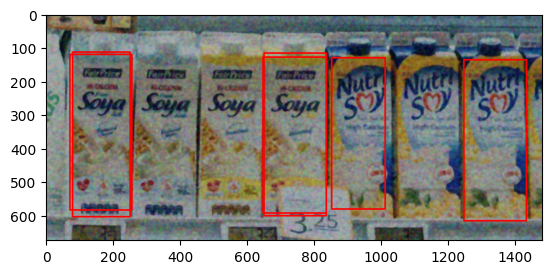

Object 17: 1 instance found, Height=464.17999267578125, Width=185.9499969482422, Center=(163.98324584960938, 352.1576843261719)
Object 23: 1 instance found, Height=491.0299987792969, Width=172.5399932861328, Center=(165.28468322753906, 358.53814697265625)
Object 23: 1 instance found, Height=485.2699890136719, Width=185.58999633789062, Center=(744.2703857421875, 359.3116760253906)
Object 24: 1 instance found, Height=464.8500061035156, Width=188.3000030517578, Center=(742.904052734375, 361.3489990234375)
Object 25: 1 instance found, Height=450.75, Width=160.49000549316406, Center=(933.7124633789062, 356.0289611816406)
Object 25: 1 instance found, Height=479.94000244140625, Width=186.9499969482422, Center=(1342.1710205078125, 376.2089538574219)
[[ 58  59  61 ...  34  35  35]
 [ 59  59  61 ...  34  35  35]
 [ 59  59  61 ...  35  35  36]
 ...
 [128 128 127 ...  43  43  44]
 [126 126 125 ...  42  43  43]
 [125 125 125 ...  41  42  42]]


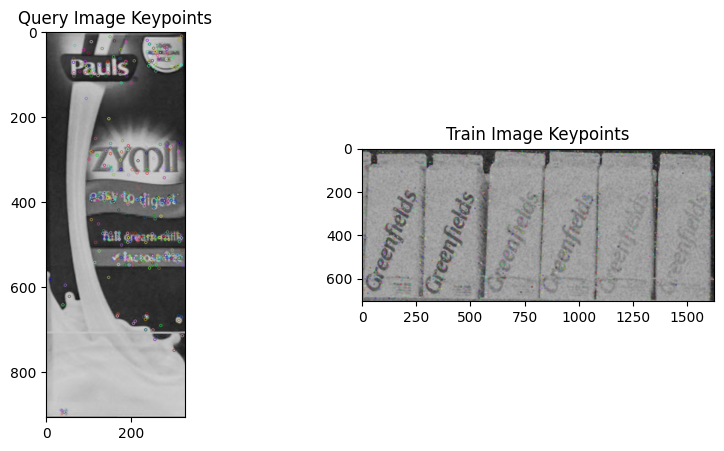

Keypoint coordinates for clustering: [[   7.2303896   554.9541626 ]
 [   9.06001759  651.75213623]
 [   9.48776436   60.93480301]
 ...
 [1611.14477539  596.89898682]
 [1611.43225098  375.97003174]
 [1612.28930664  117.91014099]]
Estimated bandwidth: 209.95194728777196
number of estimated clusters : 5
cluster 0
length 0
cluster 1
length 3
cluster 2
length 0
cluster 3
length 2
cluster 4
length 3
Product dataset/models/ref15.png in dataset/scenes/scene12_filtered.png:False


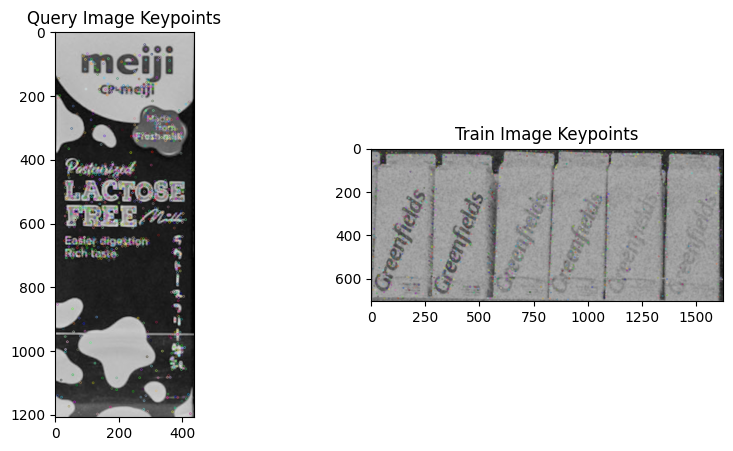

Keypoint coordinates for clustering: [[   7.2303896   554.9541626 ]
 [   9.06001759  651.75213623]
 [   9.48776436   60.93480301]
 ...
 [1611.14477539  596.89898682]
 [1611.43225098  375.97003174]
 [1612.28930664  117.91014099]]
Estimated bandwidth: 209.95194728777196
number of estimated clusters : 5
cluster 0
length 11
cluster 1
length 19
cluster 2
length 1
cluster 3
length 12
cluster 4
length 14
Product dataset/models/ref16.png in dataset/scenes/scene12_filtered.png:False


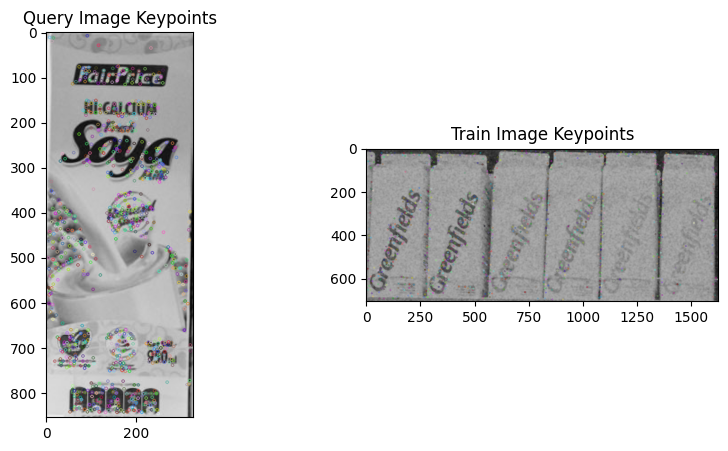

Keypoint coordinates for clustering: [[   7.2303896   554.9541626 ]
 [   9.06001759  651.75213623]
 [   9.48776436   60.93480301]
 ...
 [1611.14477539  596.89898682]
 [1611.43225098  375.97003174]
 [1612.28930664  117.91014099]]
Estimated bandwidth: 209.95194728777196
number of estimated clusters : 5
cluster 0
length 4
cluster 1
length 9
cluster 2
length 0
cluster 3
length 1
cluster 4
length 14
Product dataset/models/ref17.png in dataset/scenes/scene12_filtered.png:False


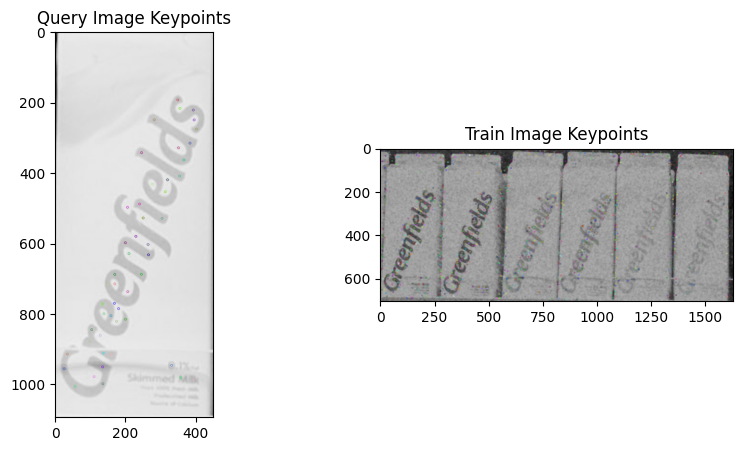

Keypoint coordinates for clustering: [[   7.2303896   554.9541626 ]
 [   9.06001759  651.75213623]
 [   9.48776436   60.93480301]
 ...
 [1611.14477539  596.89898682]
 [1611.43225098  375.97003174]
 [1612.28930664  117.91014099]]
Estimated bandwidth: 209.95194728777196
number of estimated clusters : 5
cluster 0
length 23
cluster 1
length 1
cluster 2
length 22
cluster 3
length 0
cluster 4
length 2
Product dataset/models/ref18.png in dataset/scenes/scene12_filtered.png:False


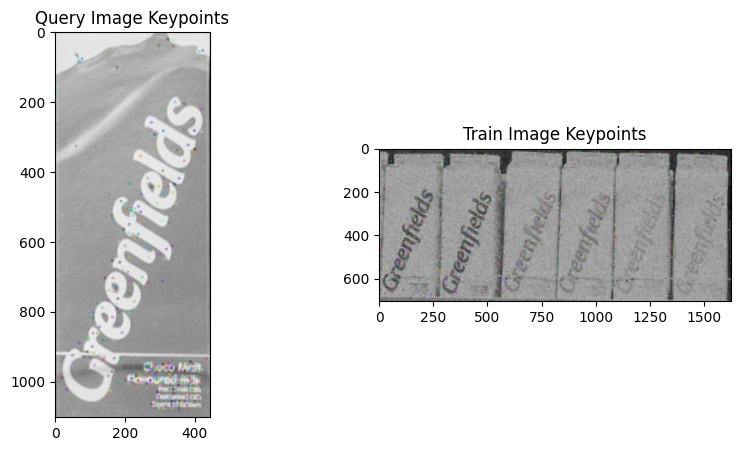

Keypoint coordinates for clustering: [[   7.2303896   554.9541626 ]
 [   9.06001759  651.75213623]
 [   9.48776436   60.93480301]
 ...
 [1611.14477539  596.89898682]
 [1611.43225098  375.97003174]
 [1612.28930664  117.91014099]]
Estimated bandwidth: 209.95194728777196
number of estimated clusters : 5
cluster 0
length 3
cluster 1
length 3
cluster 2
length 1
cluster 3
length 3
cluster 4
length 11
Product dataset/models/ref19.png in dataset/scenes/scene12_filtered.png:False


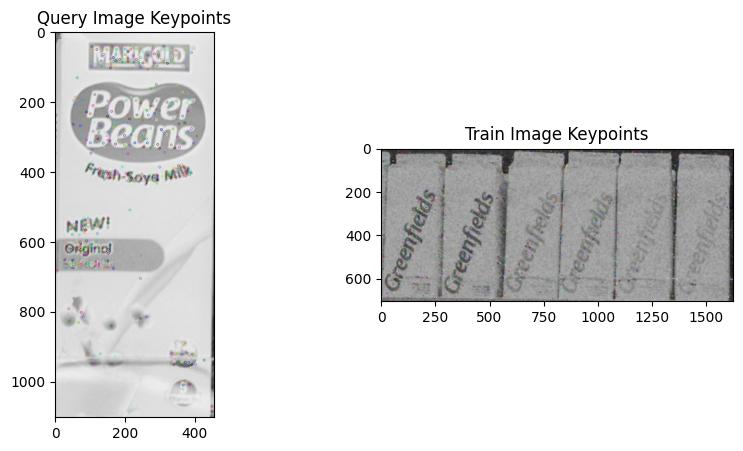

Keypoint coordinates for clustering: [[   7.2303896   554.9541626 ]
 [   9.06001759  651.75213623]
 [   9.48776436   60.93480301]
 ...
 [1611.14477539  596.89898682]
 [1611.43225098  375.97003174]
 [1612.28930664  117.91014099]]
Estimated bandwidth: 209.95194728777196
number of estimated clusters : 5
cluster 0
length 1
cluster 1
length 1
cluster 2
length 3
cluster 3
length 3
cluster 4
length 2
Product dataset/models/ref20.png in dataset/scenes/scene12_filtered.png:False


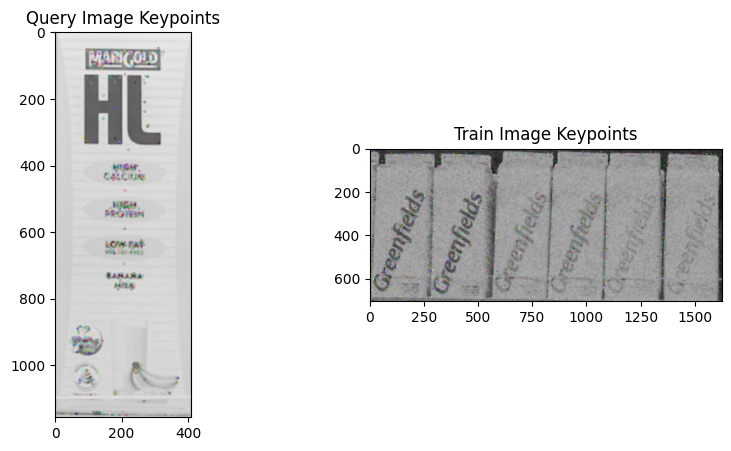

Keypoint coordinates for clustering: [[   7.2303896   554.9541626 ]
 [   9.06001759  651.75213623]
 [   9.48776436   60.93480301]
 ...
 [1611.14477539  596.89898682]
 [1611.43225098  375.97003174]
 [1612.28930664  117.91014099]]
Estimated bandwidth: 209.95194728777196
number of estimated clusters : 5
cluster 0
length 1
cluster 1
length 1
cluster 2
length 0
cluster 3
length 4
cluster 4
length 2
Product dataset/models/ref21.png in dataset/scenes/scene12_filtered.png:False


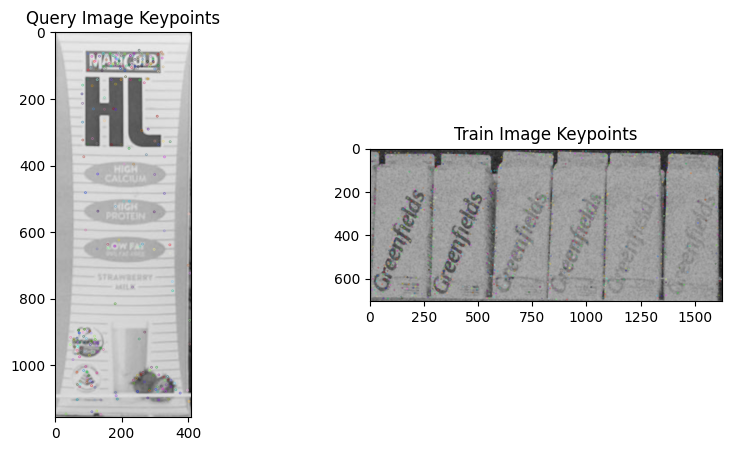

Keypoint coordinates for clustering: [[   7.2303896   554.9541626 ]
 [   9.06001759  651.75213623]
 [   9.48776436   60.93480301]
 ...
 [1611.14477539  596.89898682]
 [1611.43225098  375.97003174]
 [1612.28930664  117.91014099]]
Estimated bandwidth: 209.95194728777196
number of estimated clusters : 5
cluster 0
length 0
cluster 1
length 1
cluster 2
length 2
cluster 3
length 1
cluster 4
length 1
Product dataset/models/ref22.png in dataset/scenes/scene12_filtered.png:False


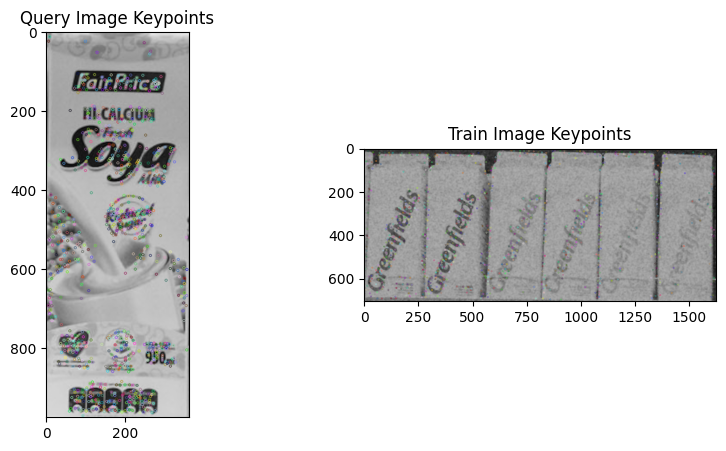

Keypoint coordinates for clustering: [[   7.2303896   554.9541626 ]
 [   9.06001759  651.75213623]
 [   9.48776436   60.93480301]
 ...
 [1611.14477539  596.89898682]
 [1611.43225098  375.97003174]
 [1612.28930664  117.91014099]]
Estimated bandwidth: 209.95194728777196
number of estimated clusters : 5
cluster 0
length 4
cluster 1
length 9
cluster 2
length 1
cluster 3
length 3
cluster 4
length 7
Product dataset/models/ref23.png in dataset/scenes/scene12_filtered.png:False


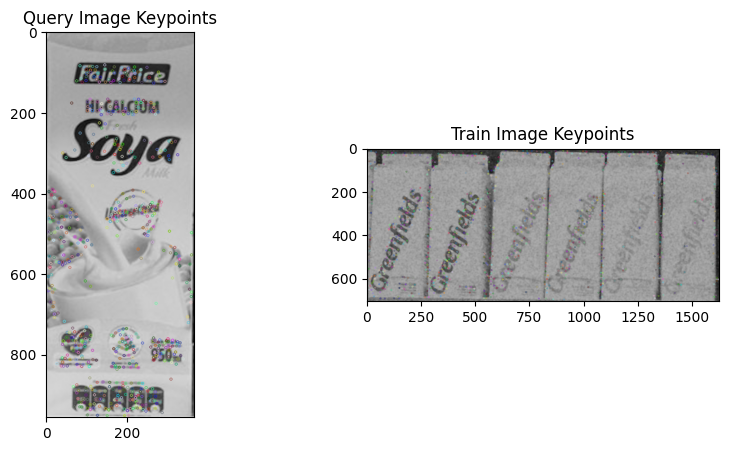

Keypoint coordinates for clustering: [[   7.2303896   554.9541626 ]
 [   9.06001759  651.75213623]
 [   9.48776436   60.93480301]
 ...
 [1611.14477539  596.89898682]
 [1611.43225098  375.97003174]
 [1612.28930664  117.91014099]]
Estimated bandwidth: 209.95194728777196
number of estimated clusters : 5
cluster 0
length 2
cluster 1
length 3
cluster 2
length 2
cluster 3
length 2
cluster 4
length 2
Product dataset/models/ref24.png in dataset/scenes/scene12_filtered.png:False


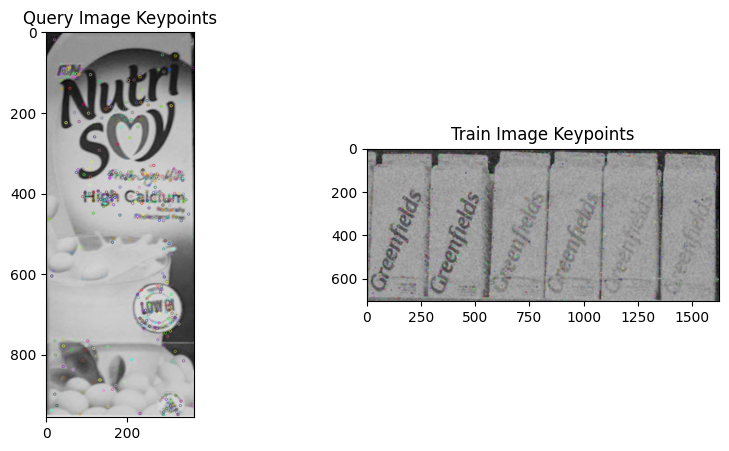

Keypoint coordinates for clustering: [[   7.2303896   554.9541626 ]
 [   9.06001759  651.75213623]
 [   9.48776436   60.93480301]
 ...
 [1611.14477539  596.89898682]
 [1611.43225098  375.97003174]
 [1612.28930664  117.91014099]]
Estimated bandwidth: 209.95194728777196
number of estimated clusters : 5
cluster 0
length 4
cluster 1
length 5
cluster 2
length 3
cluster 3
length 3
cluster 4
length 5
Product dataset/models/ref25.png in dataset/scenes/scene12_filtered.png:False


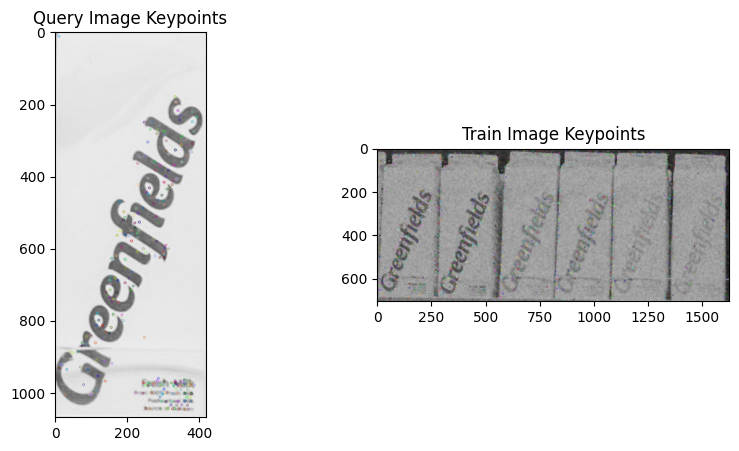

Keypoint coordinates for clustering: [[   7.2303896   554.9541626 ]
 [   9.06001759  651.75213623]
 [   9.48776436   60.93480301]
 ...
 [1611.14477539  596.89898682]
 [1611.43225098  375.97003174]
 [1612.28930664  117.91014099]]
Estimated bandwidth: 209.95194728777196
number of estimated clusters : 5
cluster 0
length 43
cluster 1
length 4
cluster 2
length 19
cluster 3
length 0
cluster 4
length 5
Product dataset/models/ref26.png in dataset/scenes/scene12_filtered.png:True


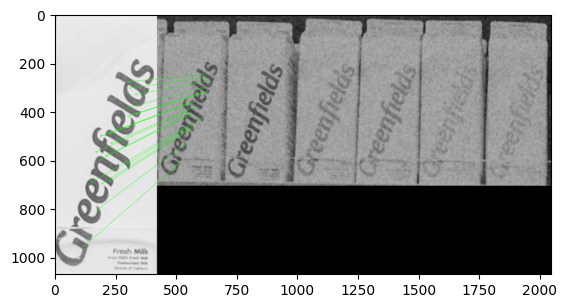

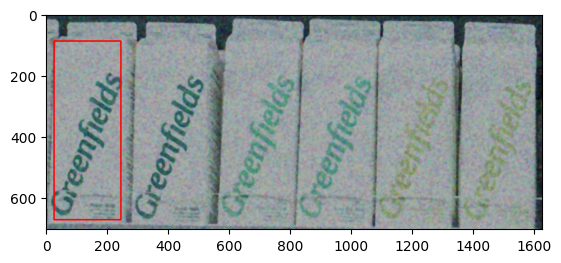

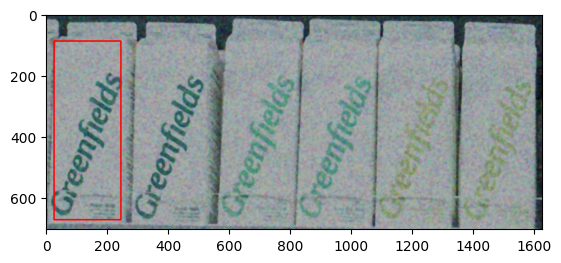

Object 26: 1 instance found, Height=584.4400024414062, Width=218.32000732421875, Center=(135.93409729003906, 380.9027099609375)


In [9]:
contain_img = {}
# Iterate among scenes
imgs_train_filterd = ['dataset/scenes/scene{}_filtered.png'.format(i) for i in range(7, 13)]
for scene_image in imgs_train_filterd:
  # Count instances of each object
  object_counts = {}
  # Initialize variables to store accumulated bounding box information
  all_bounding_boxes = []
  all_center_positions = []
  img_train = cv2.imread(scene_image,0)
  img = cv2.imread(scene_image)
  print(img_train)
  #Iterate among queryimage to see if in scene
  for i in range(15, 27):
      img_query = cv2.imread('dataset/models/ref{}.png'.format(i),0)

      found, kp_query, kp_train = object_retrieve_mult(img_query, img_train, 23)
      print("Product {} in {}:{}".format('dataset/models/ref{}.png'.format(i),scene_image,found != []))

      if found != []:
        for element in found:
          img_train_with_box, bounding_box_height, bounding_box_width, center_position = poistion_estimation(element, kp_query, img_query, img_train)
          all_bounding_boxes.append((bounding_box_height, bounding_box_width,i))
          all_center_positions.append(center_position)

          img_with_boxes = img.copy()

          cv2.rectangle(img_with_boxes, (int(center_position[0] - bounding_box_width / 2),
                                           int(center_position[1] - bounding_box_height / 2)),
                          (int(center_position[0] + bounding_box_width / 2),
                           int(center_position[1] + bounding_box_height / 2)), (0, 0, 255), 3)
          # Count instances of each object

          plt.imshow(cv2.cvtColor(img_with_boxes, cv2.COLOR_BGR2RGB))
          plt.show()
          object_counts.setdefault(len(all_bounding_boxes), 0)
          object_counts[len(all_bounding_boxes)] += 1
    # Draw all bounding boxes on a single image
  if img_train_with_box is not None:
      img_with_boxes = img.copy()
      for i, ((bounding_box_height, bounding_box_width, number), center_position) in enumerate(zip(all_bounding_boxes, all_center_positions), 1):
          cv2.rectangle(img_with_boxes, (int(center_position[0] - bounding_box_width / 2),
                                           int(center_position[1] - bounding_box_height / 2)),
                          (int(center_position[0] + bounding_box_width / 2),
                           int(center_position[1] + bounding_box_height / 2)), (0, 0, 255), 3)
          text = f'Object {i}: Height={round(bounding_box_height, 2)}, Width={round(bounding_box_width, 2)}, Center={center_position}'

      plt.imshow(cv2.cvtColor(img_with_boxes, cv2.COLOR_BGR2RGB))
      plt.show()
      for k, ((bounding_box_height, bounding_box_width, number), center_position) in enumerate(zip(all_bounding_boxes, all_center_positions), 1):
        count_text = f"{object_counts[k]} instance{'s' if object_counts[k] > 1 else ''} found"
        print(f'Object {number}: {count_text}, Height={round(bounding_box_height, 2)}, Width={round(bounding_box_width, 2)}, Center={center_position}')
